# Exploratory Data Analysis

Partie EDA EXPLORATION des données , format image , analyse des pixels image , processus prétraitement et visualisation  , distribution données ....


# Modifications apportées au dataset dès l'acquisition

Conversion des données brutes: Les données Sentinel-1 originales sont en format SLC (Single Look Complex) et ont été converties en GRD (Ground Range Detected)

Calibration radiométrique: Conversion des nombres numériques (DN) en coefficients de rétrodiffusion (sigma0)

Correction géométrique: Orthorectification et géoréférencement

Extraction des polarisations: Séparation des canaux VH et VV en fichiers distincts

Découpage/mosaïquage: Extraction des zones d'intérêt pour l'étude d'inondation

   ---------------------------------------- 0.0/3.8 MB ? eta -:--:--
   --------------------- ------------------ 2.1/3.8 MB 9.8 MB/s eta 0:00:01
   ---------------------------------------- 3.8/3.8 MB 9.9 MB/s eta 0:00:00



[notice] A new release of pip is available: 24.3.1 -> 25.0.1
[notice] To update, run: python.exe -m pip install --upgrade pip


'FireFlood_AI_Presentation.pptx'

In [66]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import rasterio


sys.path.append(os.path.abspath(os.path.join(os.getcwd(), '..'))) #TODO ajouter methode setup_path pour plus plus de propreté dans le code 
from src.utils.visualization import visualize_ndfi
from src.data.dataloader import SARDataset

# Set visualization style
sns.set(style='whitegrid')

In [67]:
import importlib
import src.data.preprocessing
importlib.reload(src.data.preprocessing)
from src.data.preprocessing import visualize_log_transform_effect , compare_advanced_preprocessing_methods , analyser_pixels_sar


Fichier CSV chargé avec succès: 3331 lignes
Préparation des chemins d'images...


100%|██████████| 3331/3331 [00:00<00:00, 7649.53it/s]


Dataset préparé avec 3331 échantillons valides
datasets images , 3331
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0026\S1A_IW_GRDH_1SDV_20181219T162032_20181219T162057_025096_02C527_E0BD_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0026\S1A_IW_GRDH_1SDV_20181219T162032_20181219T162057_025096_02C527_E0BD_corrected_VV.tif
Taille originale VH: 516×513 pixels


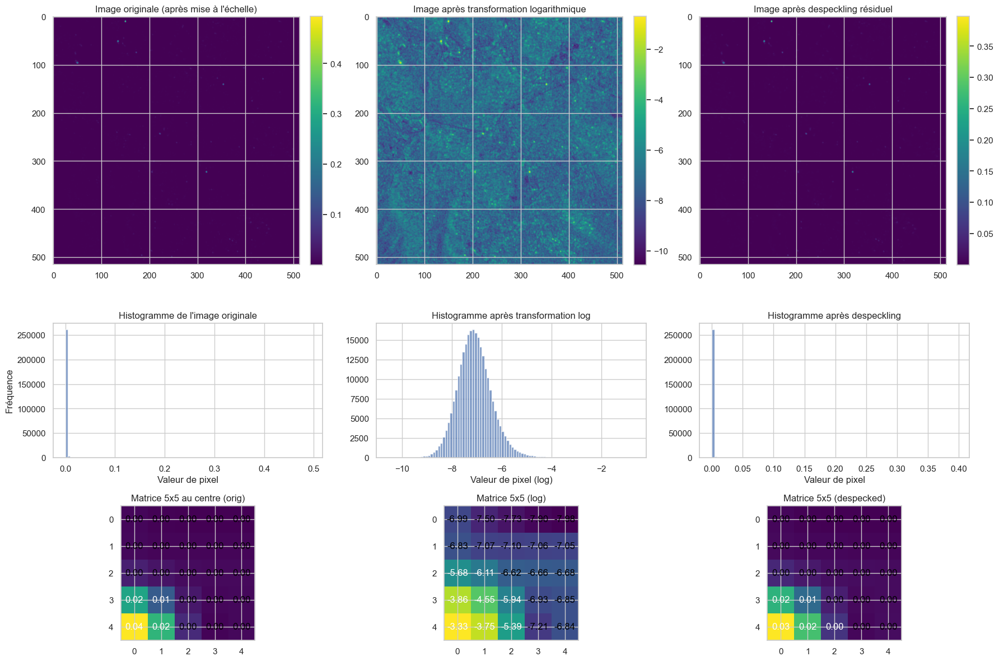


Analyse de l'effet de la transformation logarithmique:
Rapport moyen entre pixels adjacents (original): 1.45
Différence moyenne entre pixels adjacents (log): 0.33
Max rapport (original): 42.22
Max différence (log): 3.74


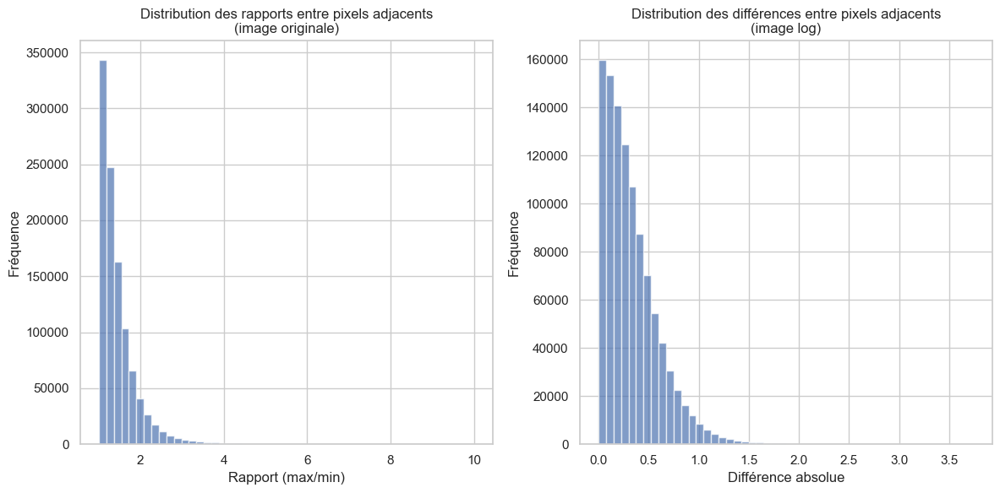

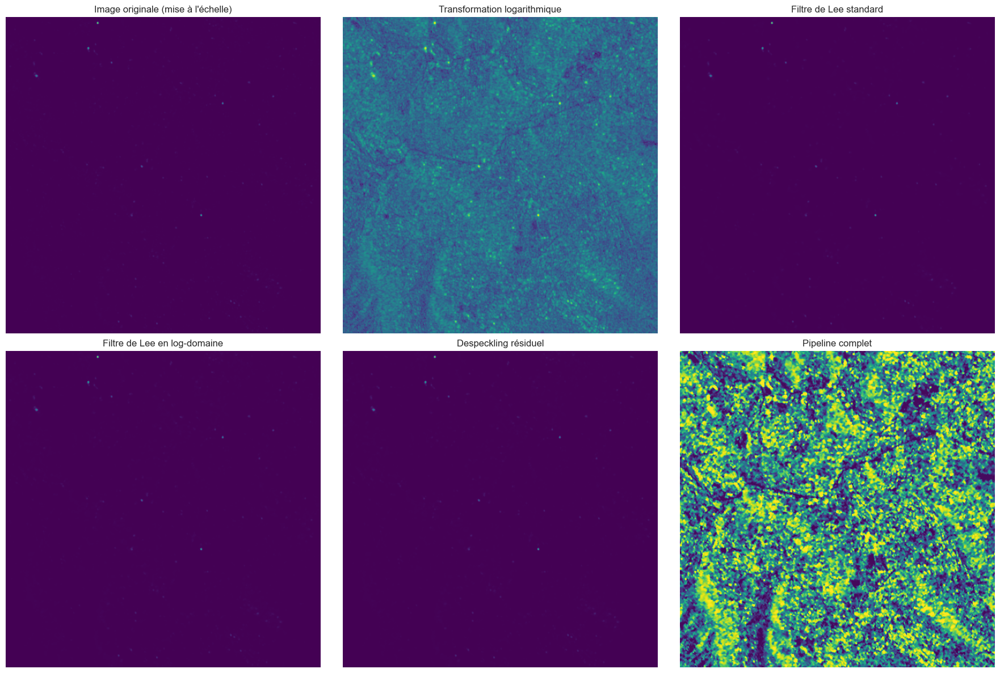


Analyse quantitative des méthodes de prétraitement:

Original:
  Min: 0.0000
  Max: 0.4935
  Mean: 0.0012
  Std: 0.0032
  Dynamic range: 0.4935

Log transform:
  Min: -10.5432
  Max: -0.7063
  Mean: -7.0891
  Std: 0.7083
  Dynamic range: 9.8369

Lee filter:
  Min: 0.0001
  Max: 0.4933
  Mean: 0.0012
  Std: 0.0031
  Dynamic range: 0.4932

Log-Lee filter:
  Min: 0.0000
  Max: 0.3904
  Mean: 0.0011
  Std: 0.0026
  Dynamic range: 0.3903

Residual despeckling:
  Min: 0.0000
  Max: 0.3974
  Mean: 0.0011
  Std: 0.0026
  Dynamic range: 0.3973

Full pipeline:
  Min: 0.0000
  Max: 1.0000
  Mean: 0.4999
  Std: 0.2851
  Dynamic range: 1.0000
Taille originale VV: 516×513 pixels


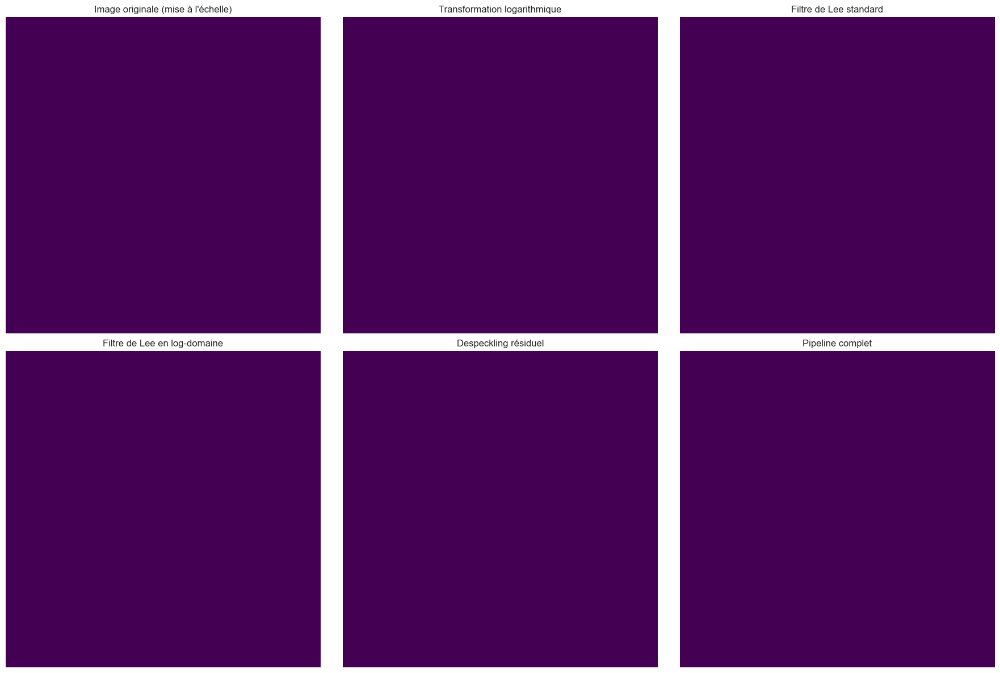


Analyse quantitative des méthodes de prétraitement:

Original:
  Min: 0.0000
  Max: 0.0000
  Mean: 0.0000
  Std: 0.0000
  Dynamic range: 0.0000

Log transform:
  Min: -23.0259
  Max: -23.0259
  Mean: -23.0259
  Std: 0.0000
  Dynamic range: 0.0000

Lee filter:
  Min: 0.0000
  Max: 0.0000
  Mean: 0.0000
  Std: 0.0000
  Dynamic range: 0.0000

Log-Lee filter:
  Min: 0.0000
  Max: 0.0000
  Mean: 0.0000
  Std: 0.0000
  Dynamic range: 0.0000

Residual despeckling:
  Min: 0.0000
  Max: 0.0000
  Mean: 0.0000
  Std: 0.0000
  Dynamic range: 0.0000

Full pipeline:
  Min: 1.0000
  Max: 1.0000
  Mean: 1.0000
  Std: 0.0000
  Dynamic range: 0.0000


In [ ]:

def obtenir_taille_originale(chemin_image):
    
    """Affiche la taille originale d'une image raster
    Remarque : 
    Eau: typiquement 0.0001 à 0.0005
    Sol nu: 0.001 à 0.01
    Végétation: 0.01 à 0.1
    Bâtiments/structures: >0.1
    
    TODO : 
    à vérifier les différentes valeurs que j'ai trouvées ici .... dans la doc officielle 
    """
    with rasterio.open(chemin_image) as src:
        height = src.height
        width = src.width
        return height, width

# Exemple d'utilisation
dataset = SARDataset(base_dir="C:/Users/mokht/Desktop/PDS/flood_dataset")
if len(dataset.image_paths) > 0:
    print(f"datasets images , {len(dataset.image_paths)}")
    vh_path, vv_path = dataset.image_paths[1]
    print("VH path:", vh_path)
    print("VV path:", vv_path)
    # Taille du canal VH
    height_vh, width_vh = obtenir_taille_originale(vh_path)
    print(f"Taille originale VH: {height_vh}×{width_vh} pixels")
    visualize_log_transform_effect(vh_path, scaling_value=50.0)  # 50.0 pour VH, 100.0 pour VV
    # Comparer plusieurs méthodes de prétraitement avancées
    compare_advanced_preprocessing_methods(vh_path, scaling_value=50.0)  
    
    # Taille du canal VV
    height_vv, width_vv = obtenir_taille_originale(vv_path)
    print(f"Taille originale VV: {height_vv}×{width_vv} pixels")
    compare_advanced_preprocessing_methods(vv_path, scaling_value=50.0)  


datasets images , 3331
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0165\S1A_IW_GRDH_1SDV_20190206T030815_20190206T030840_025803_02DEB0_ED53_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0165\S1A_IW_GRDH_1SDV_20190206T030815_20190206T030840_025803_02DEB0_ED53_corrected_VV.tif
Taille originale VH: 525×549 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 525×549 pixels
Valeur minimale: 0.00001962
Valeur maximale: 0.00489718
Valeur moyenne: 0.00052885
Écart-type: 0.00031322


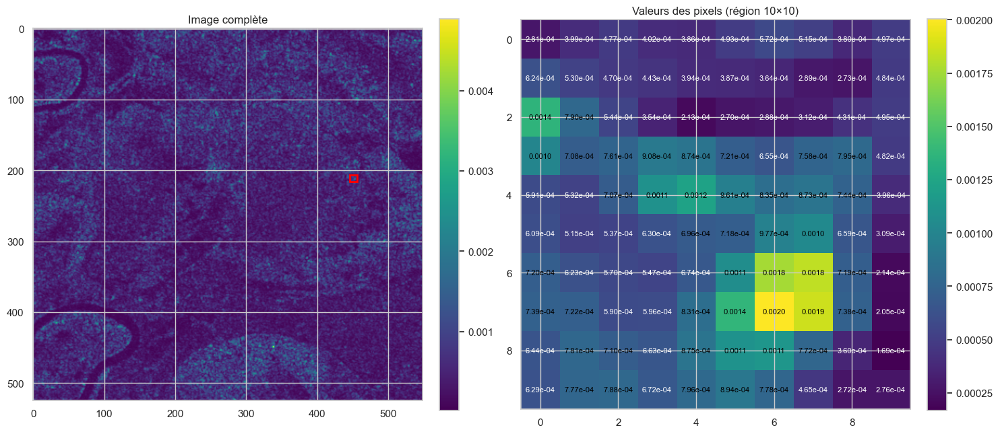

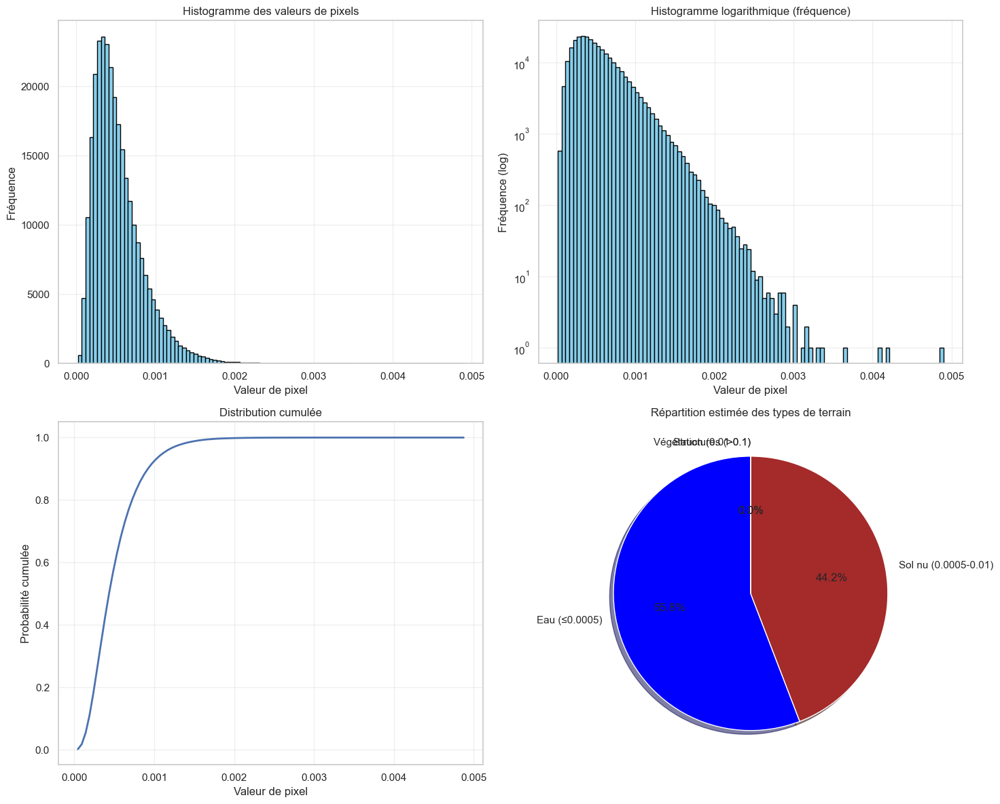


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 55.83% des pixels
  Moyenne: 0.00031632
  Écart-type: 0.00010745
Sol nu (0.0005-0.01): 44.17% des pixels
  Moyenne: 0.00079749
  Écart-type: 0.00027974
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 525×549 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 525×549 pixels
Valeur minimale: 0.00001936
Valeur maximale: 0.02001632
Valeur moyenne: 0.00104337
Écart-type: 0.00072654


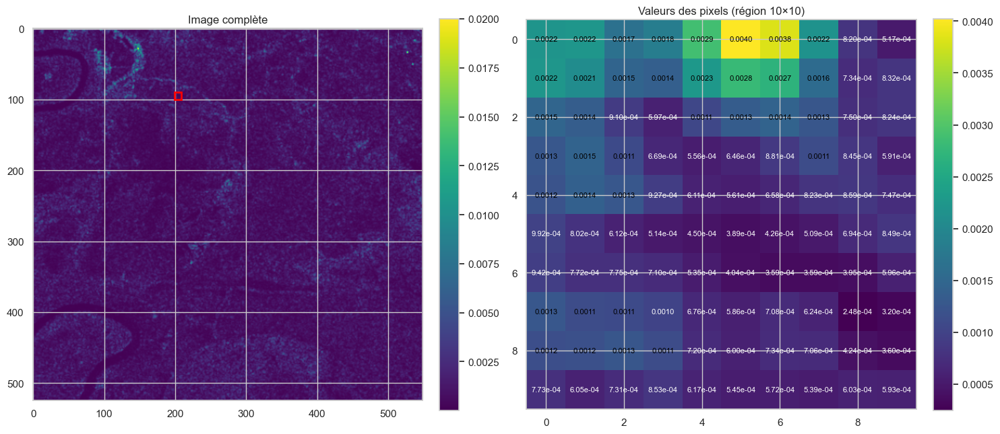

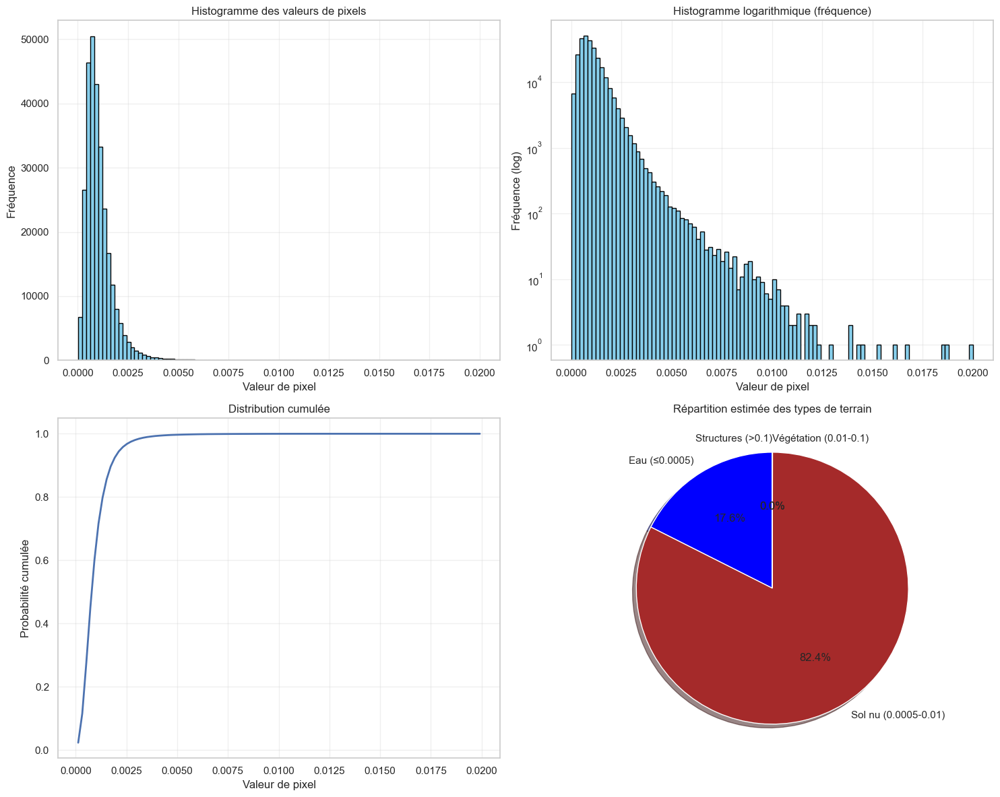


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 17.57% des pixels
  Moyenne: 0.00035398
  Écart-type: 0.00010706
Sol nu (0.0005-0.01): 82.41% des pixels
  Moyenne: 0.00118803
  Écart-type: 0.00069945
Végétation (0.01-0.1): 0.02% des pixels
  Moyenne: 0.01190526
  Écart-type: 0.00241062
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0026\S1A_IW_GRDH_1SDV_20181219T162032_20181219T162057_025096_02C527_E0BD_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0026\S1A_IW_GRDH_1SDV_20181219T162032_20181219T162057_025096_02C527_E0BD_corrected_VV.tif
Taille originale VH: 516×513 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×513 pixels
Valeur minimale: 0.00002637
Valeur maximale: 0.49347821
Valeur moyenne: 0.00116057
Écart-type: 0.00317451


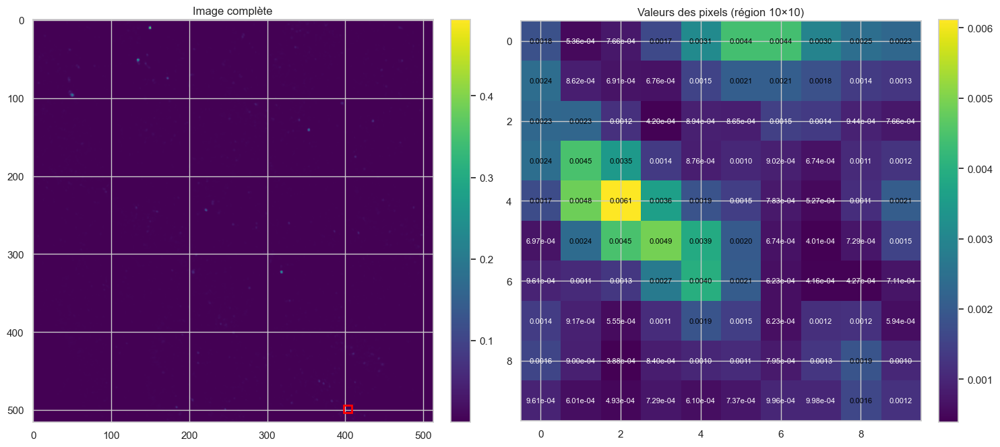

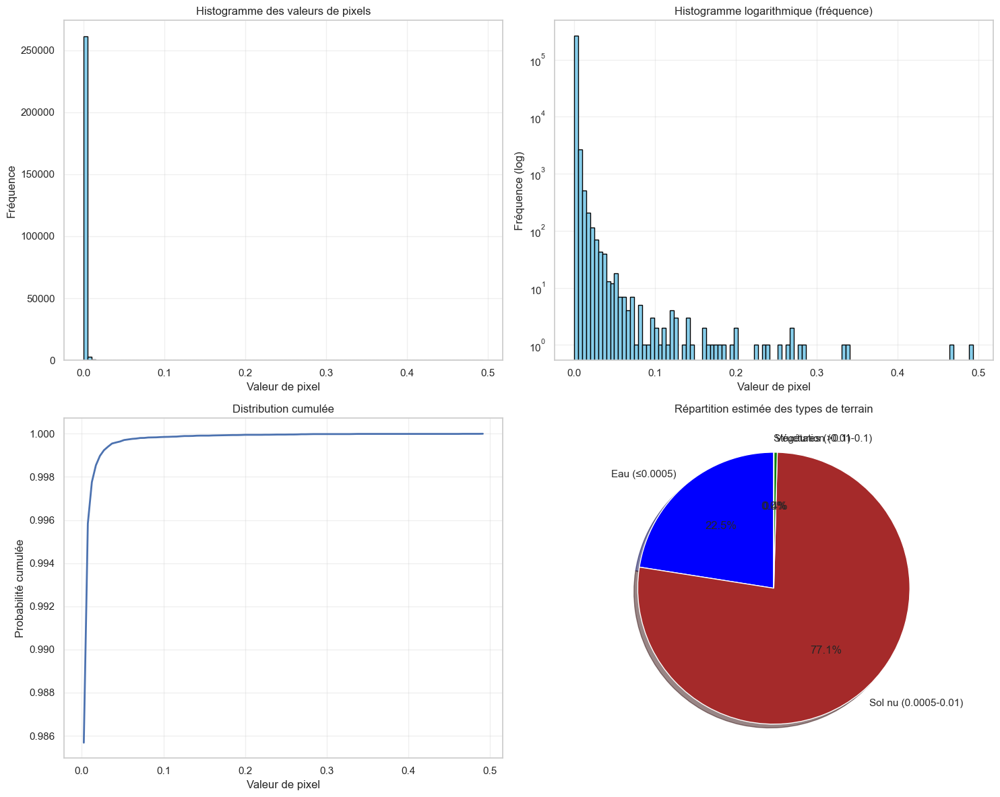


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 22.52% des pixels
  Moyenne: 0.00036145
  Écart-type: 0.00009489
Sol nu (0.0005-0.01): 77.07% des pixels
  Moyenne: 0.00125686
  Écart-type: 0.00095723
Végétation (0.01-0.1): 0.39% des pixels
  Moyenne: 0.02037181
  Écart-type: 0.01342848
Structures (>0.1): 0.02% des pixels
  Moyenne: 0.19403914
  Écart-type: 0.09116676
Taille originale VV: 516×513 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×513 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


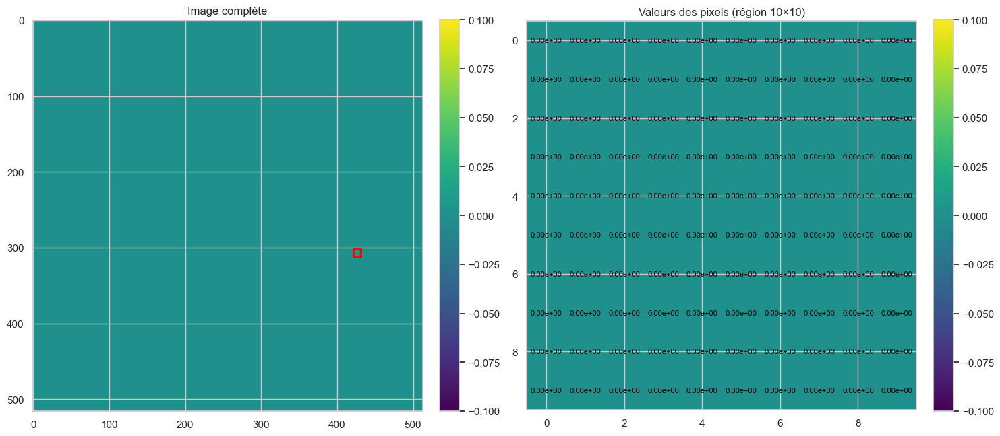

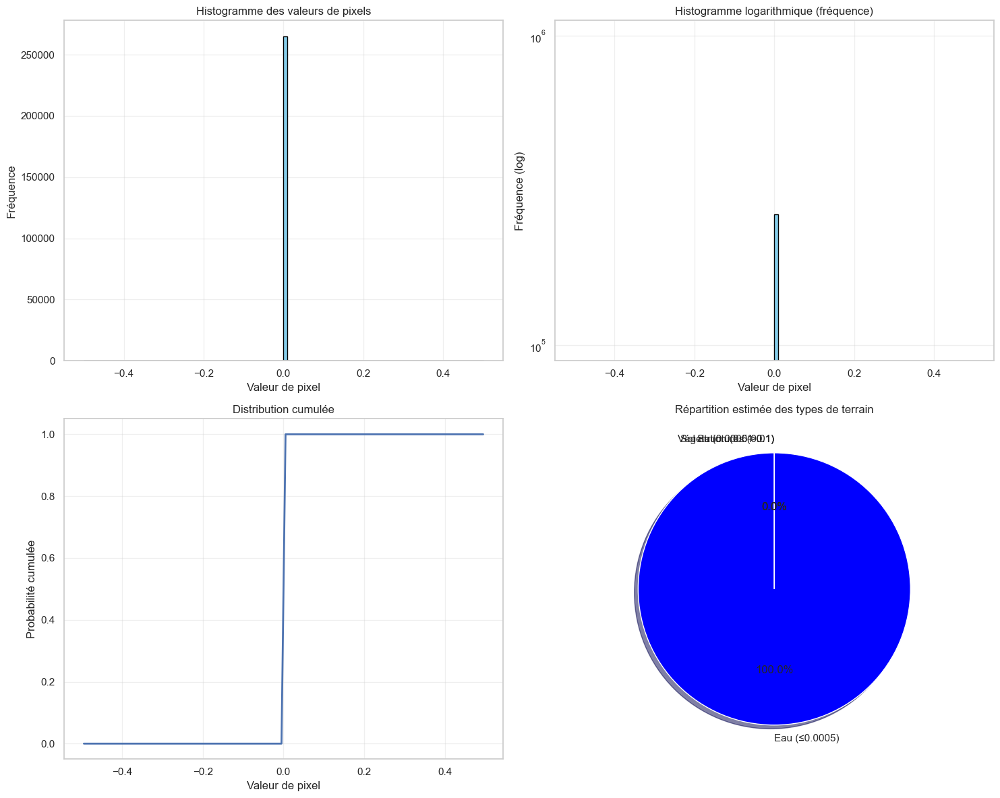


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00000000
  Écart-type: 0.00000000
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0100\S1A_IW_GRDH_1SDV_20181217T181826_20181217T181851_025069_02C42B_6B4A_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0100\S1A_IW_GRDH_1SDV_20181217T181826_20181217T181851_025069_02C42B_6B4A_corrected_VV.tif
Taille originale VH: 517×518 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×518 pixels
Valeur minimale: 0.00004227
Valeur maximale: 0.45548686
Valeur moyenne: 0.00102899
Écart-type: 0.00323758


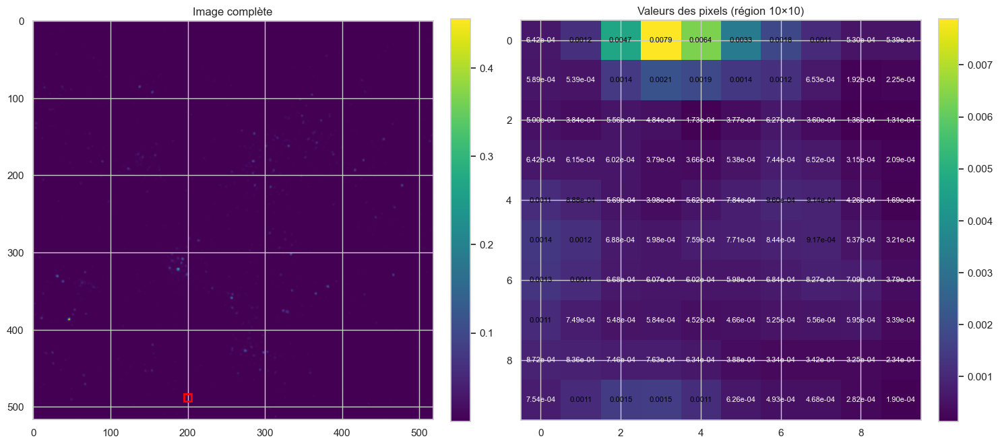

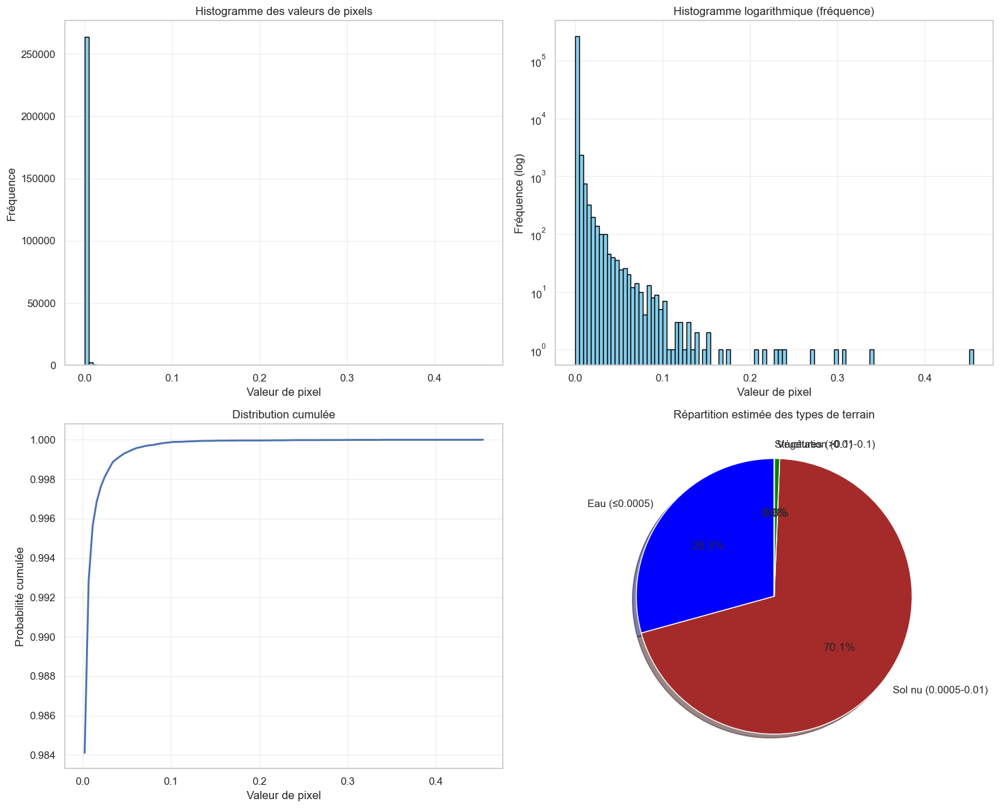


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 29.30% des pixels
  Moyenne: 0.00036523
  Écart-type: 0.00009122
Sol nu (0.0005-0.01): 70.06% des pixels
  Moyenne: 0.00106761
  Écart-type: 0.00086829
Végétation (0.01-0.1): 0.63% des pixels
  Moyenne: 0.02406075
  Écart-type: 0.01689131
Structures (>0.1): 0.01% des pixels
  Moyenne: 0.16494861
  Écart-type: 0.07978138
Taille originale VV: 517×518 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×518 pixels
Valeur minimale: 0.00007886
Valeur maximale: 8.88920593
Valeur moyenne: 0.00478544
Écart-type: 0.04645503


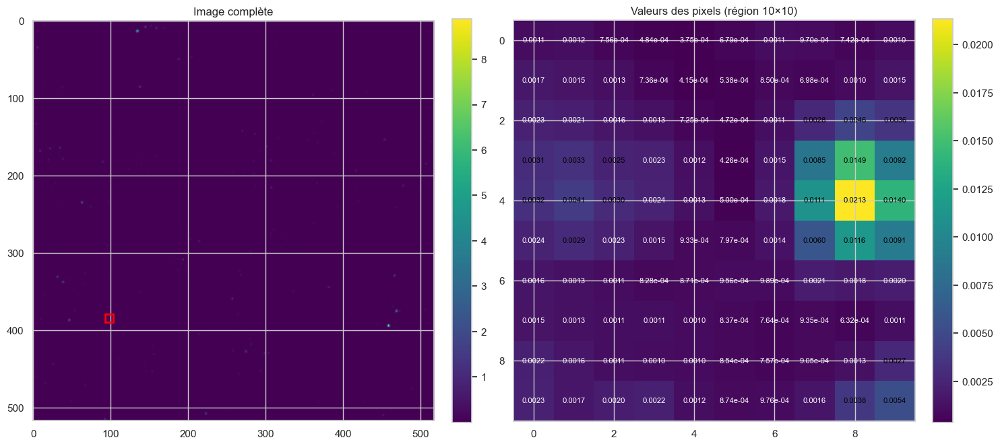

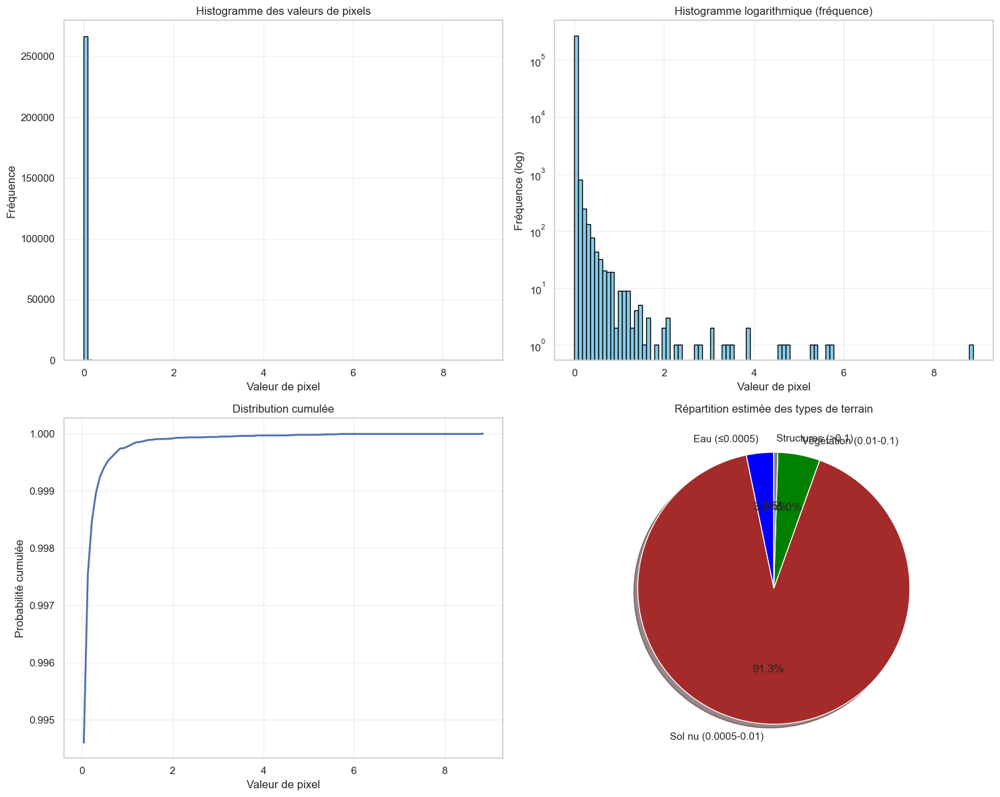


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 3.26% des pixels
  Moyenne: 0.00039656
  Écart-type: 0.00007890
Sol nu (0.0005-0.01): 91.27% des pixels
  Moyenne: 0.00210321
  Écart-type: 0.00163990
Végétation (0.01-0.1): 5.00% des pixels
  Moyenne: 0.02461161
  Écart-type: 0.01801669
Structures (>0.1): 0.47% des pixels
  Moyenne: 0.34165499
  Écart-type: 0.57558107
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0305\S1A_IW_GRDH_1SDV_20190211T194432_20190211T194457_025886_02E1B7_4856_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0305\S1A_IW_GRDH_1SDV_20190211T194432_20190211T194457_025886_02E1B7_4856_corrected_VV.tif
Taille originale VH: 516×543 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×543 pixels
Valeur minimale: 0.00000745
Valeur maximale: 0.03854637
Valeur moyenne: 0.00038035
Écart-type: 0.00046321


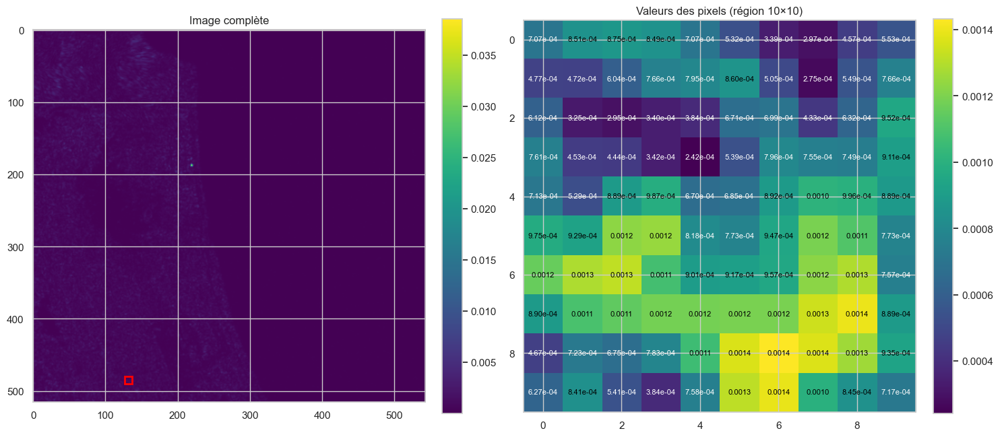

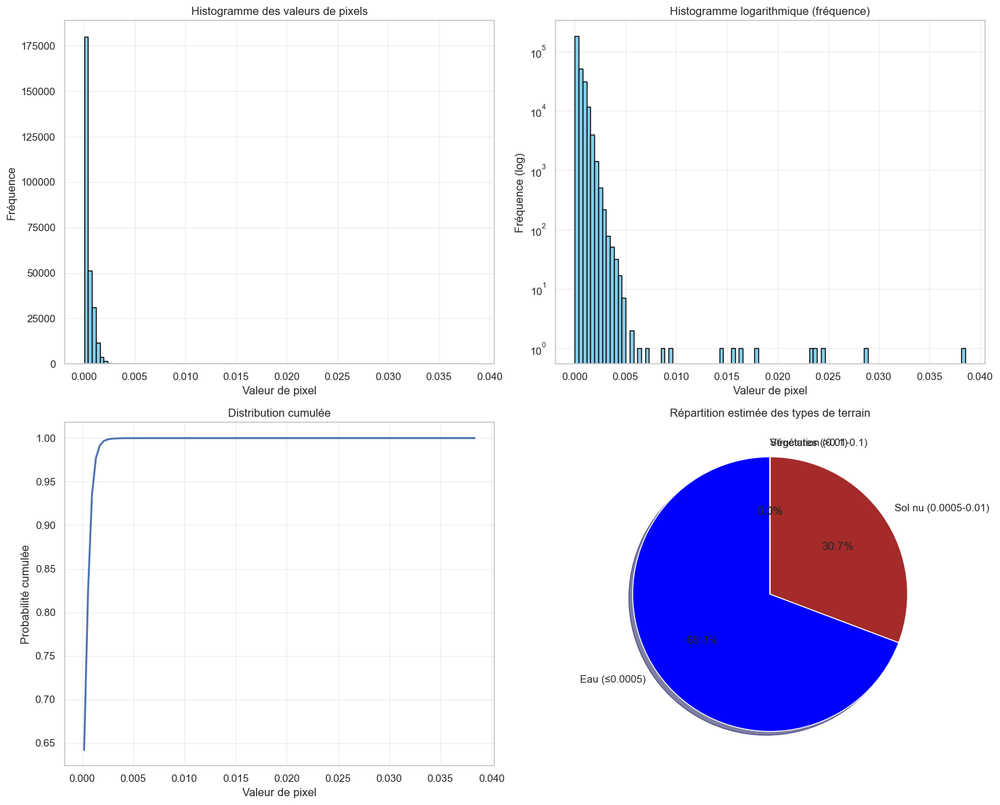


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 69.25% des pixels
  Moyenne: 0.00013207
  Écart-type: 0.00011628
Sol nu (0.0005-0.01): 30.75% des pixels
  Moyenne: 0.00093726
  Écart-type: 0.00040180
Végétation (0.01-0.1): 0.00% des pixels
  Moyenne: 0.02258940
  Écart-type: 0.00722779
Structures (>0.1): 0.00% des pixels
Taille originale VV: 516×543 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×543 pixels
Valeur minimale: 0.00000982
Valeur maximale: 0.16949314
Valeur moyenne: 0.00065851
Écart-type: 0.00135270


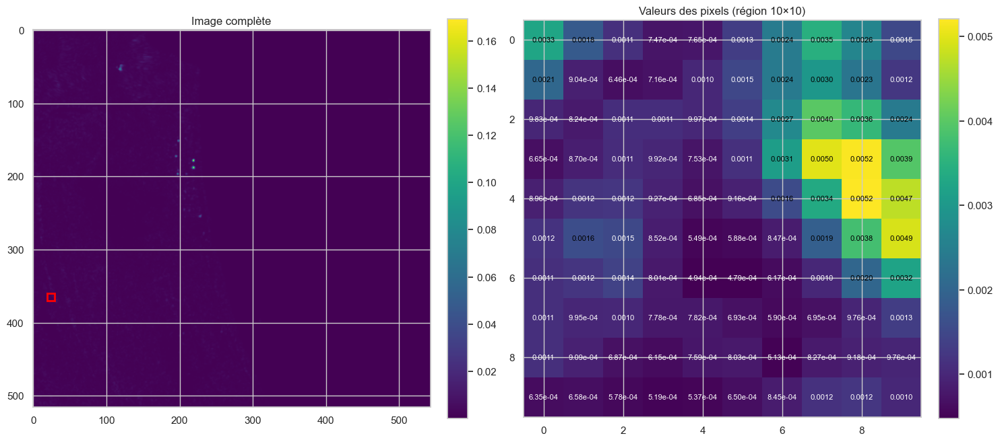

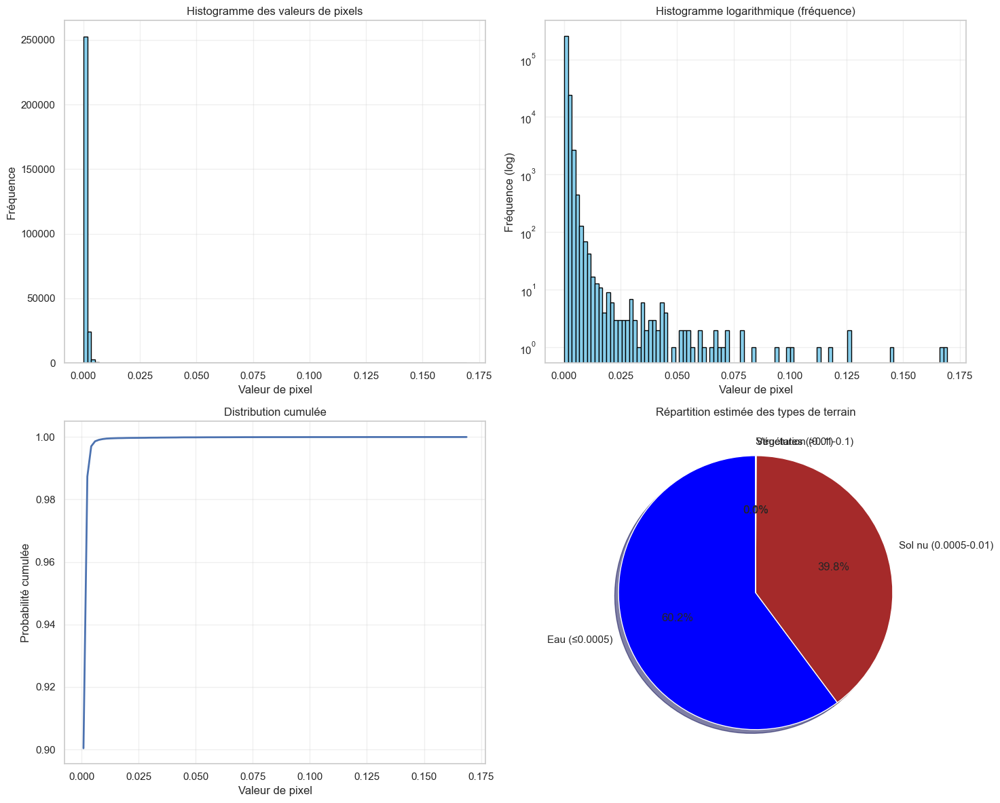


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 60.17% des pixels
  Moyenne: 0.00013013
  Écart-type: 0.00008981
Sol nu (0.0005-0.01): 39.77% des pixels
  Moyenne: 0.00140758
  Écart-type: 0.00083122
Végétation (0.01-0.1): 0.06% des pixels
  Moyenne: 0.02597405
  Écart-type: 0.01897177
Structures (>0.1): 0.00% des pixels
  Moyenne: 0.13304159
  Écart-type: 0.02349831
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0246\S1A_IW_GRDH_1SDV_20190406T145101_20190406T145126_026671_02FE34_475A_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0246\S1A_IW_GRDH_1SDV_20190406T145101_20190406T145126_026671_02FE34_475A_corrected_VV.tif
Taille originale VH: 524×606 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 524×606 pixels
Valeur minimale: 0.00000461
Valeur maximale: 0.00298582
Valeur moyenne: 0.00016493
Écart-type: 0.00014030


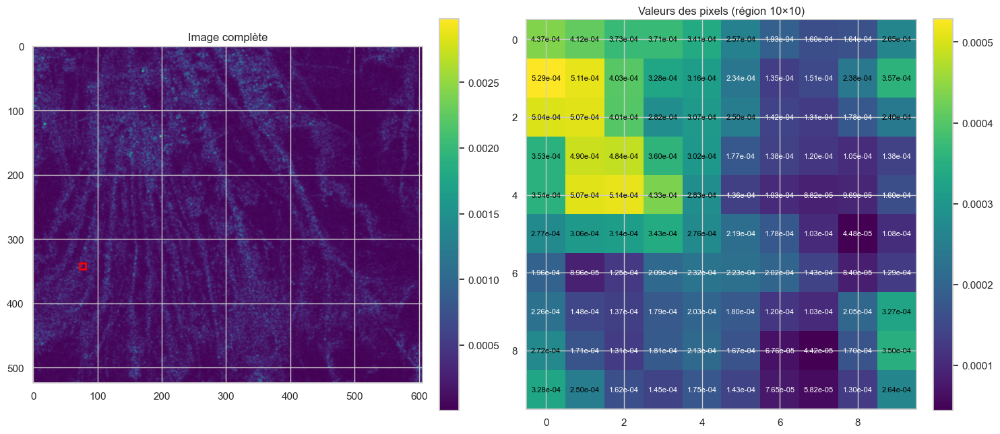

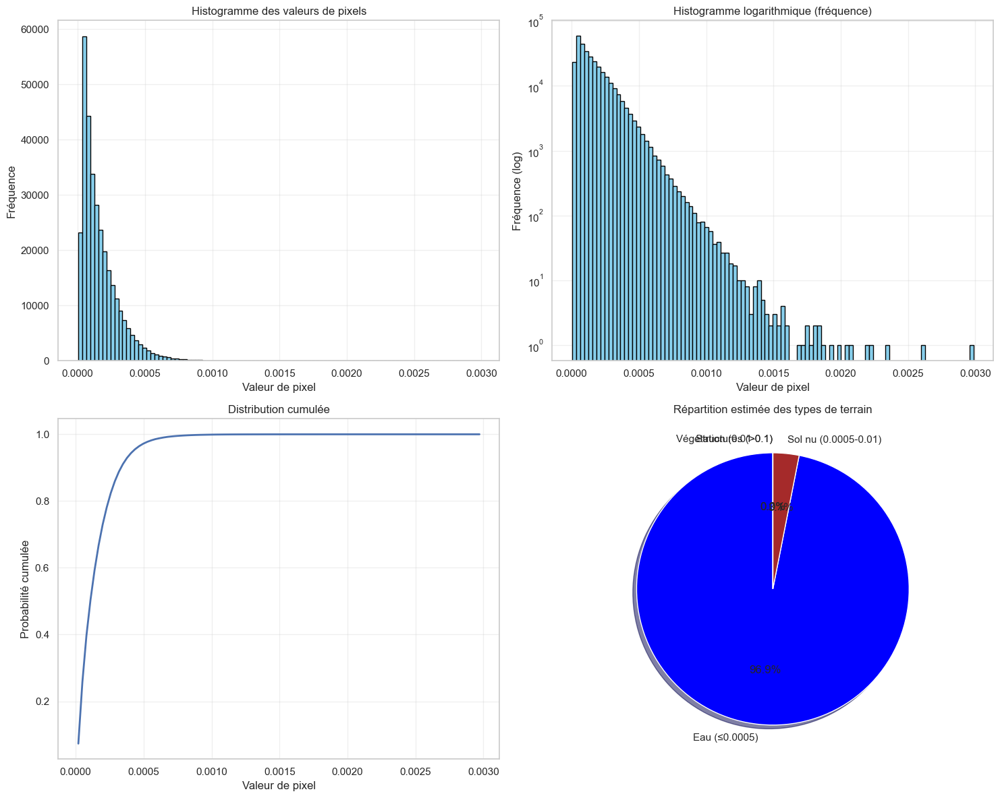


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 96.90% des pixels
  Moyenne: 0.00014967
  Écart-type: 0.00010947
Sol nu (0.0005-0.01): 3.10% des pixels
  Moyenne: 0.00064263
  Écart-type: 0.00015893
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 524×606 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 524×606 pixels
Valeur minimale: 0.00000921
Valeur maximale: 0.05137976
Valeur moyenne: 0.00047623
Écart-type: 0.00058614


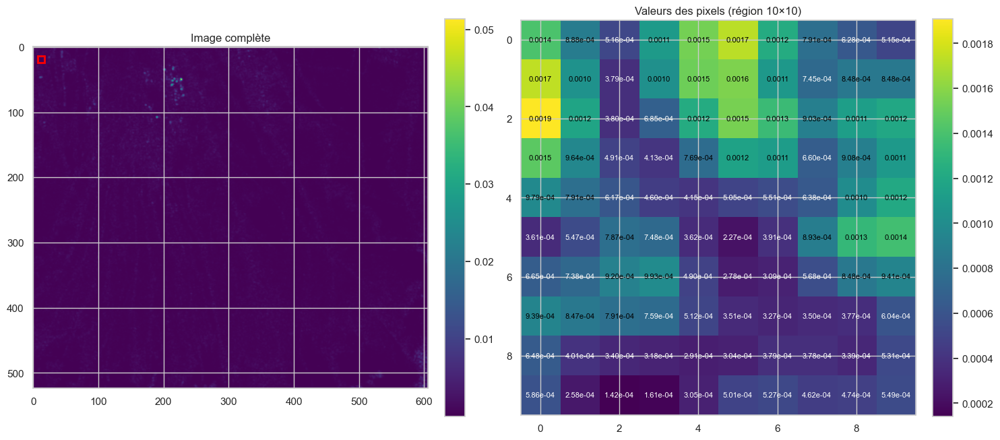

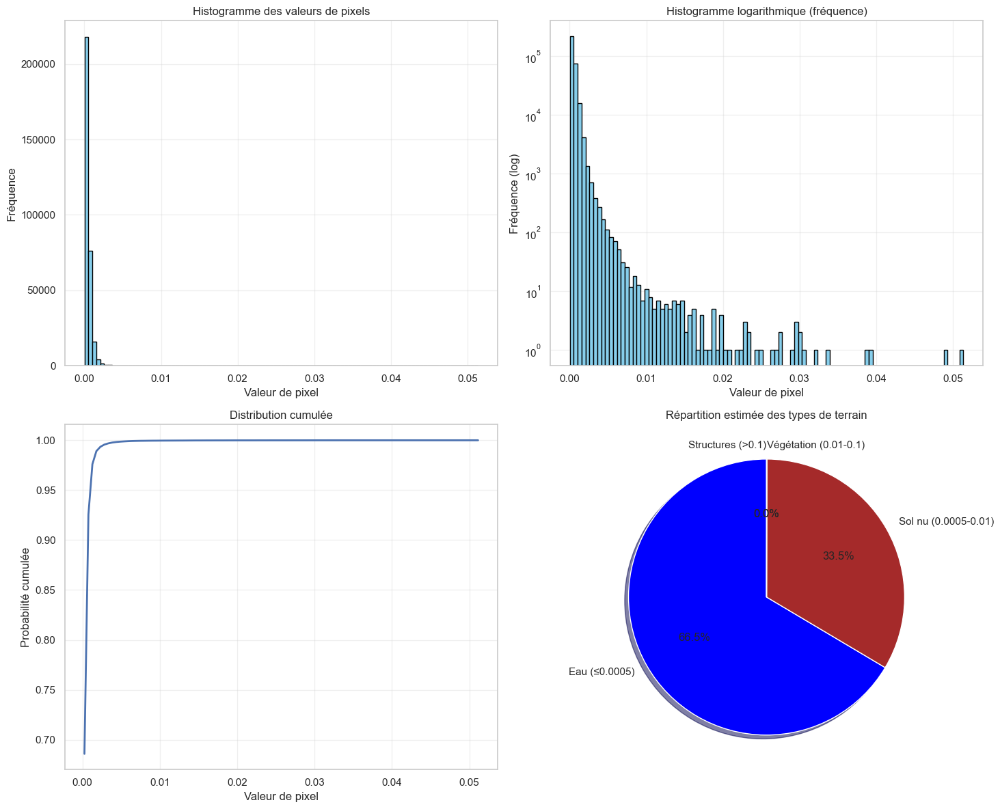


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 66.46% des pixels
  Moyenne: 0.00025309
  Écart-type: 0.00012829
Sol nu (0.0005-0.01): 33.50% des pixels
  Moyenne: 0.00090000
  Écart-type: 0.00057101
Végétation (0.01-0.1): 0.04% des pixels
  Moyenne: 0.01749506
  Écart-type: 0.00778192
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0272\S1A_IW_GRDH_1SDV_20190309T024629_20190309T024654_026255_02EEED_1759_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0272\S1A_IW_GRDH_1SDV_20190309T024629_20190309T024654_026255_02EEED_1759_corrected_VV.tif
Taille originale VH: 526×613 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 526×613 pixels
Valeur minimale: 0.00000669
Valeur maximale: 0.03914522
Valeur moyenne: 0.00024305
Écart-type: 0.00029279


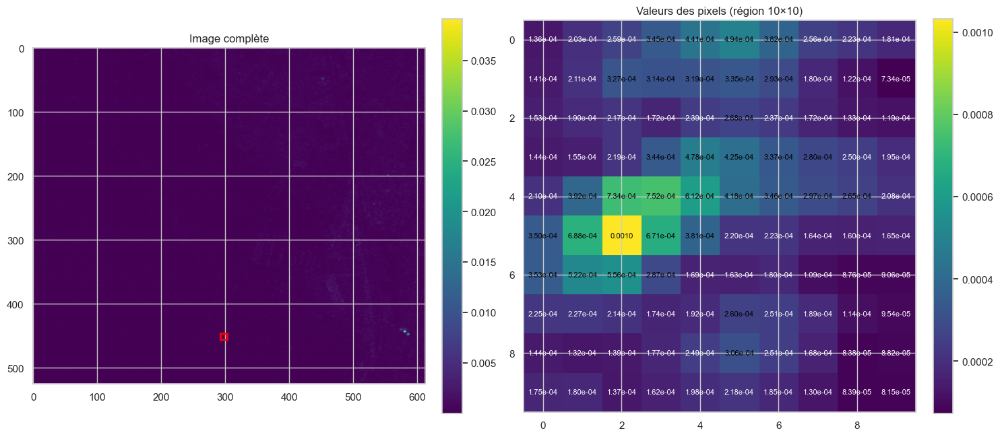

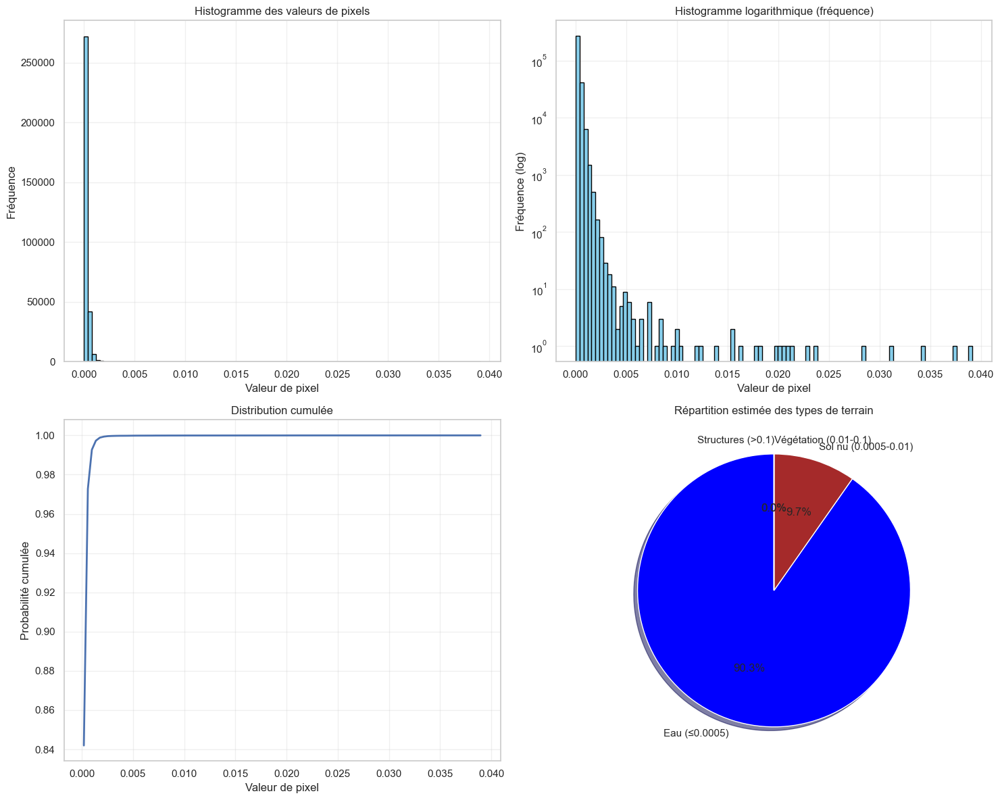


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 90.26% des pixels
  Moyenne: 0.00018630
  Écart-type: 0.00010889
Sol nu (0.0005-0.01): 9.73% des pixels
  Moyenne: 0.00075481
  Écart-type: 0.00036127
Végétation (0.01-0.1): 0.01% des pixels
  Moyenne: 0.02097902
  Écart-type: 0.00820199
Structures (>0.1): 0.00% des pixels
Taille originale VV: 526×613 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 526×613 pixels
Valeur minimale: 0.00001736
Valeur maximale: 0.34388927
Valeur moyenne: 0.00078345
Écart-type: 0.00271168


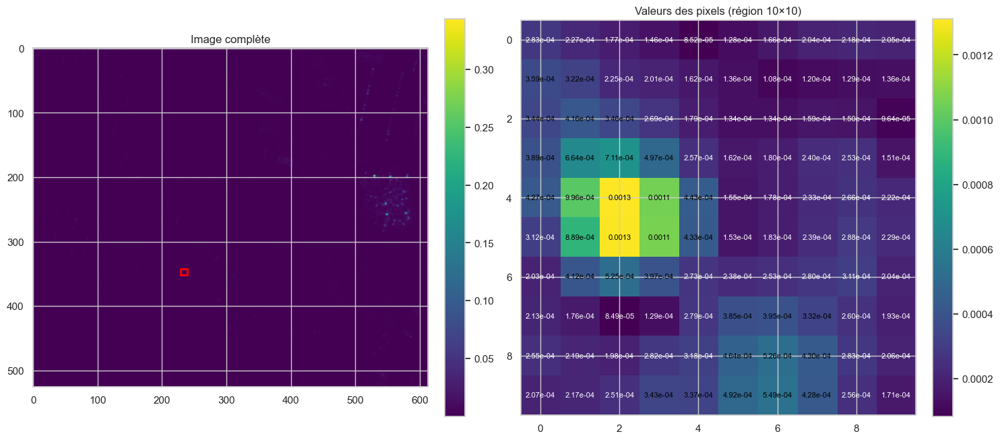

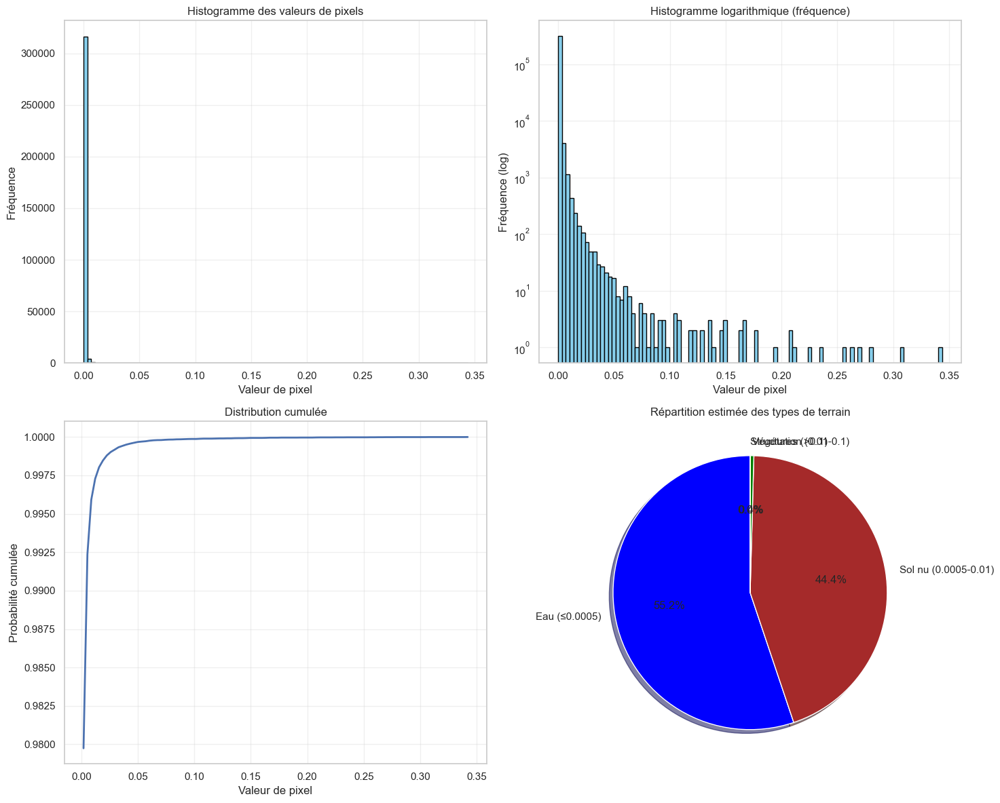


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 55.15% des pixels
  Moyenne: 0.00029623
  Écart-type: 0.00011120
Sol nu (0.0005-0.01): 44.41% des pixels
  Moyenne: 0.00114741
  Écart-type: 0.00103193
Végétation (0.01-0.1): 0.42% des pixels
  Moyenne: 0.02116086
  Écart-type: 0.01416704
Structures (>0.1): 0.01% des pixels
  Moyenne: 0.16986658
  Écart-type: 0.06027085
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0214\S1B_IW_GRDH_1SDV_20190228T162319_20190228T162344_015148_01C539_5754_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0214\S1B_IW_GRDH_1SDV_20190228T162319_20190228T162344_015148_01C539_5754_corrected_VV.tif
Taille originale VH: 516×546 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×546 pixels
Valeur minimale: 0.00002966
Valeur maximale: 0.00839319
Valeur moyenne: 0.00071737
Écart-type: 0.00045544


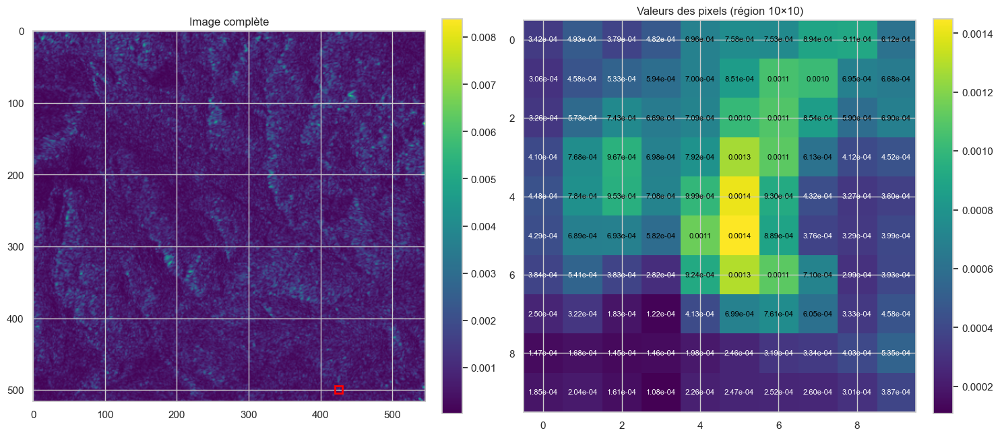

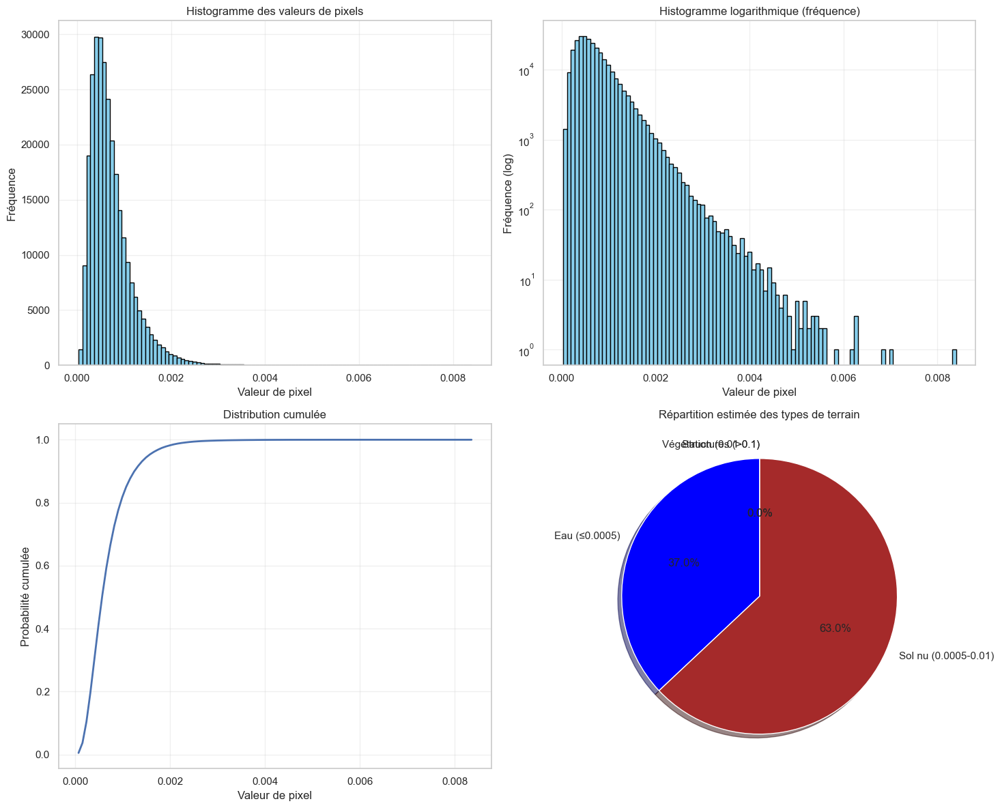


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 37.00% des pixels
  Moyenne: 0.00034229
  Écart-type: 0.00010155
Sol nu (0.0005-0.01): 63.00% des pixels
  Moyenne: 0.00093765
  Écart-type: 0.00043823
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 516×546 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×546 pixels
Valeur minimale: 0.00004803
Valeur maximale: 0.24549432
Valeur moyenne: 0.00128372
Écart-type: 0.00135927


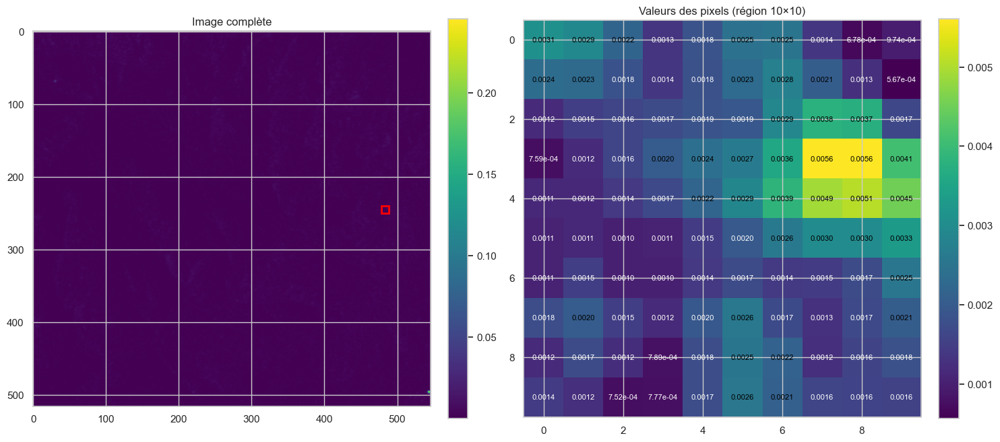

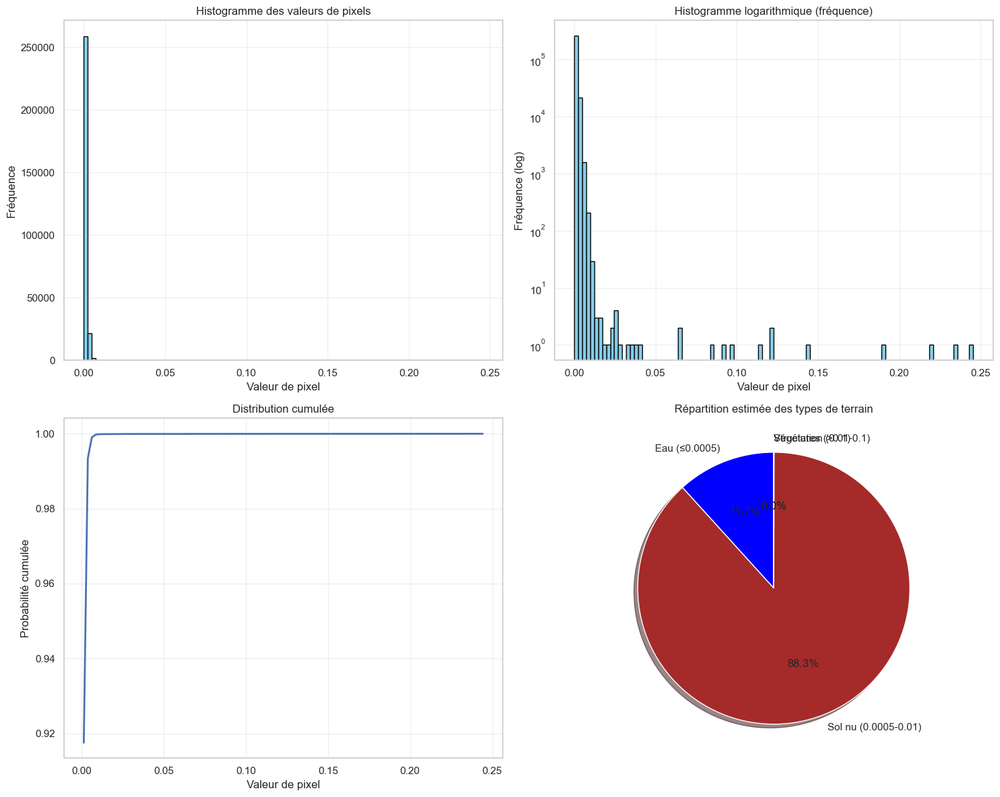


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 11.71% des pixels
  Moyenne: 0.00037573
  Écart-type: 0.00009017
Sol nu (0.0005-0.01): 88.26% des pixels
  Moyenne: 0.00139431
  Écart-type: 0.00086018
Végétation (0.01-0.1): 0.02% des pixels
  Moyenne: 0.02252865
  Écart-type: 0.02138659
Structures (>0.1): 0.00% des pixels
  Moyenne: 0.17404017
  Écart-type: 0.05114329
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0321\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0321\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VV.tif
Taille originale VH: 517×545 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×545 pixels
Valeur minimale: 0.00001044
Valeur maximale: 0.00588019
Valeur moyenne: 0.00033269
Écart-type: 0.00031762


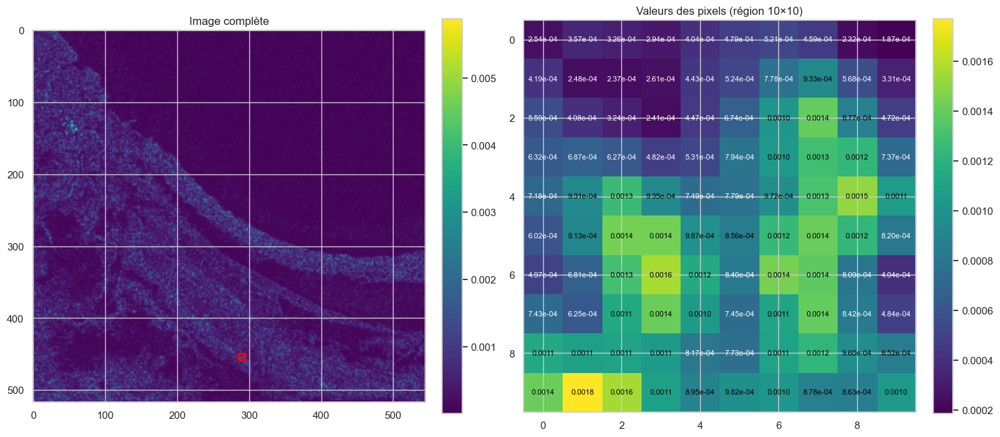

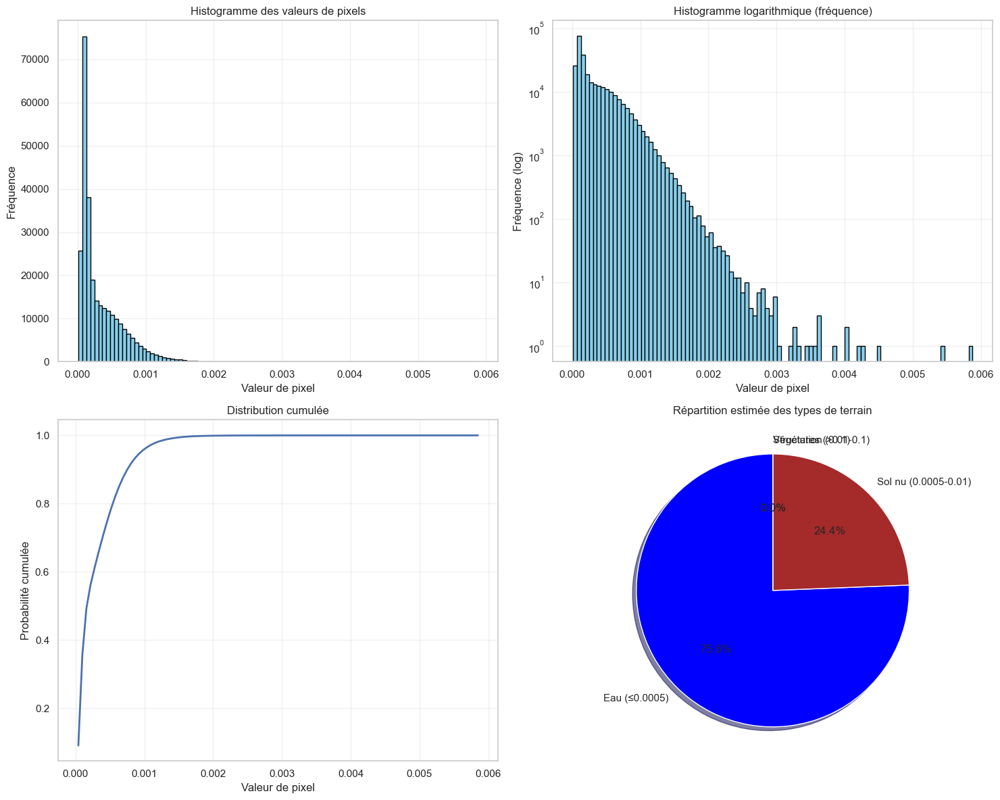


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 75.63% des pixels
  Moyenne: 0.00018212
  Écart-type: 0.00012303
Sol nu (0.0005-0.01): 24.37% des pixels
  Moyenne: 0.00079995
  Écart-type: 0.00027982
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×545 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×545 pixels
Valeur minimale: 0.00001000
Valeur maximale: 0.01661282
Valeur moyenne: 0.00064519
Écart-type: 0.00062620


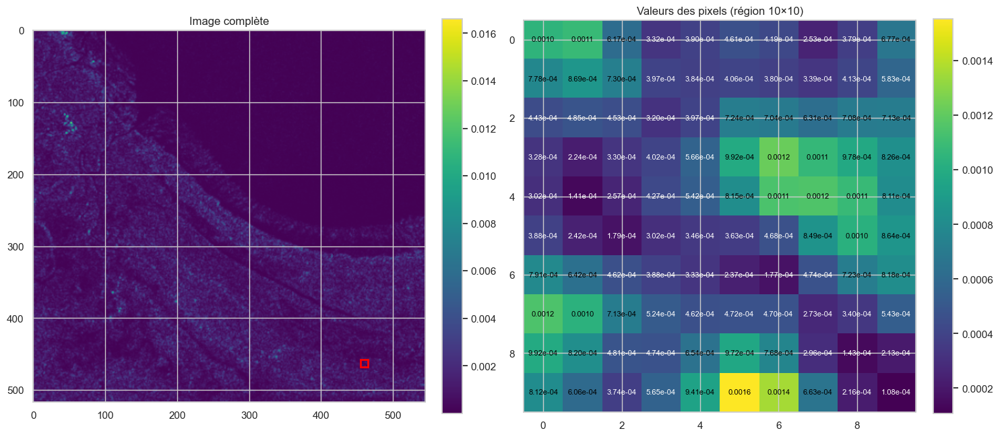

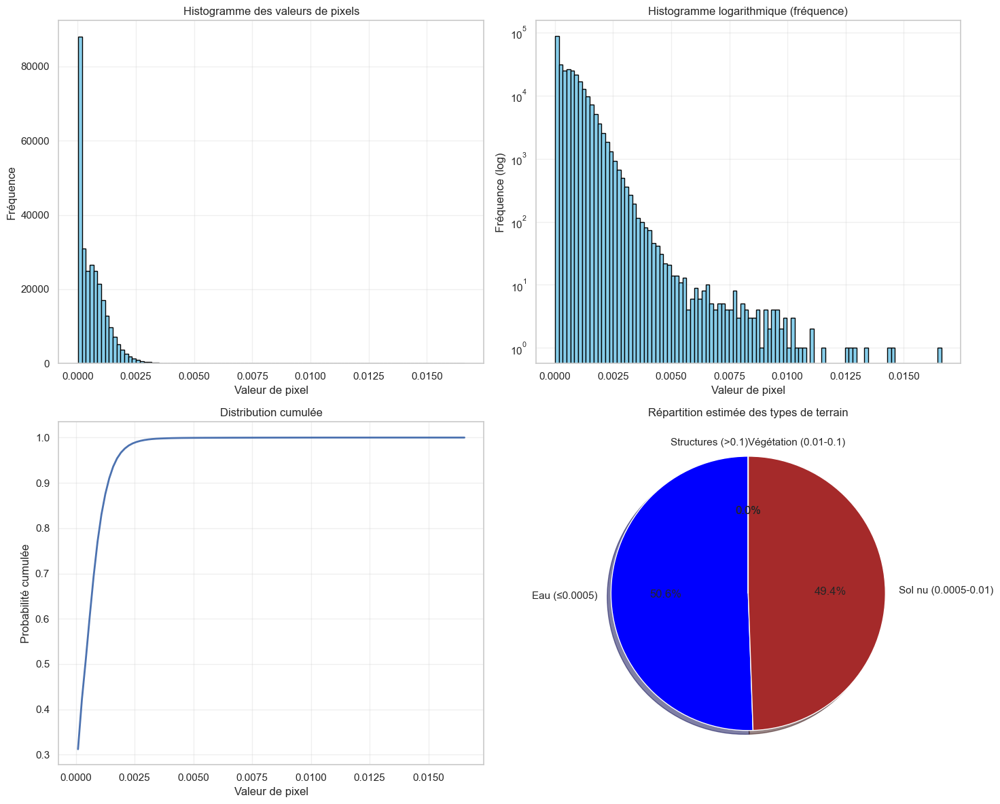


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 50.56% des pixels
  Moyenne: 0.00018694
  Écart-type: 0.00012640
Sol nu (0.0005-0.01): 49.43% des pixels
  Moyenne: 0.00111250
  Écart-type: 0.00057249
Végétation (0.01-0.1): 0.01% des pixels
  Moyenne: 0.01194048
  Écart-type: 0.00184884
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0143\S1A_IW_GRDH_1SDV_20190206T030840_20190206T030905_025803_02DEB0_5440_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0143\S1A_IW_GRDH_1SDV_20190206T030840_20190206T030905_025803_02DEB0_5440_corrected_VV.tif
Taille originale VH: 522×551 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 522×551 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00338031
Valeur moyenne: 0.00046274
Écart-type: 0.00030100


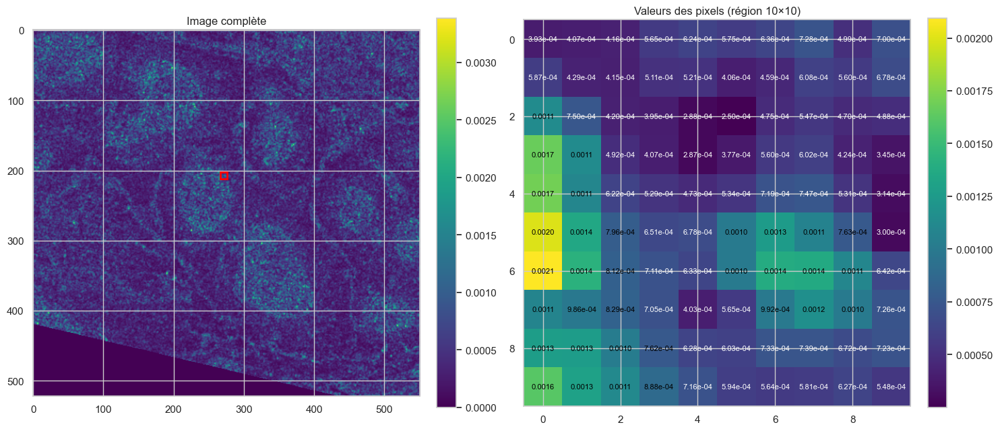

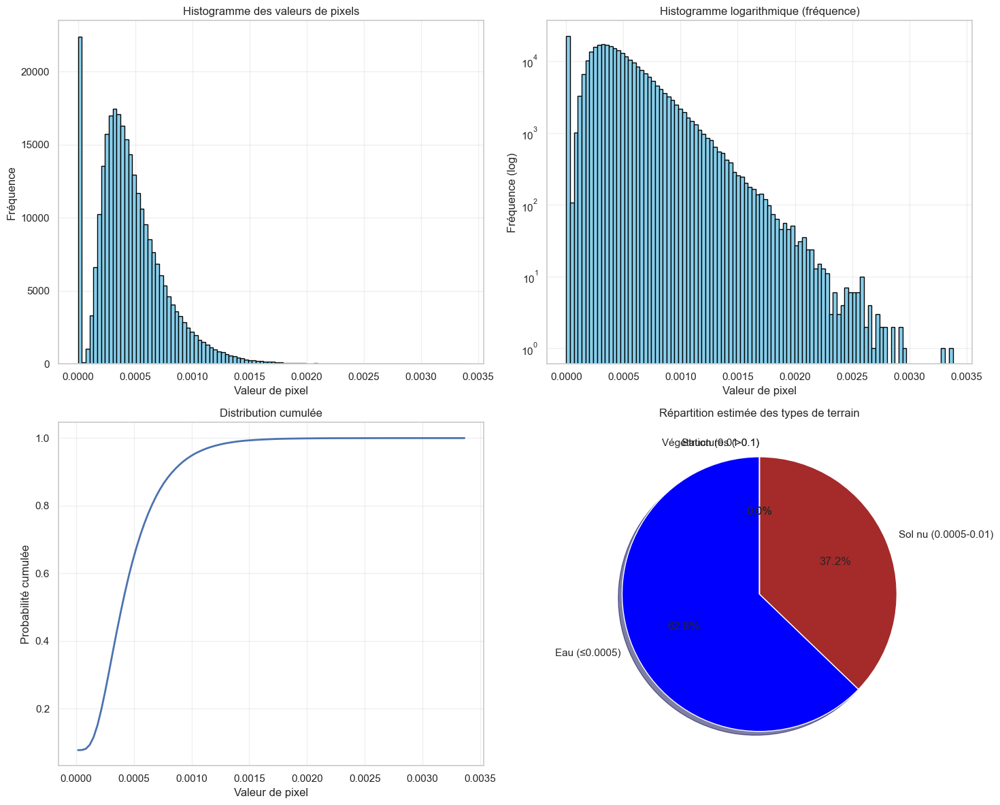


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 62.81% des pixels
  Moyenne: 0.00028394
  Écart-type: 0.00014230
Sol nu (0.0005-0.01): 37.19% des pixels
  Moyenne: 0.00076470
  Écart-type: 0.00025345
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 522×551 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 522×551 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00839660
Valeur moyenne: 0.00077747
Écart-type: 0.00052060


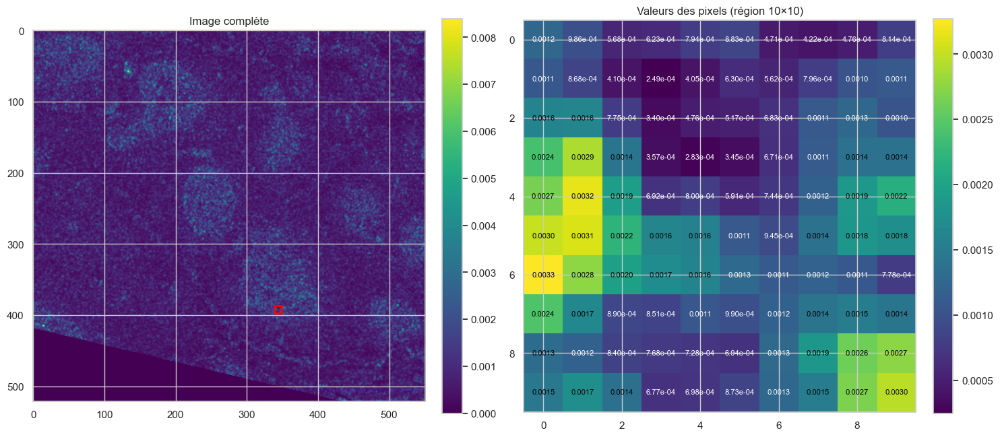

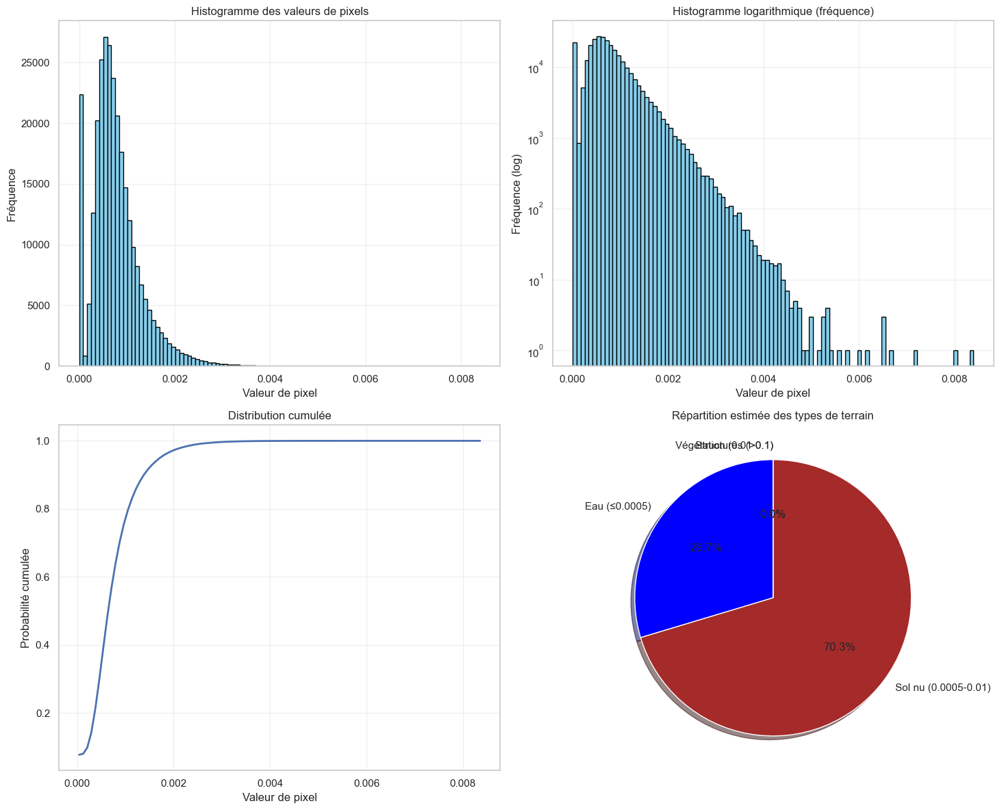


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 29.65% des pixels
  Moyenne: 0.00027894
  Écart-type: 0.00018171
Sol nu (0.0005-0.01): 70.35% des pixels
  Moyenne: 0.00098762
  Écart-type: 0.00047162
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0320\S1A_IW_GRDH_1SDV_20190223T194432_20190223T194457_026061_02E7F3_3C3A_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0320\S1A_IW_GRDH_1SDV_20190223T194432_20190223T194457_026061_02E7F3_3C3A_corrected_VV.tif
Taille originale VH: 517×543 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×543 pixels
Valeur minimale: 0.00001374
Valeur maximale: 4.07921219
Valeur moyenne: 0.00103480
Écart-type: 0.01933345


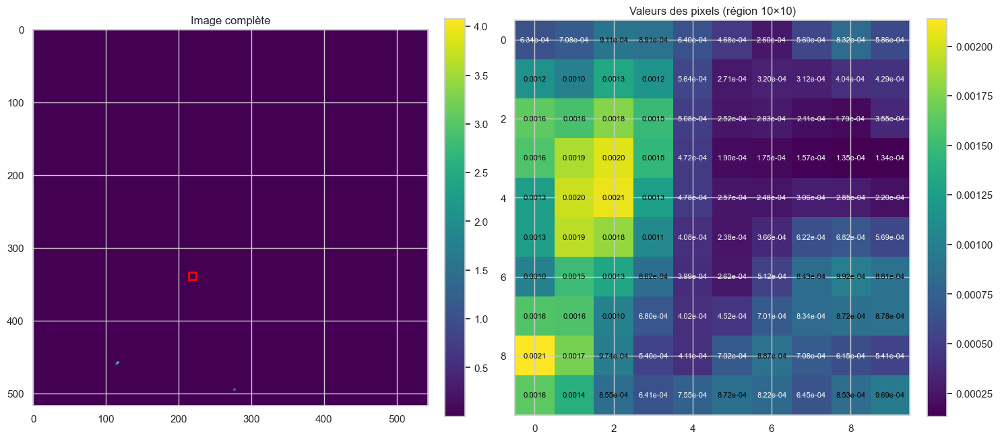

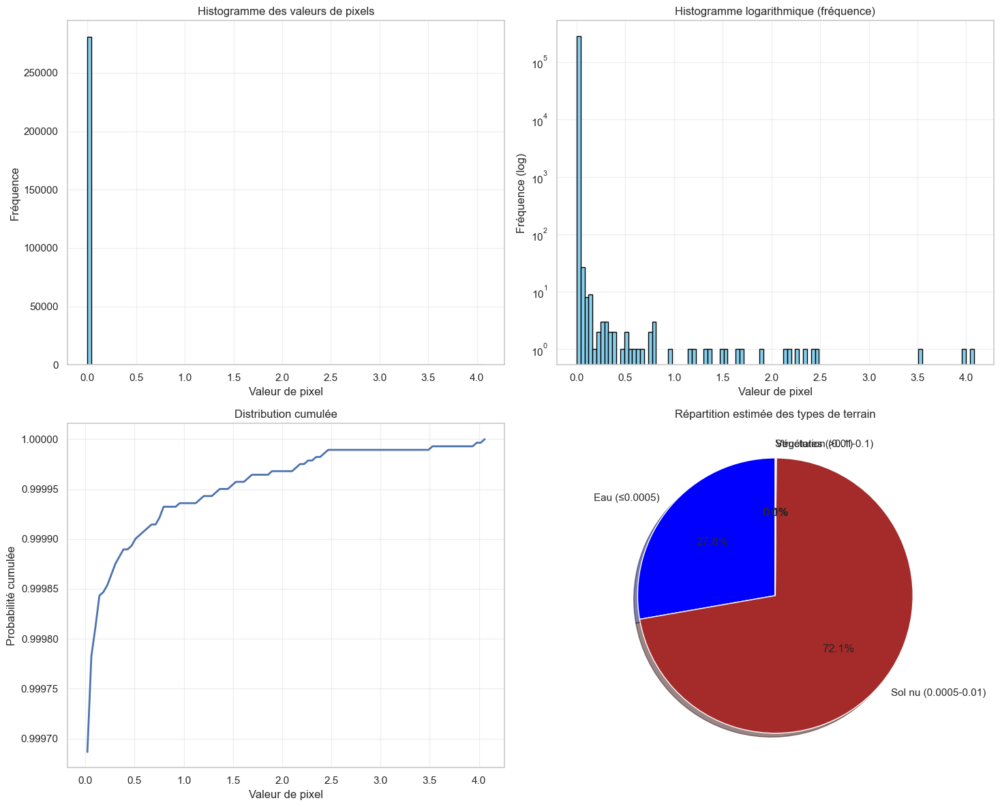


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 27.75% des pixels
  Moyenne: 0.00032301
  Écart-type: 0.00012150
Sol nu (0.0005-0.01): 72.13% des pixels
  Moyenne: 0.00101817
  Écart-type: 0.00055672
Végétation (0.01-0.1): 0.10% des pixels
  Moyenne: 0.02259280
  Écart-type: 0.01670345
Structures (>0.1): 0.02% des pixels
  Moyenne: 0.94436920
  Écart-type: 0.98912644
Taille originale VV: 517×543 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×543 pixels
Valeur minimale: 0.00002678
Valeur maximale: 14.52206898
Valeur moyenne: 0.00250558
Écart-type: 0.07110909


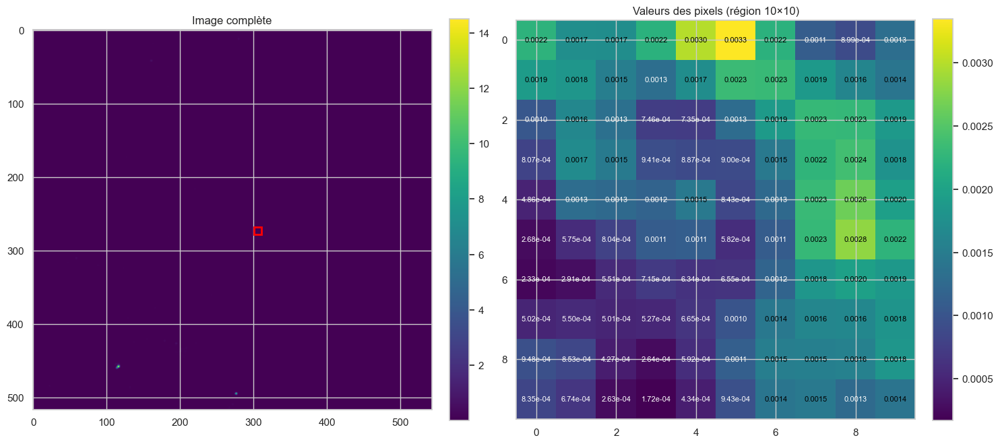

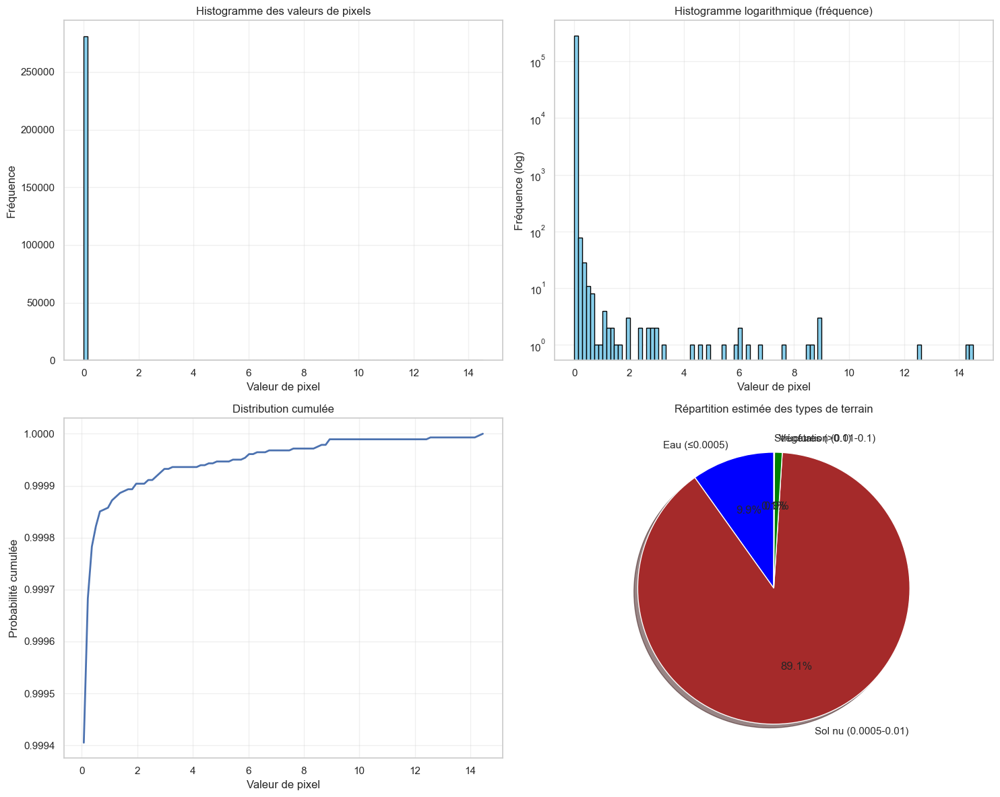


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 9.86% des pixels
  Moyenne: 0.00029954
  Écart-type: 0.00013341
Sol nu (0.0005-0.01): 89.15% des pixels
  Moyenne: 0.00158770
  Écart-type: 0.00103727
Végétation (0.01-0.1): 0.91% des pixels
  Moyenne: 0.02479748
  Écart-type: 0.01793890
Structures (>0.1): 0.09% des pixels
  Moyenne: 0.96086490
  Écart-type: 2.21091676
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0030\S1B_IW_GRDH_1SDV_20190123T162344_20190123T162409_014623_01B40F_3BD7_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0030\S1B_IW_GRDH_1SDV_20190123T162344_20190123T162409_014623_01B40F_3BD7_corrected_VV.tif
Taille originale VH: 521×544 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 521×544 pixels
Valeur minimale: 0.00002235
Valeur maximale: 0.08993783
Valeur moyenne: 0.00067377
Écart-type: 0.00074078


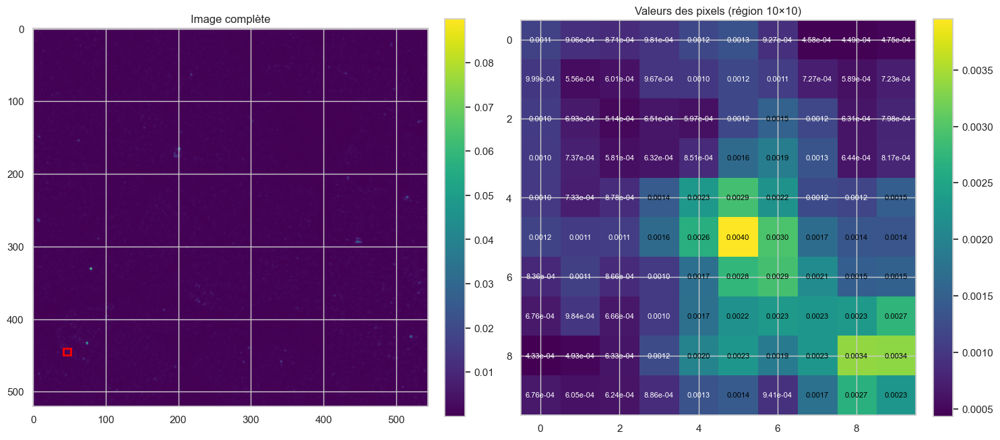

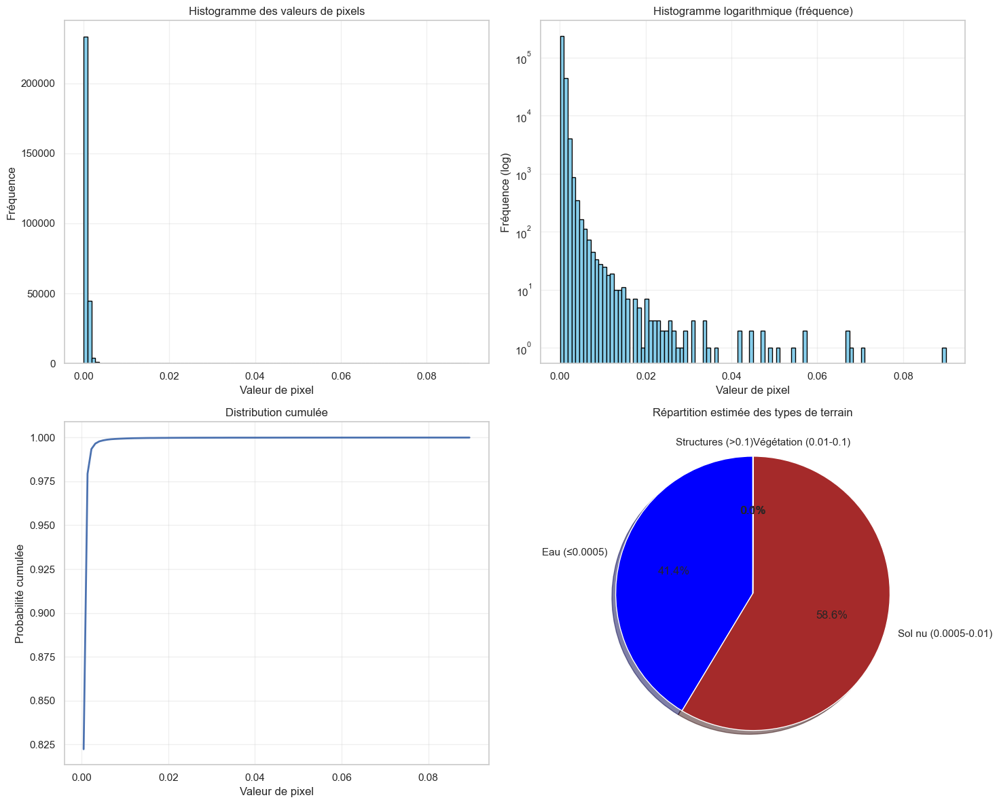


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 41.36% des pixels
  Moyenne: 0.00035009
  Écart-type: 0.00009643
Sol nu (0.0005-0.01): 58.58% des pixels
  Moyenne: 0.00088307
  Écart-type: 0.00049857
Végétation (0.01-0.1): 0.06% des pixels
  Moyenne: 0.02004347
  Écart-type: 0.01386347
Structures (>0.1): 0.00% des pixels
Taille originale VV: 521×544 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 521×544 pixels
Valeur minimale: 0.00004926
Valeur maximale: 0.56228101
Valeur moyenne: 0.00143330
Écart-type: 0.00388251


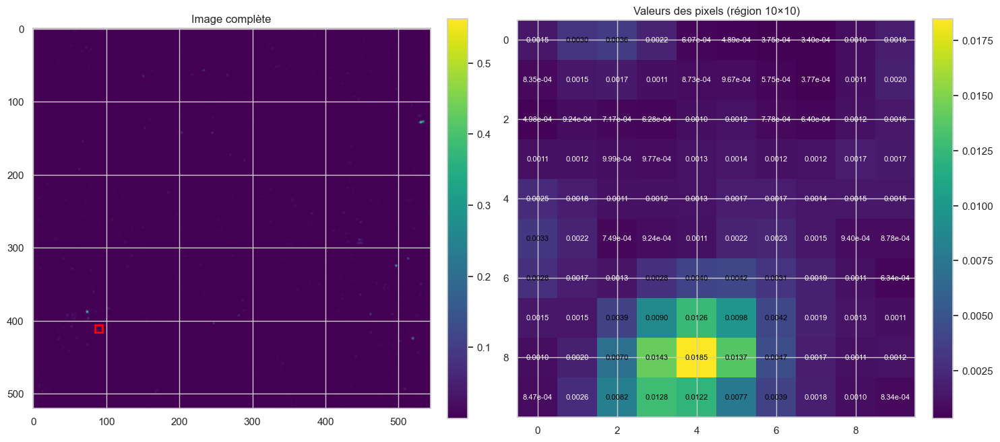

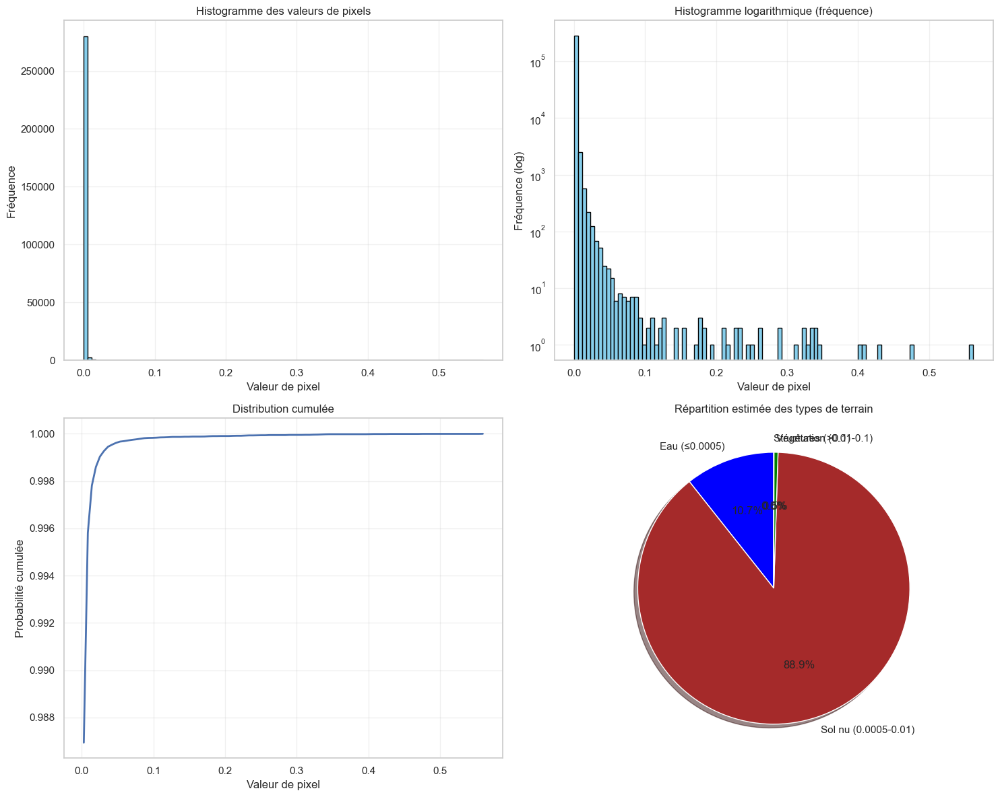


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 10.65% des pixels
  Moyenne: 0.00037380
  Écart-type: 0.00009138
Sol nu (0.0005-0.01): 88.85% des pixels
  Moyenne: 0.00141219
  Écart-type: 0.00095553
Végétation (0.01-0.1): 0.48% des pixels
  Moyenne: 0.02037259
  Écart-type: 0.01377592
Structures (>0.1): 0.02% des pixels
  Moyenne: 0.23618762
  Écart-type: 0.10697450
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0295\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0295\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VV.tif
Taille originale VH: 517×544 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×544 pixels
Valeur minimale: 0.00000631
Valeur maximale: 0.01004801
Valeur moyenne: 0.00023502
Écart-type: 0.00033937


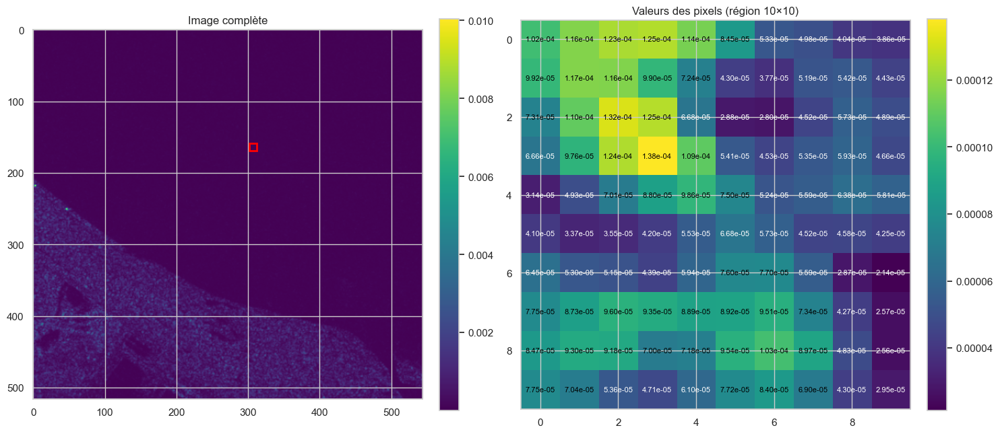

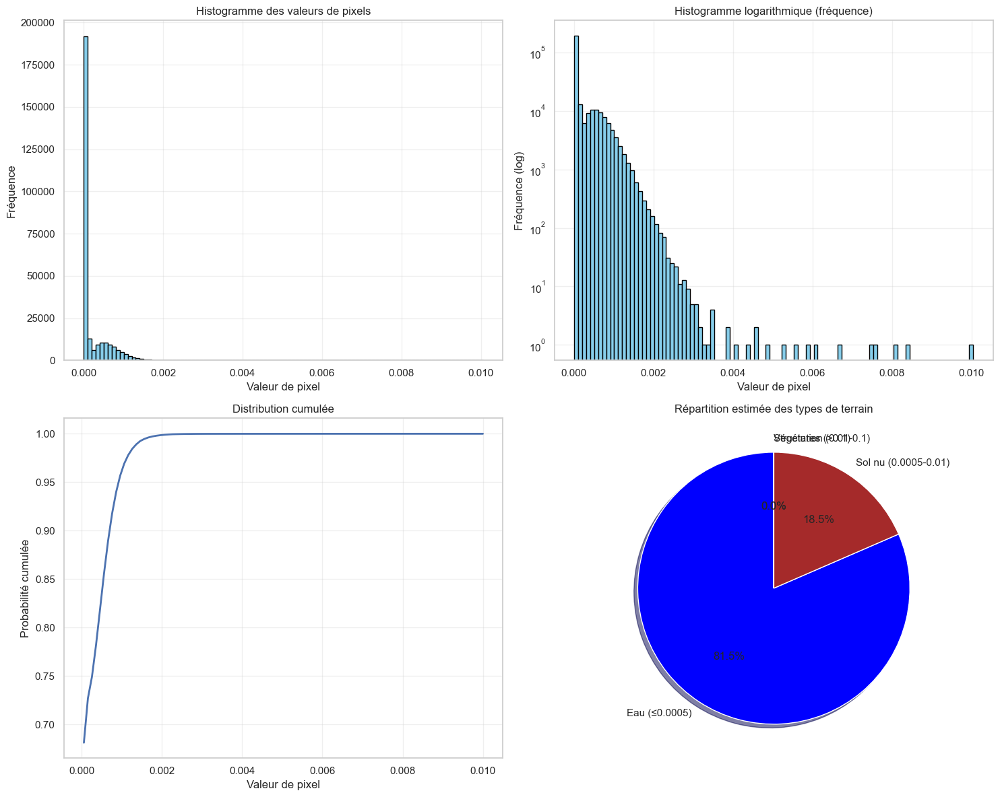


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 81.51% des pixels
  Moyenne: 0.00009466
  Écart-type: 0.00010333
Sol nu (0.0005-0.01): 18.49% des pixels
  Moyenne: 0.00085373
  Écart-type: 0.00032317
Végétation (0.01-0.1): 0.00% des pixels
  Moyenne: 0.01004801
  Écart-type: 0.00000000
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×544 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×544 pixels
Valeur minimale: 0.00000569
Valeur maximale: 0.08066968
Valeur moyenne: 0.00040691
Écart-type: 0.00069095


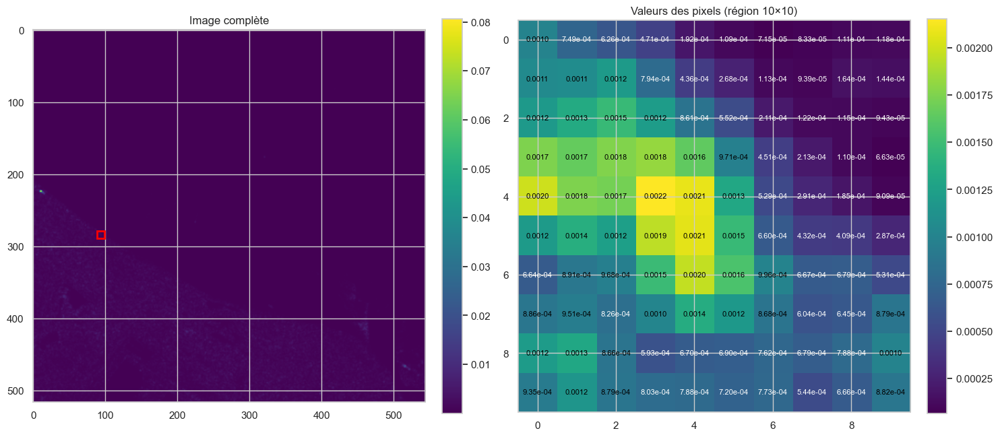

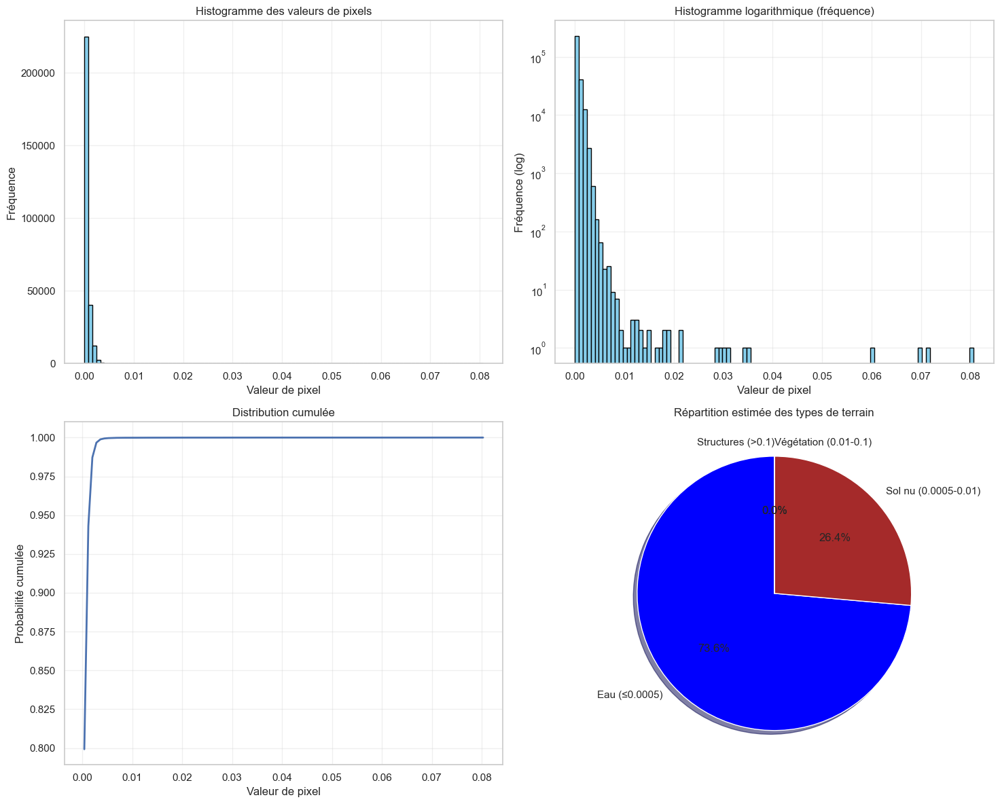


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 73.60% des pixels
  Moyenne: 0.00009664
  Écart-type: 0.00007352
Sol nu (0.0005-0.01): 26.39% des pixels
  Moyenne: 0.00126187
  Écart-type: 0.00062161
Végétation (0.01-0.1): 0.01% des pixels
  Moyenne: 0.02588266
  Écart-type: 0.01899184
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0201\S1A_IW_GRDH_1SDV_20190223T031705_20190223T031730_026051_02E795_2CA5_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0201\S1A_IW_GRDH_1SDV_20190223T031705_20190223T031730_026051_02E795_2CA5_corrected_VV.tif
Taille originale VH: 517×547 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×547 pixels
Valeur minimale: 0.00001915
Valeur maximale: 0.00809493
Valeur moyenne: 0.00073197
Écart-type: 0.00041894


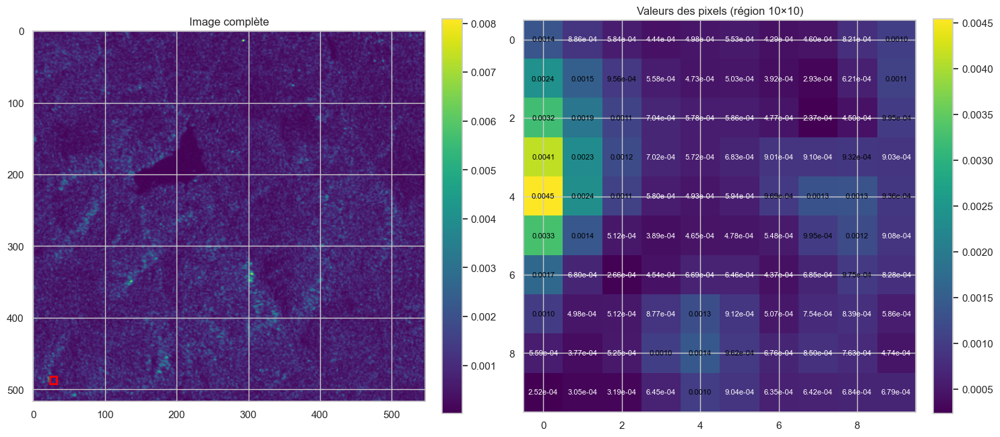

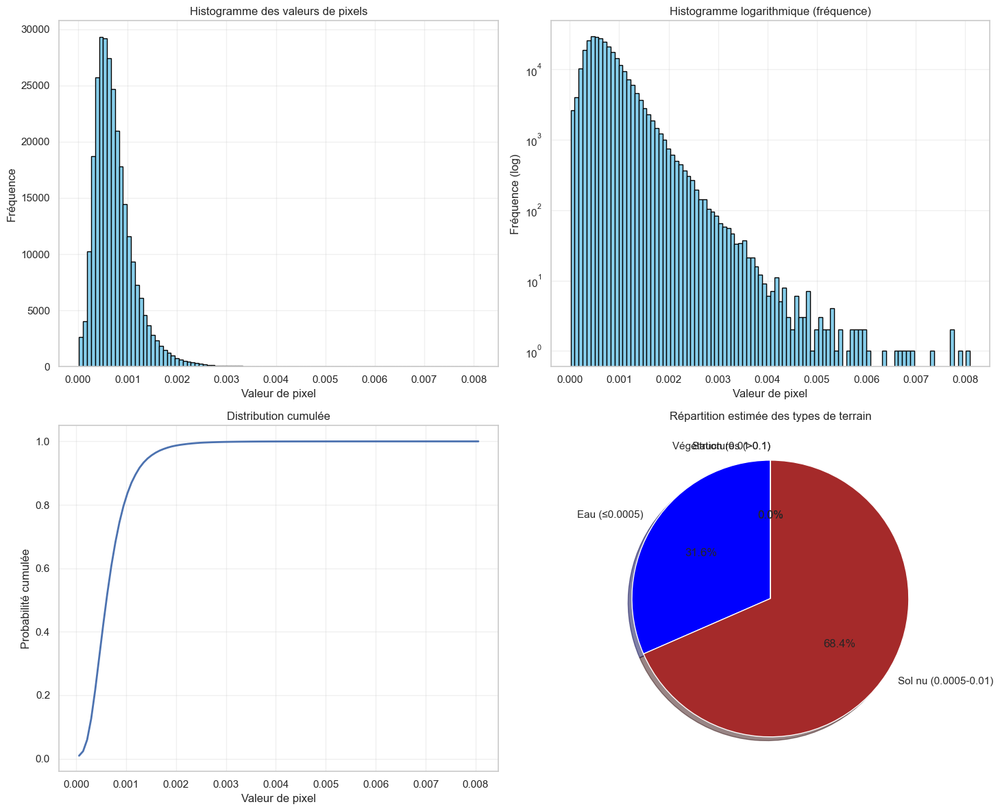


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 31.55% des pixels
  Moyenne: 0.00035360
  Écart-type: 0.00010538
Sol nu (0.0005-0.01): 68.45% des pixels
  Moyenne: 0.00090641
  Écart-type: 0.00039353
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×547 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×547 pixels
Valeur minimale: 0.00001924
Valeur maximale: 0.07258208
Valeur moyenne: 0.00141443
Écart-type: 0.00093067


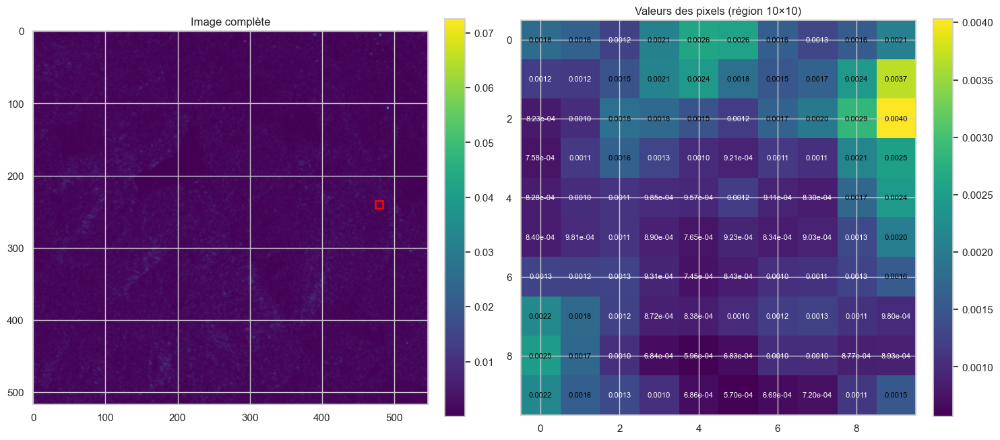

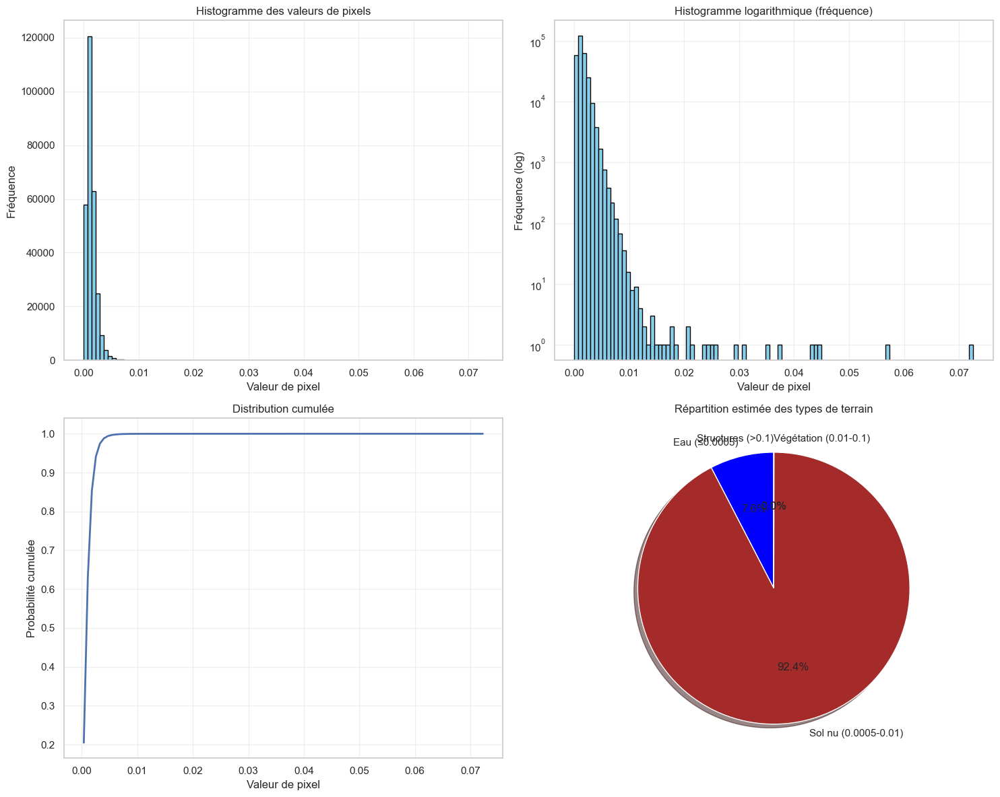


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 7.61% des pixels
  Moyenne: 0.00034053
  Écart-type: 0.00013265
Sol nu (0.0005-0.01): 92.37% des pixels
  Moyenne: 0.00149916
  Écart-type: 0.00085696
Végétation (0.01-0.1): 0.02% des pixels
  Moyenne: 0.01859605
  Écart-type: 0.01271111
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0097\S1B_IW_GRDH_1SDV_20190209T181740_20190209T181805_014873_01BC28_D12A_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0097\S1B_IW_GRDH_1SDV_20190209T181740_20190209T181805_014873_01BC28_D12A_corrected_VV.tif
Taille originale VH: 518×518 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 518×518 pixels
Valeur minimale: 0.00003496
Valeur maximale: 1.21698070
Valeur moyenne: 0.00120375
Écart-type: 0.00593040


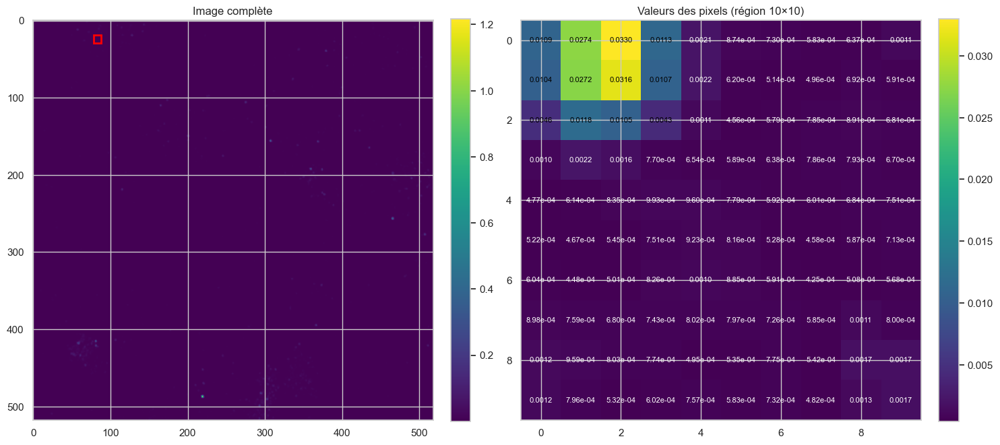

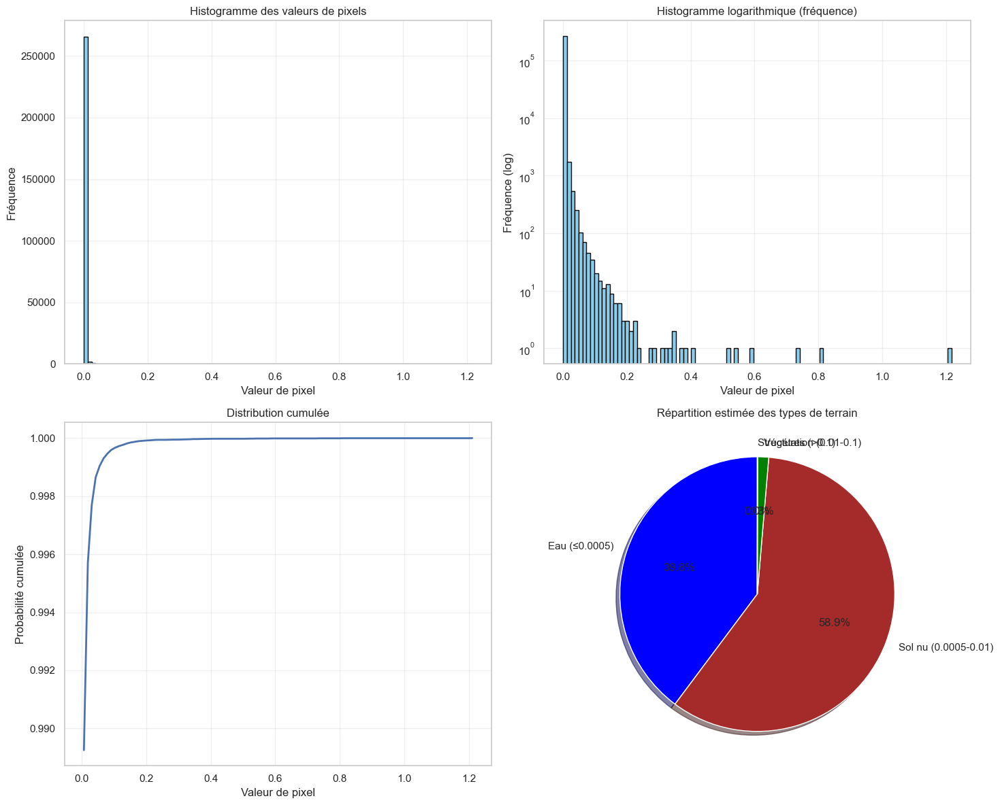


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 39.79% des pixels
  Moyenne: 0.00034472
  Écart-type: 0.00009676
Sol nu (0.0005-0.01): 58.87% des pixels
  Moyenne: 0.00117126
  Écart-type: 0.00115064
Végétation (0.01-0.1): 1.30% des pixels
  Moyenne: 0.02327002
  Écart-type: 0.01576395
Structures (>0.1): 0.04% des pixels
  Moyenne: 0.19762713
  Écart-type: 0.16125645
Taille originale VV: 518×518 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 518×518 pixels
Valeur minimale: 0.00009983
Valeur maximale: 3.64911580
Valeur moyenne: 0.00578448
Écart-type: 0.03325335


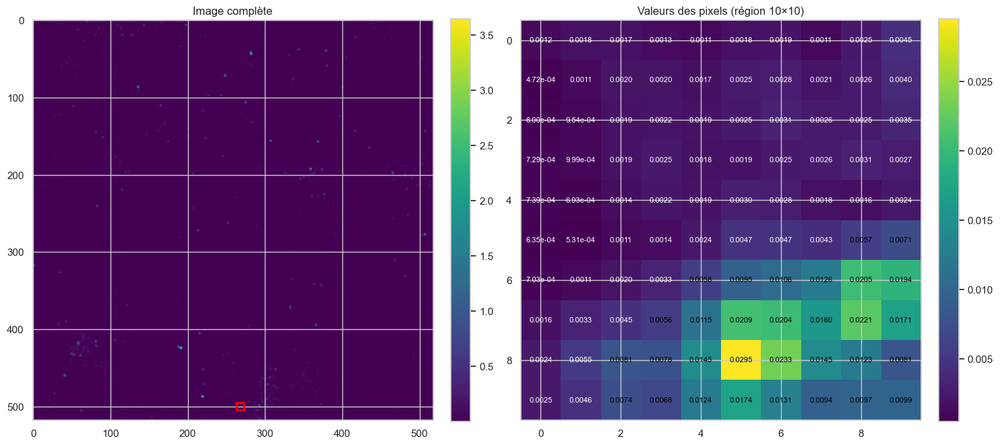

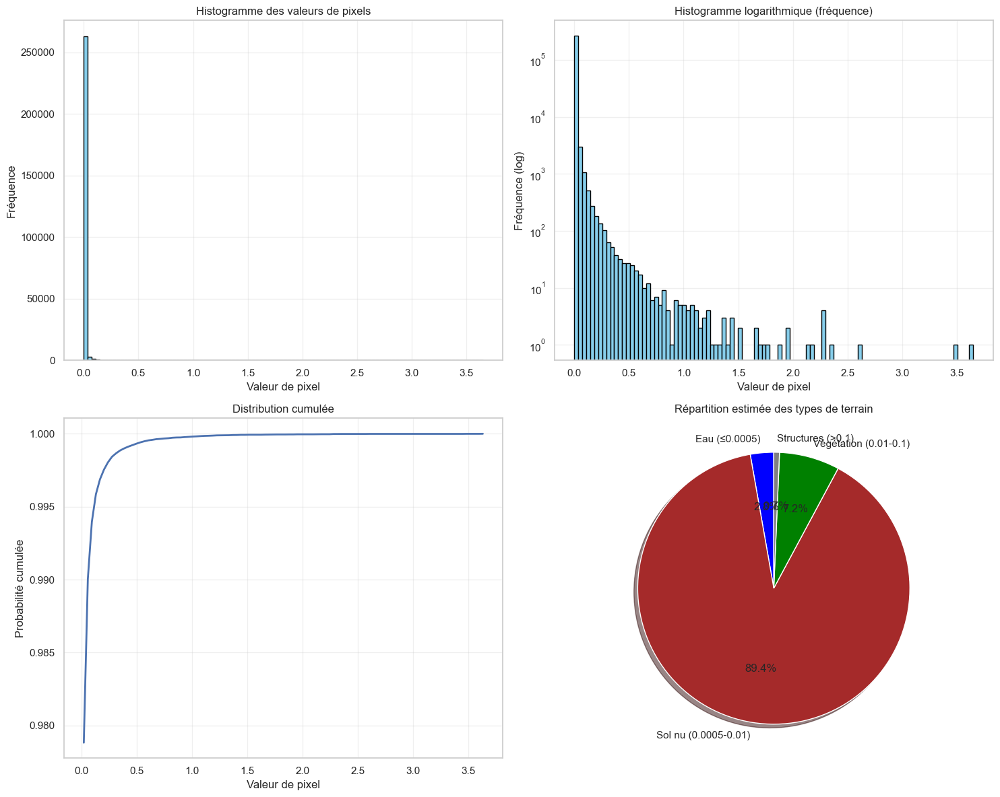


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 2.78% des pixels
  Moyenne: 0.00039537
  Écart-type: 0.00008062
Sol nu (0.0005-0.01): 89.38% des pixels
  Moyenne: 0.00235145
  Écart-type: 0.00182208
Végétation (0.01-0.1): 7.17% des pixels
  Moyenne: 0.02599606
  Écart-type: 0.01905500
Structures (>0.1): 0.67% des pixels
  Moyenne: 0.26941407
  Écart-type: 0.29133207
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0191\S1B_IW_GRDH_1SDV_20190325T031623_20190325T031648_015505_01D0E3_8490_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0191\S1B_IW_GRDH_1SDV_20190325T031623_20190325T031648_015505_01D0E3_8490_corrected_VV.tif
Taille originale VH: 517×548 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×548 pixels
Valeur minimale: 0.00001454
Valeur maximale: 0.01863889
Valeur moyenne: 0.00091558
Écart-type: 0.00082541


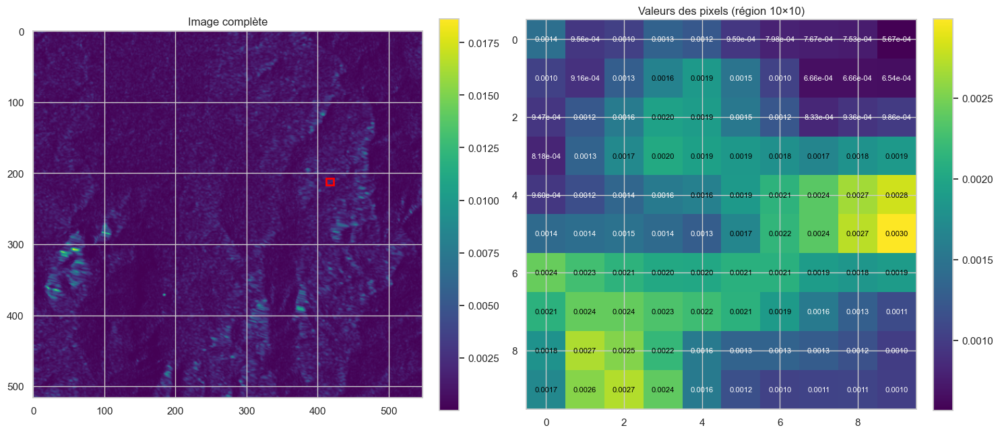

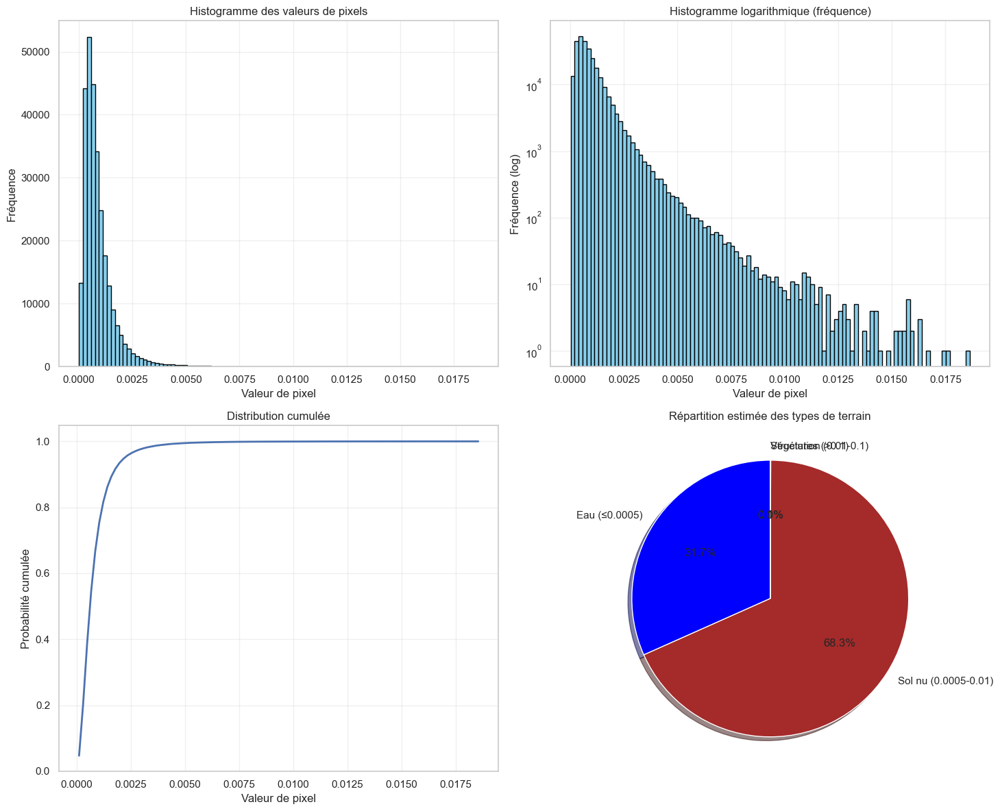


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 31.68% des pixels
  Moyenne: 0.00032977
  Écart-type: 0.00010968
Sol nu (0.0005-0.01): 68.27% des pixels
  Moyenne: 0.00117833
  Écart-type: 0.00081190
Végétation (0.01-0.1): 0.05% des pixels
  Moyenne: 0.01219610
  Écart-type: 0.00192542
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×548 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×548 pixels
Valeur minimale: 0.00001505
Valeur maximale: 0.60013372
Valeur moyenne: 0.00193881
Écart-type: 0.00299273


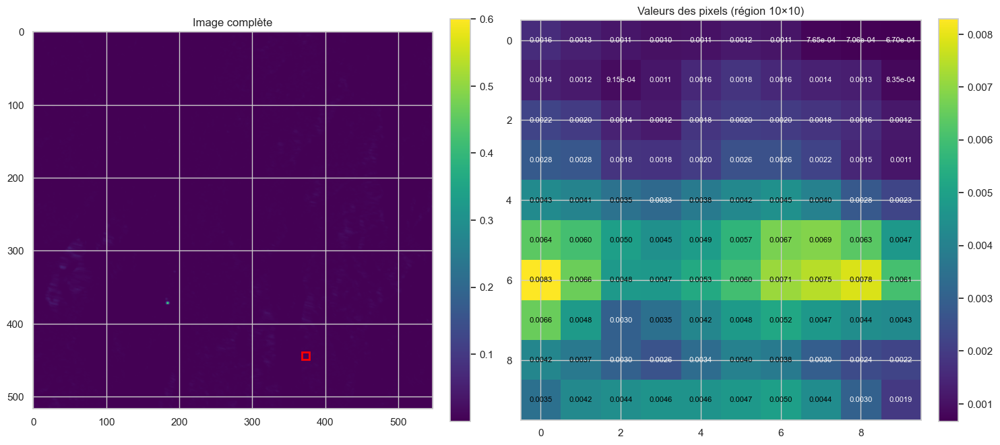

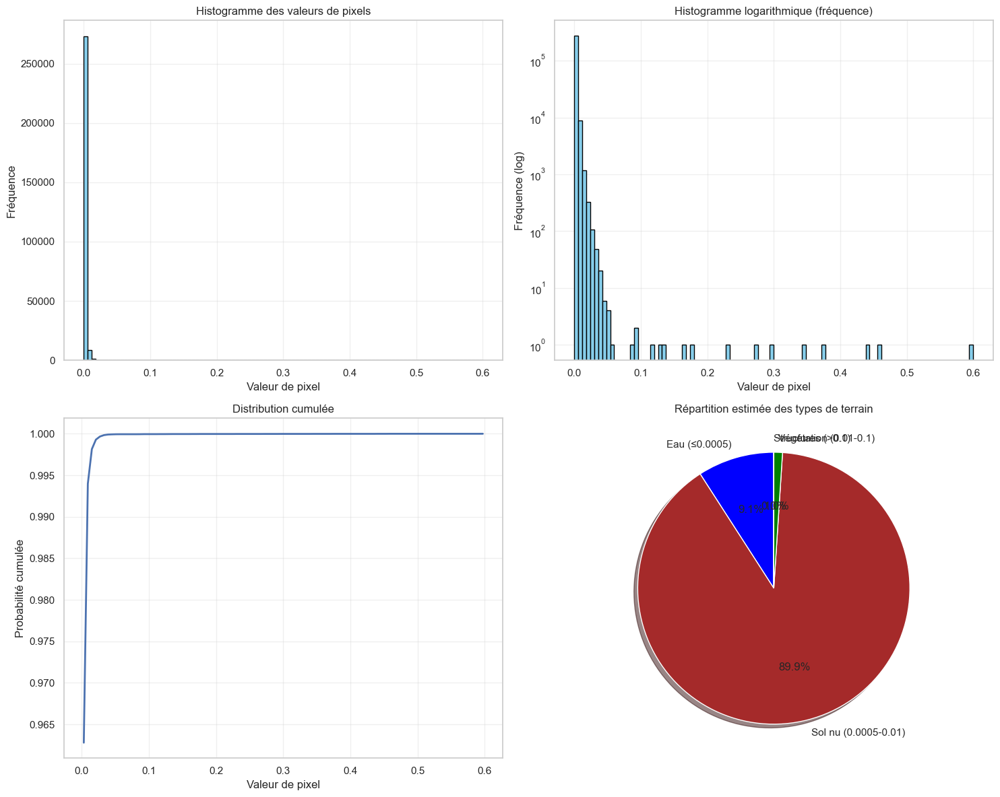


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 9.10% des pixels
  Moyenne: 0.00034776
  Écart-type: 0.00011179
Sol nu (0.0005-0.01): 89.87% des pixels
  Moyenne: 0.00194055
  Écart-type: 0.00148644
Végétation (0.01-0.1): 1.02% des pixels
  Moyenne: 0.01468412
  Écart-type: 0.00602712
Structures (>0.1): 0.00% des pixels
  Moyenne: 0.28782922
  Écart-type: 0.14457676
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0331\S1A_IW_GRDH_1SDV_20190206T084322_20190206T084356_025806_02DECC_48D4_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0331\S1A_IW_GRDH_1SDV_20190206T084322_20190206T084356_025806_02DECC_48D4_corrected_VV.tif
Taille originale VH: 517×545 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×545 pixels
Valeur minimale: 0.00001772
Valeur maximale: 0.08971789
Valeur moyenne: 0.00083821
Écart-type: 0.00063275


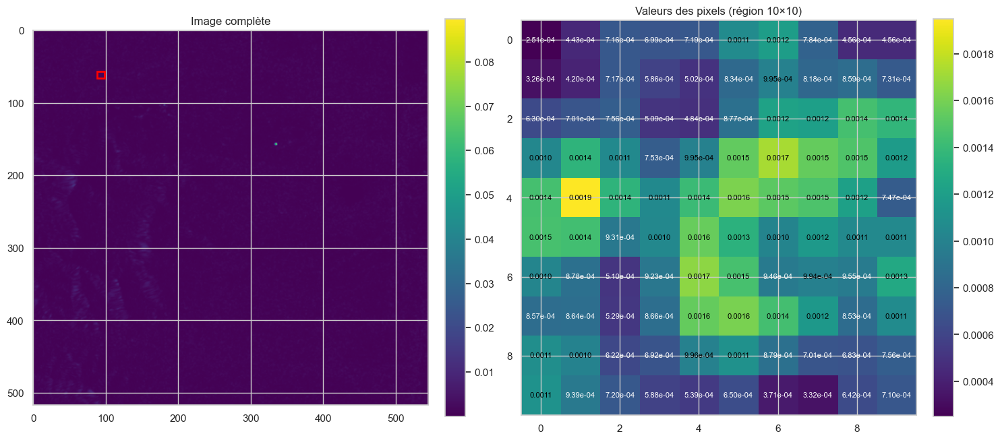

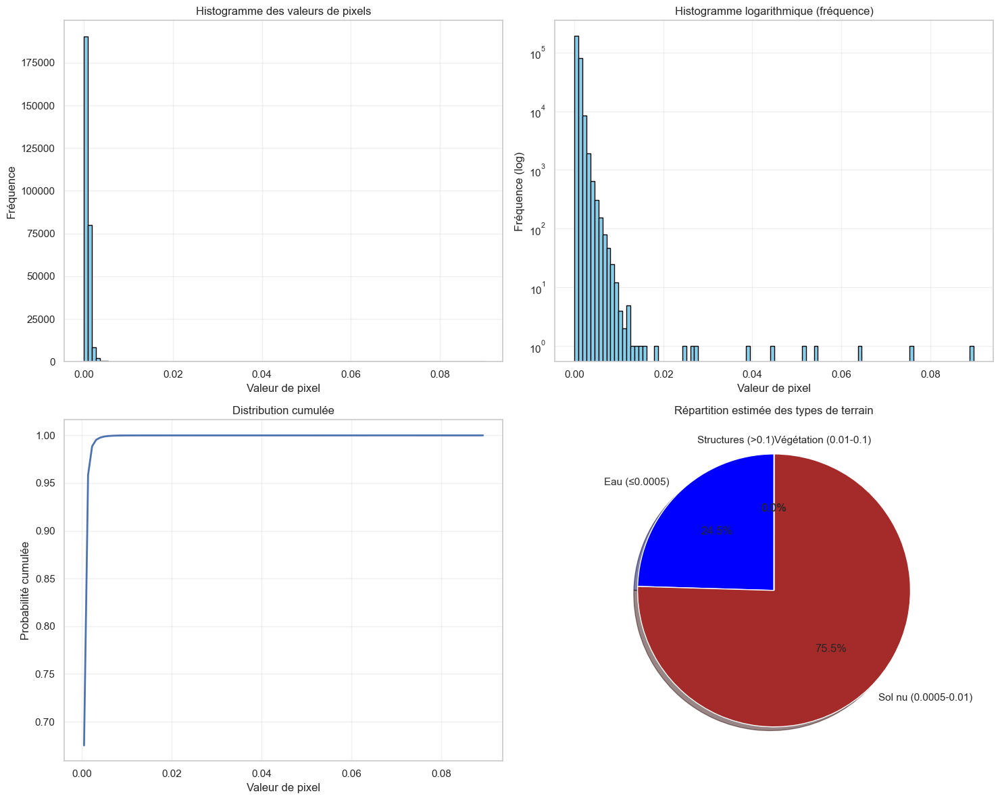


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 24.53% des pixels
  Moyenne: 0.00036413
  Écart-type: 0.00009647
Sol nu (0.0005-0.01): 75.46% des pixels
  Moyenne: 0.00098915
  Écart-type: 0.00053653
Végétation (0.01-0.1): 0.01% des pixels
  Moyenne: 0.02685080
  Écart-type: 0.02235413
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×545 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×545 pixels
Valeur minimale: 0.00004661
Valeur maximale: 1.74911845
Valeur moyenne: 0.00143853
Écart-type: 0.00646189


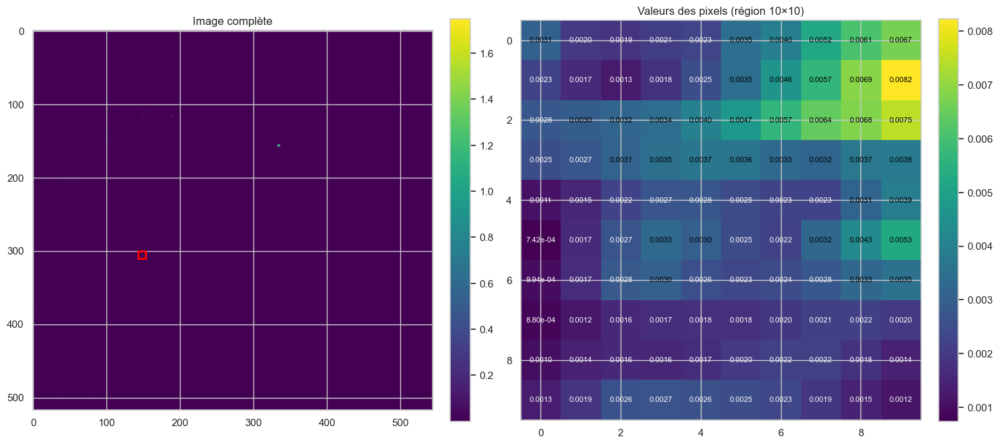

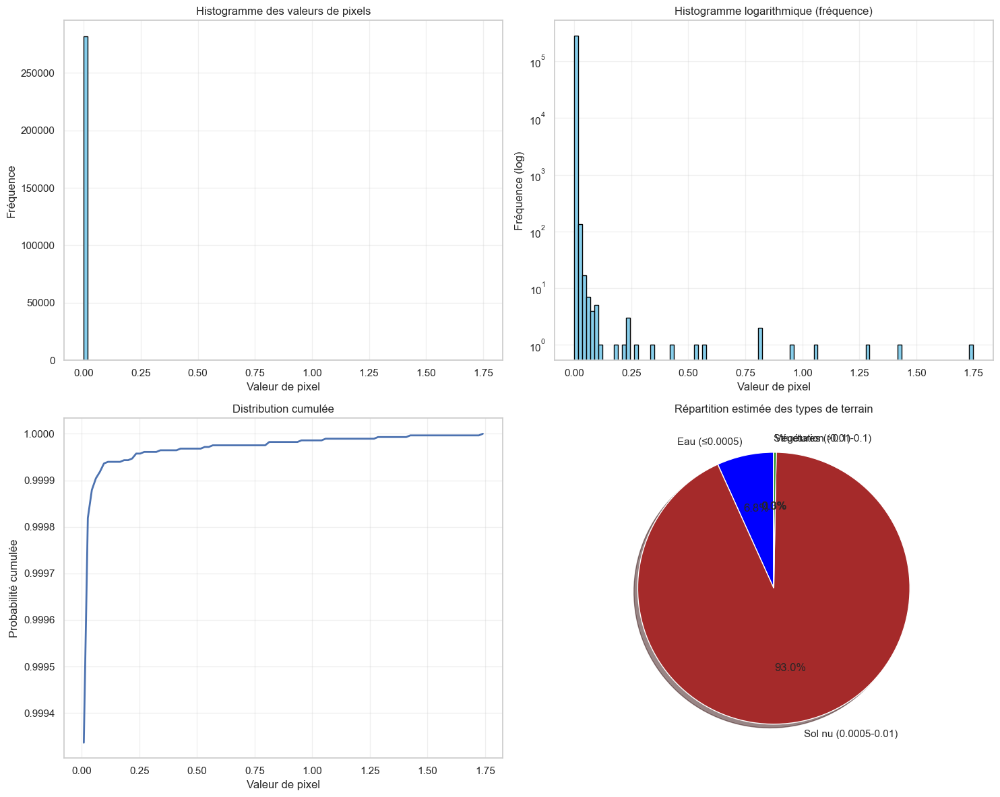


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 6.76% des pixels
  Moyenne: 0.00037960
  Écart-type: 0.00009369
Sol nu (0.0005-0.01): 92.96% des pixels
  Moyenne: 0.00142852
  Écart-type: 0.00090296
Végétation (0.01-0.1): 0.28% des pixels
  Moyenne: 0.01590398
  Écart-type: 0.01063248
Structures (>0.1): 0.01% des pixels
  Moyenne: 0.63676888
  Écart-type: 0.47209224
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\39\S1B_IW_GRDH_1SDV_20190110T032731_20190110T032756_014426_01ADAF_D007_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\39\S1B_IW_GRDH_1SDV_20190110T032731_20190110T032756_014426_01ADAF_D007_corrected_VV.tif
Taille originale VH: 517×514 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×514 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


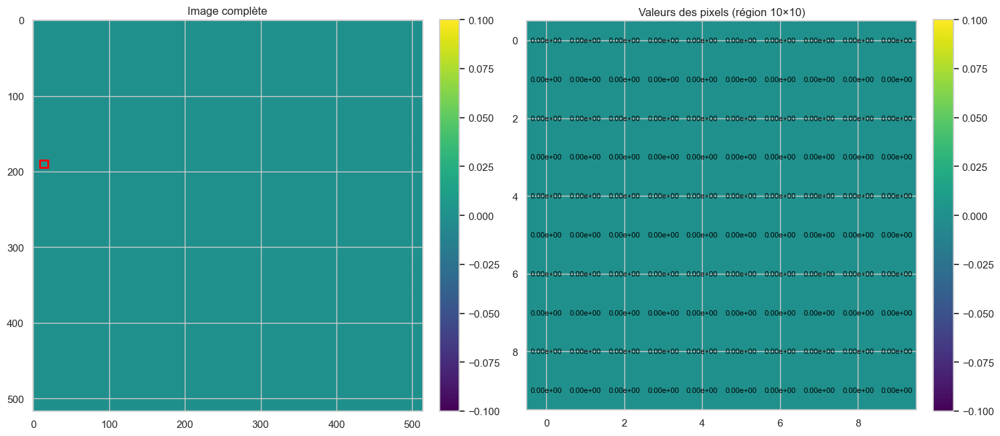

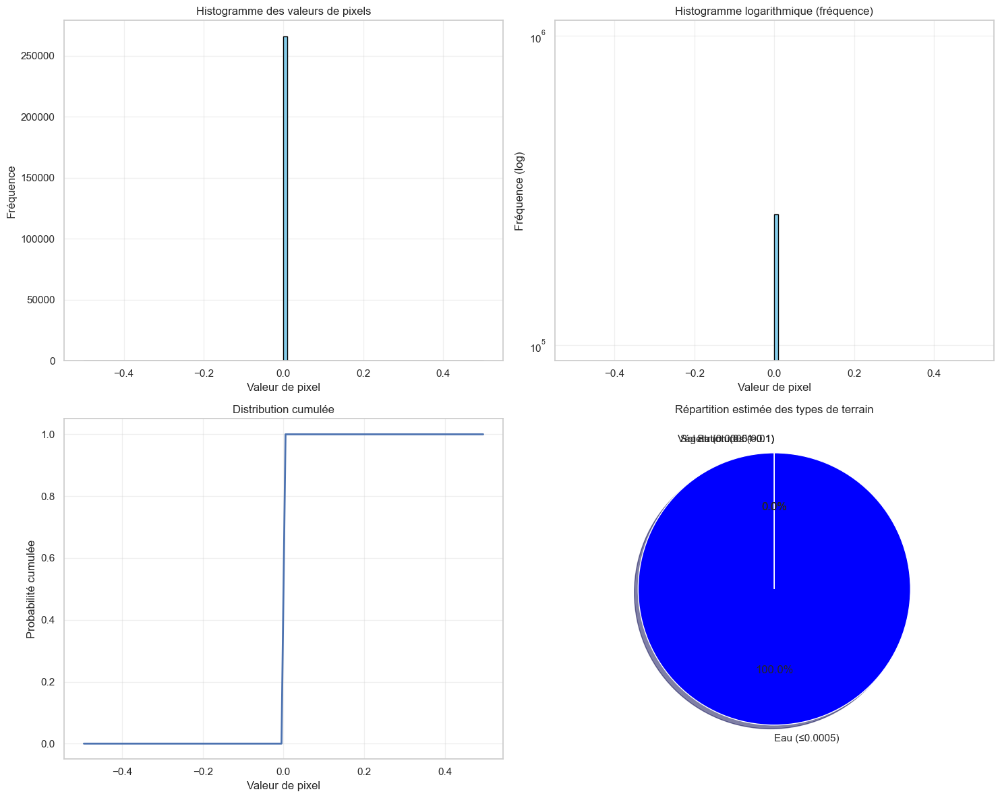


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00000000
  Écart-type: 0.00000000
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×514 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×514 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


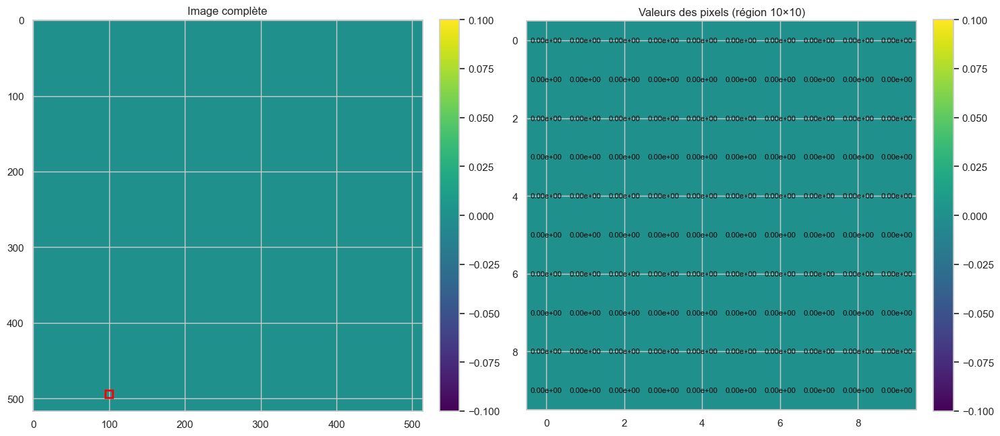

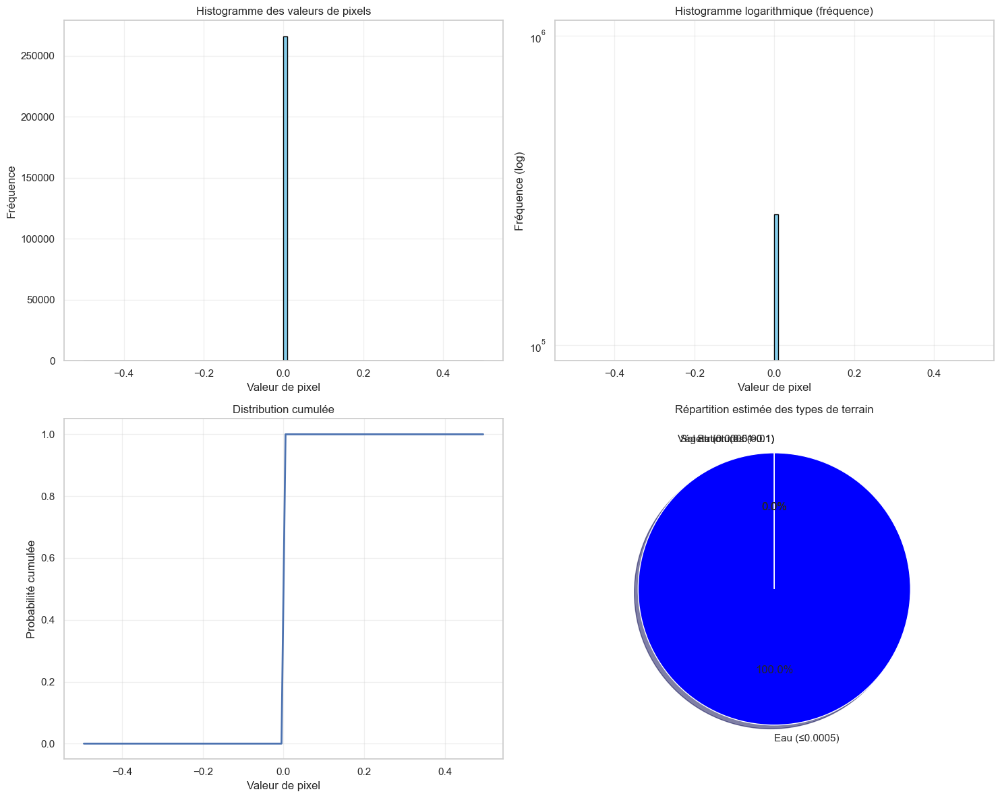


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00000000
  Écart-type: 0.00000000
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0103\S1A_IW_GRDH_1SDV_20190203T181824_20190203T181849_025769_02DD8E_30F0_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0103\S1A_IW_GRDH_1SDV_20190203T181824_20190203T181849_025769_02DD8E_30F0_corrected_VV.tif
Taille originale VH: 519×519 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 519×519 pixels
Valeur minimale: 0.00002392
Valeur maximale: 0.79860961
Valeur moyenne: 0.00104841
Écart-type: 0.00481879


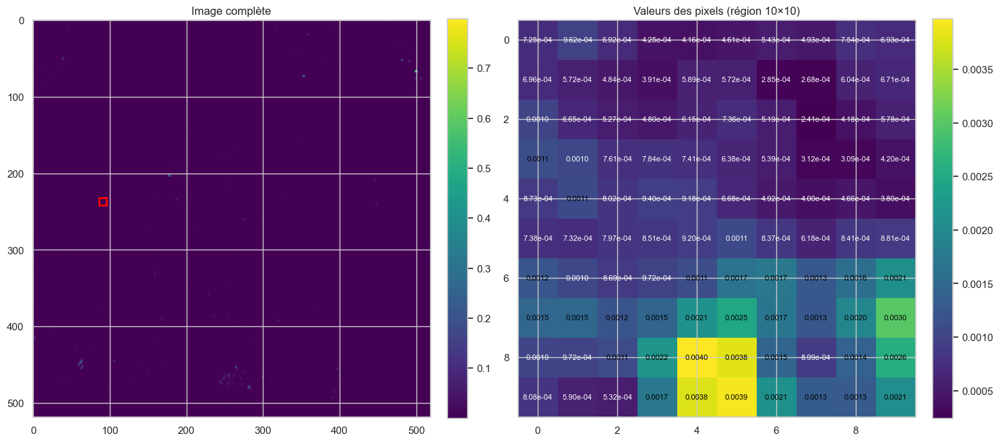

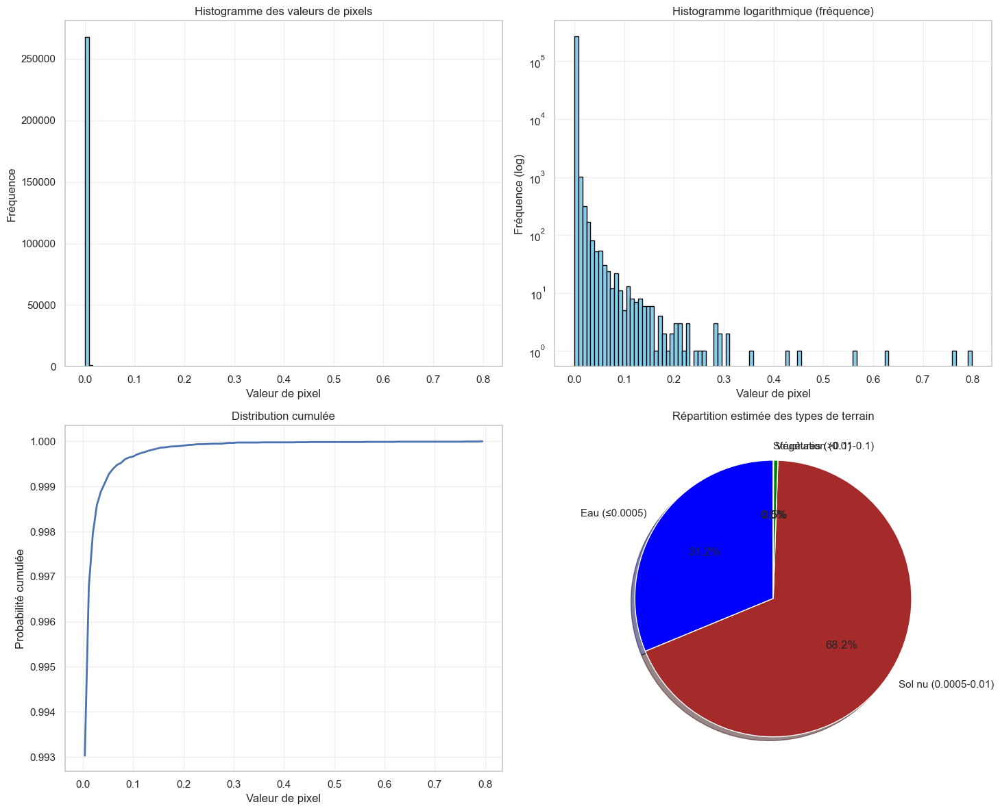


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 31.23% des pixels
  Moyenne: 0.00034251
  Écart-type: 0.00010278
Sol nu (0.0005-0.01): 68.23% des pixels
  Moyenne: 0.00109992
  Écart-type: 0.00085077
Végétation (0.01-0.1): 0.51% des pixels
  Moyenne: 0.02477382
  Écart-type: 0.01787408
Structures (>0.1): 0.03% des pixels
  Moyenne: 0.19256130
  Écart-type: 0.12782502
Taille originale VV: 519×519 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 519×519 pixels
Valeur minimale: 0.00006039
Valeur maximale: 6.83222151
Valeur moyenne: 0.00394490
Écart-type: 0.03133910


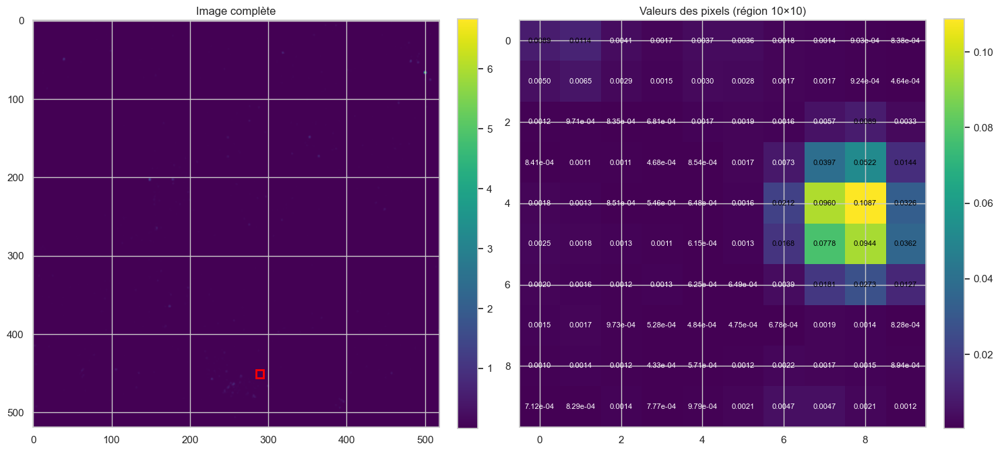

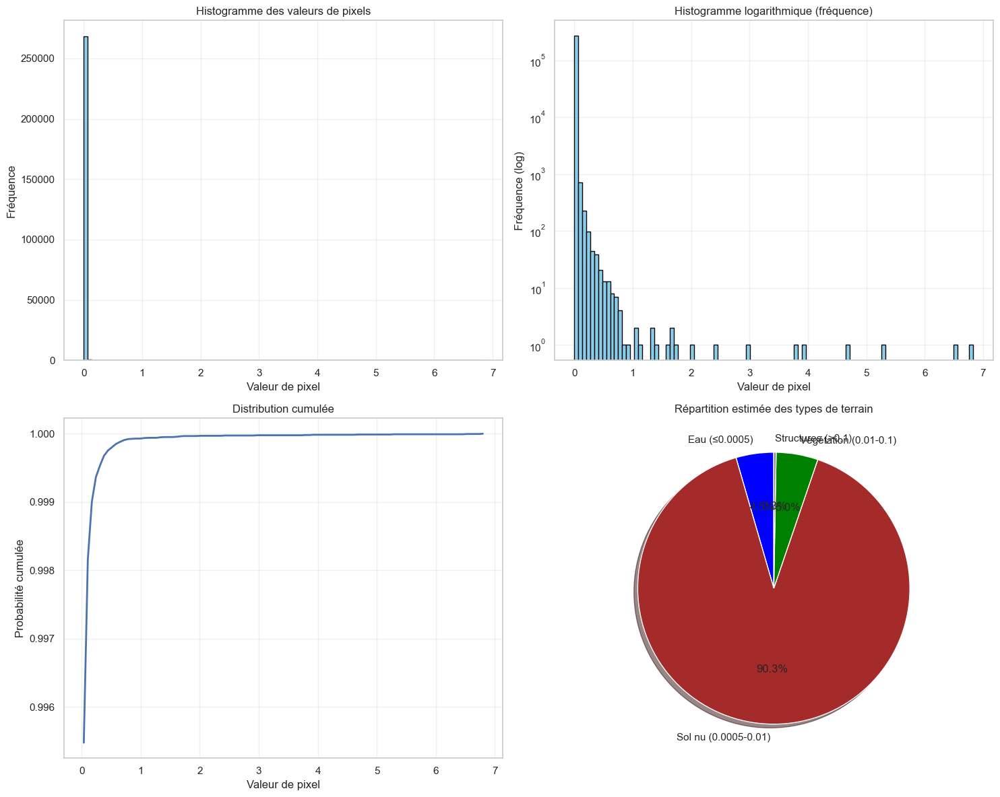


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 4.48% des pixels
  Moyenne: 0.00037764
  Écart-type: 0.00008889
Sol nu (0.0005-0.01): 90.28% des pixels
  Moyenne: 0.00223466
  Écart-type: 0.00171585
Végétation (0.01-0.1): 4.97% des pixels
  Moyenne: 0.02289082
  Écart-type: 0.01664253
Structures (>0.1): 0.27% des pixels
  Moyenne: 0.28336039
  Écart-type: 0.51781100
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0079\S1A_IW_GRDH_1SDV_20190126T160455_20190126T160520_025650_02D94A_A0D8_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0079\S1A_IW_GRDH_1SDV_20190126T160455_20190126T160520_025650_02D94A_A0D8_corrected_VV.tif
Taille originale VH: 516×513 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×513 pixels
Valeur minimale: 0.00005481
Valeur maximale: 1.39520955
Valeur moyenne: 0.00214333
Écart-type: 0.01006550


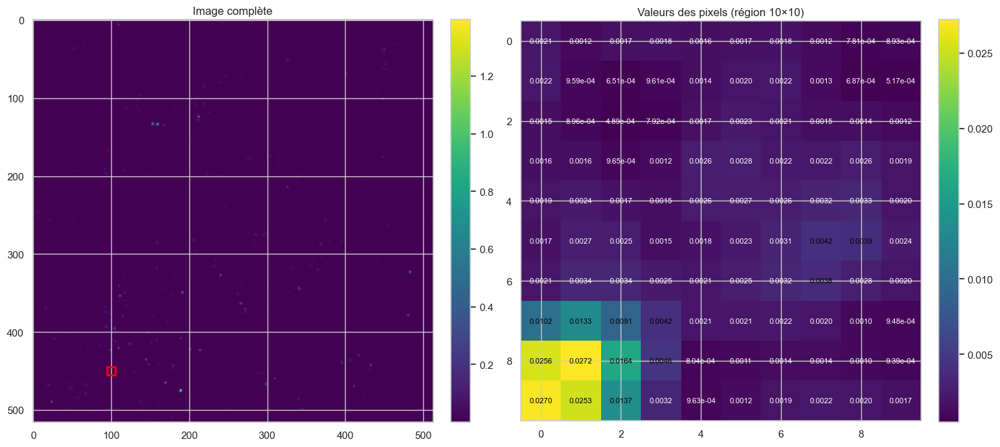

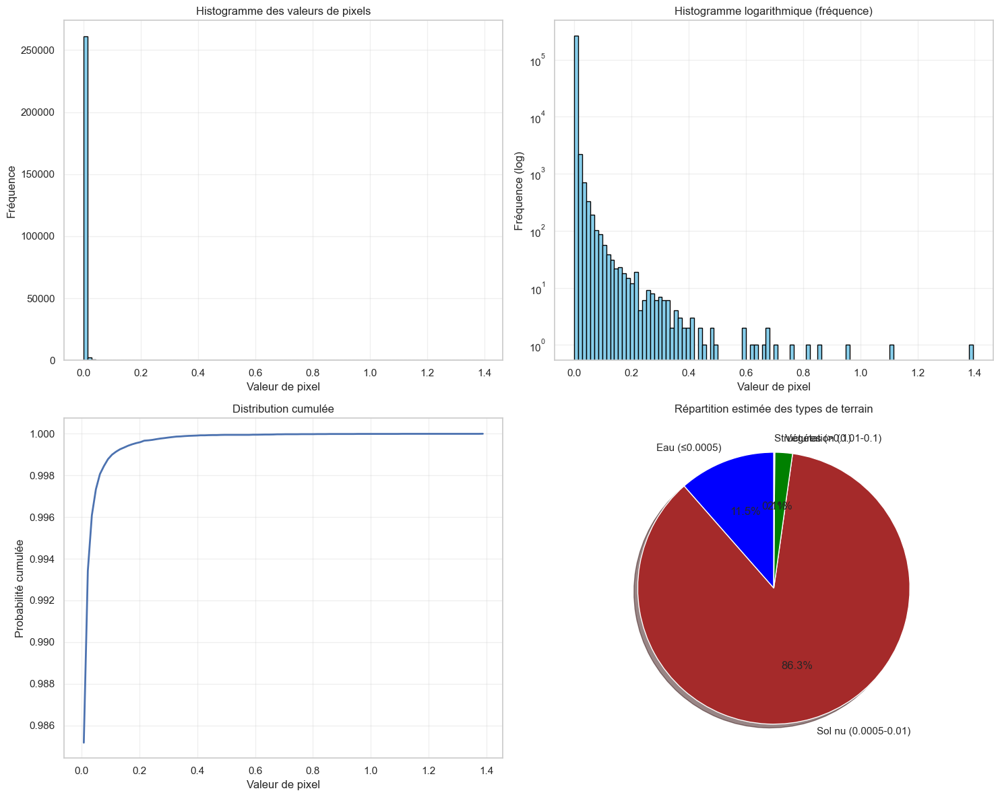


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 11.46% des pixels
  Moyenne: 0.00037683
  Écart-type: 0.00008813
Sol nu (0.0005-0.01): 86.33% des pixels
  Moyenne: 0.00155445
  Écart-type: 0.00130000
Végétation (0.01-0.1): 2.09% des pixels
  Moyenne: 0.02413915
  Écart-type: 0.01741494
Structures (>0.1): 0.12% des pixels
  Moyenne: 0.21664339
  Écart-type: 0.15765144
Taille originale VV: 516×513 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×513 pixels
Valeur minimale: 0.00005467
Valeur maximale: 3.76640677
Valeur moyenne: 0.00873954
Écart-type: 0.04348711


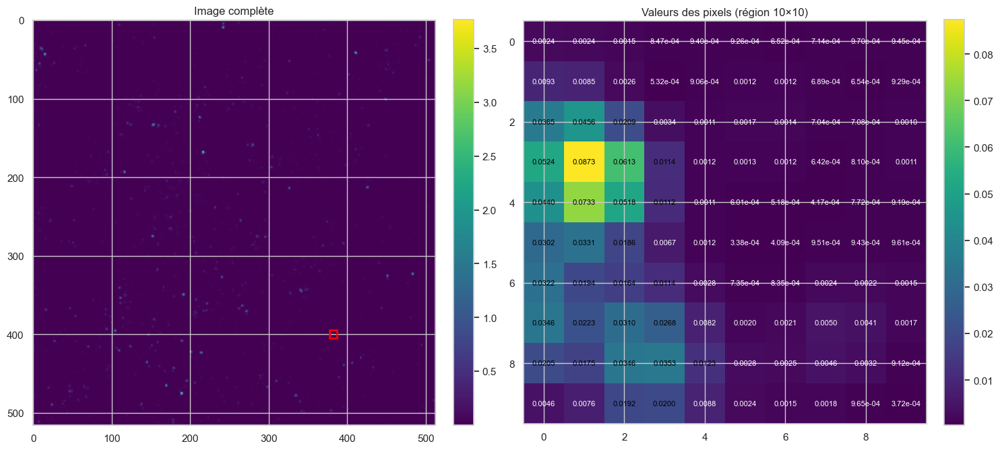

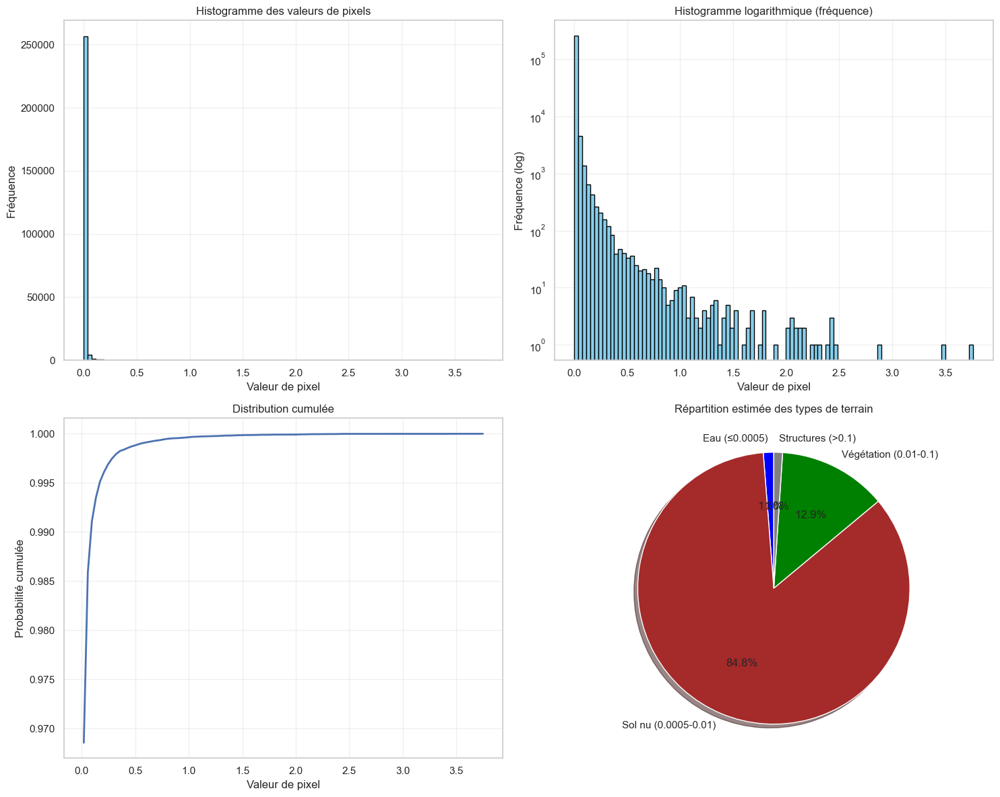


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 1.24% des pixels
  Moyenne: 0.00038760
  Écart-type: 0.00008805
Sol nu (0.0005-0.01): 84.82% des pixels
  Moyenne: 0.00311821
  Écart-type: 0.00214829
Végétation (0.01-0.1): 12.91% des pixels
  Moyenne: 0.02433085
  Écart-type: 0.01761652
Structures (>0.1): 1.04% des pixels
  Moyenne: 0.28482714
  Écart-type: 0.31067753
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0169\S1A_IW_GRDH_1SDV_20190309T030013_20190309T030038_026255_02EEF0_7D38_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0169\S1A_IW_GRDH_1SDV_20190309T030013_20190309T030038_026255_02EEF0_7D38_corrected_VV.tif
Taille originale VH: 525×550 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 525×550 pixels
Valeur minimale: 0.00000878
Valeur maximale: 0.00401509
Valeur moyenne: 0.00063411
Écart-type: 0.00039677


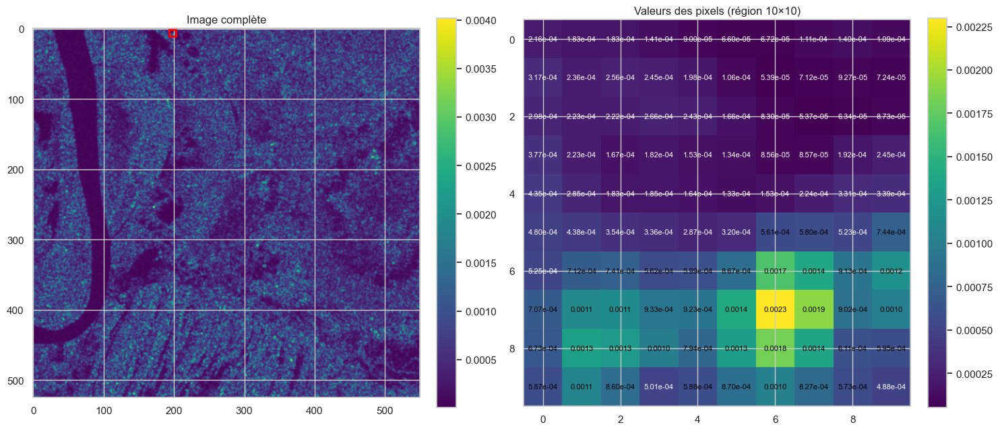

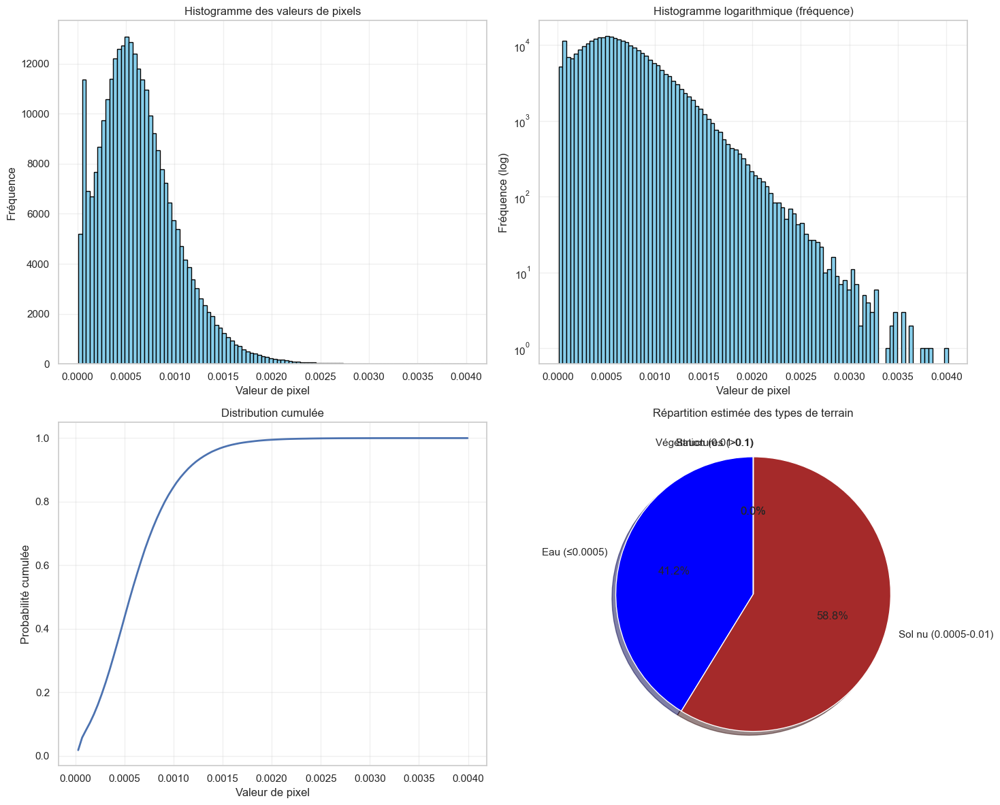


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 41.23% des pixels
  Moyenne: 0.00028407
  Écart-type: 0.00014011
Sol nu (0.0005-0.01): 58.77% des pixels
  Moyenne: 0.00087973
  Écart-type: 0.00032834
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 525×550 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 525×550 pixels
Valeur minimale: 0.00001500
Valeur maximale: 0.01245179
Valeur moyenne: 0.00142090
Écart-type: 0.00092805


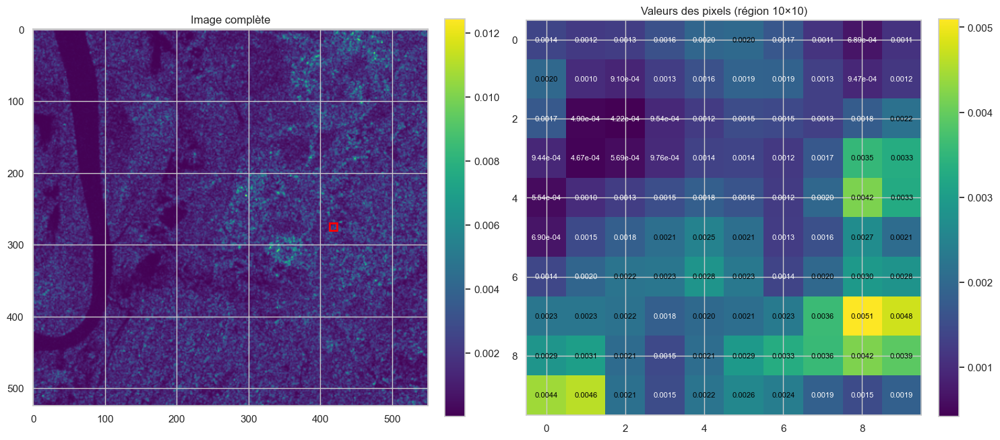

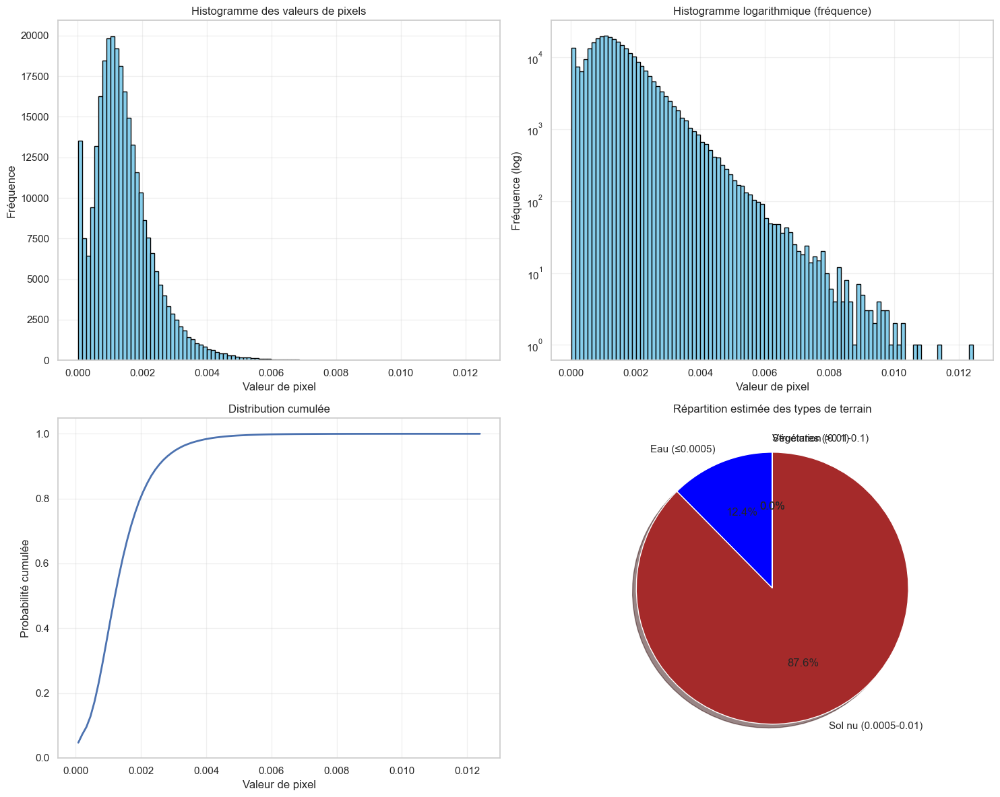


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 12.38% des pixels
  Moyenne: 0.00023773
  Écart-type: 0.00014585
Sol nu (0.0005-0.01): 87.61% des pixels
  Moyenne: 0.00158779
  Écart-type: 0.00086675
Végétation (0.01-0.1): 0.00% des pixels
  Moyenne: 0.01066465
  Écart-type: 0.00075724
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0272\S1B_IW_GRDH_1SDV_20190315T024546_20190315T024609_015359_01CC22_8A5B_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0272\S1B_IW_GRDH_1SDV_20190315T024546_20190315T024609_015359_01CC22_8A5B_corrected_VV.tif
Taille originale VH: 526×613 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 526×613 pixels
Valeur minimale: 0.00001137
Valeur maximale: 0.02515559
Valeur moyenne: 0.00022699
Écart-type: 0.00025031


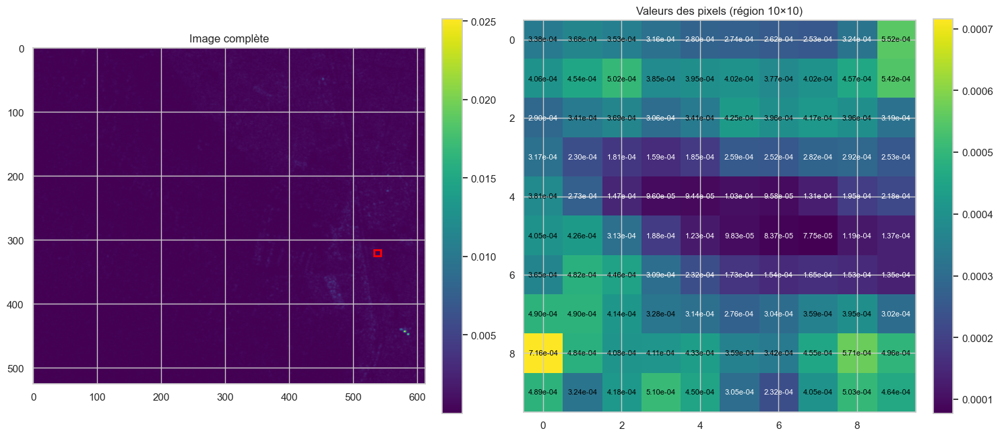

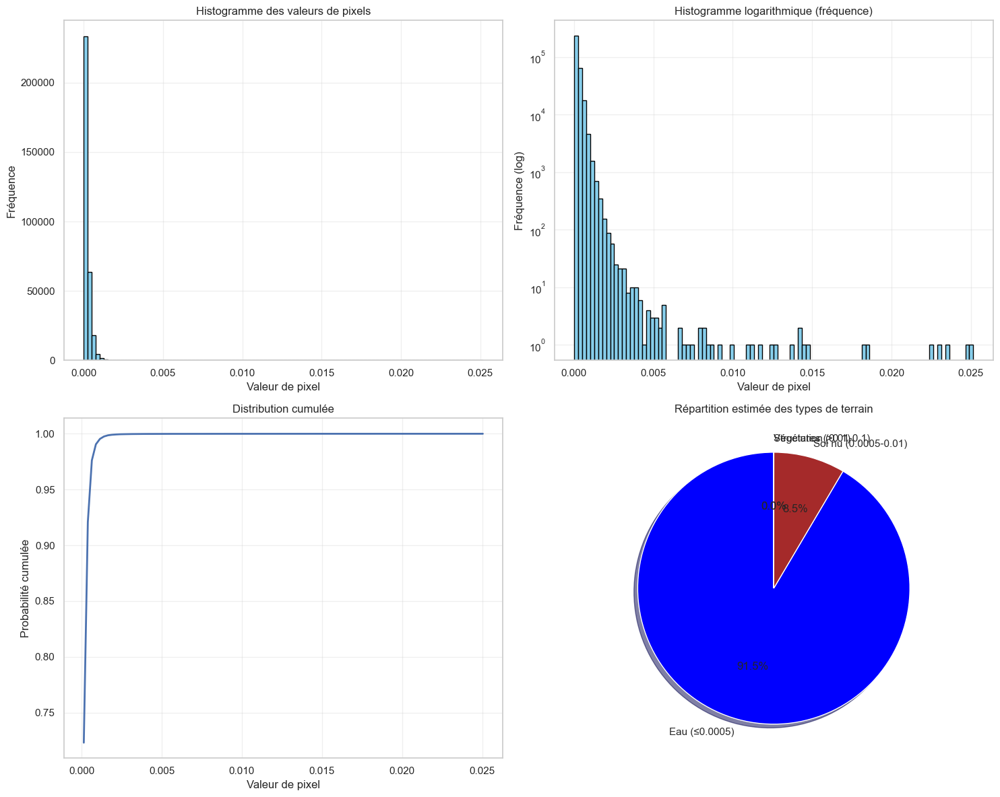


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 91.51% des pixels
  Moyenne: 0.00017838
  Écart-type: 0.00011059
Sol nu (0.0005-0.01): 8.49% des pixels
  Moyenne: 0.00074069
  Écart-type: 0.00036120
Végétation (0.01-0.1): 0.01% des pixels
  Moyenne: 0.01682565
  Écart-type: 0.00496321
Structures (>0.1): 0.00% des pixels
Taille originale VV: 526×613 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 526×613 pixels
Valeur minimale: 0.00002521
Valeur maximale: 0.25415874
Valeur moyenne: 0.00087229
Écart-type: 0.00228288


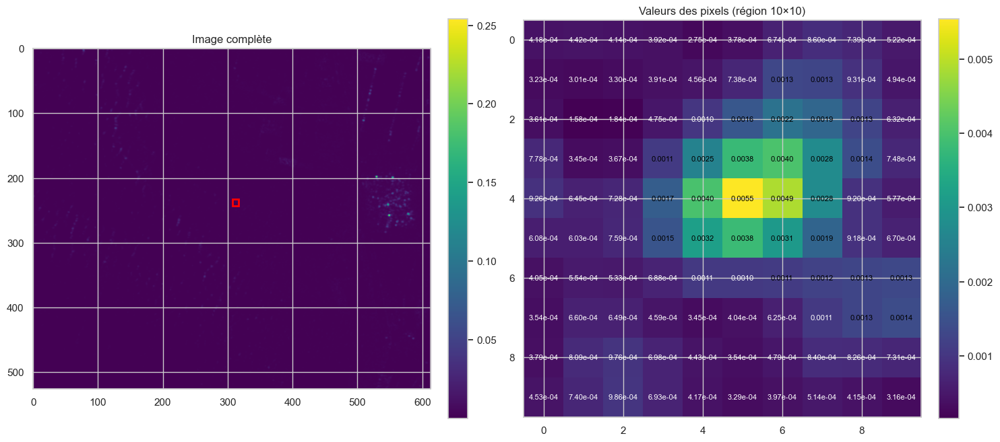

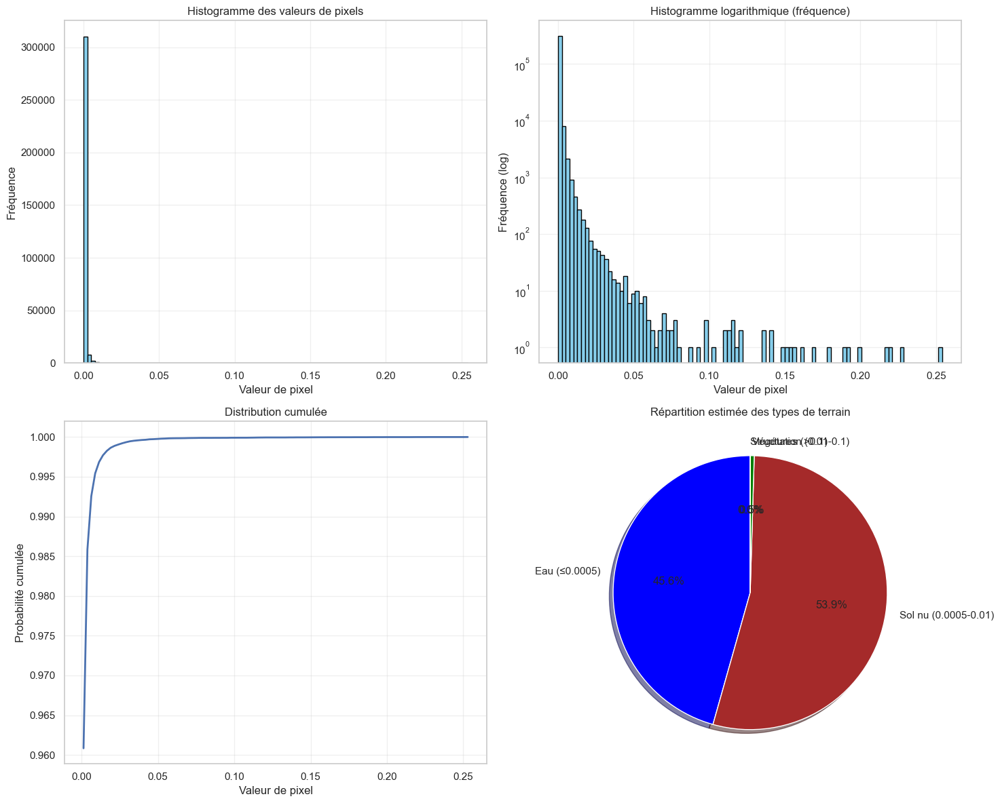


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 45.62% des pixels
  Moyenne: 0.00032554
  Écart-type: 0.00010547
Sol nu (0.0005-0.01): 53.91% des pixels
  Moyenne: 0.00115248
  Écart-type: 0.00104990
Végétation (0.01-0.1): 0.46% des pixels
  Moyenne: 0.01920344
  Écart-type: 0.01189967
Structures (>0.1): 0.01% des pixels
  Moyenne: 0.15291162
  Écart-type: 0.04047168
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\6\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\6\S1A_IW_GRDH_1SDV_20190307T194432_20190307T194457_026236_02EE37_2A1B_corrected_VV.tif
Taille originale VH: 516×543 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×543 pixels
Valeur minimale: 0.00000622
Valeur maximale: 0.00037616
Valeur moyenne: 0.00008280
Écart-type: 0.00003171


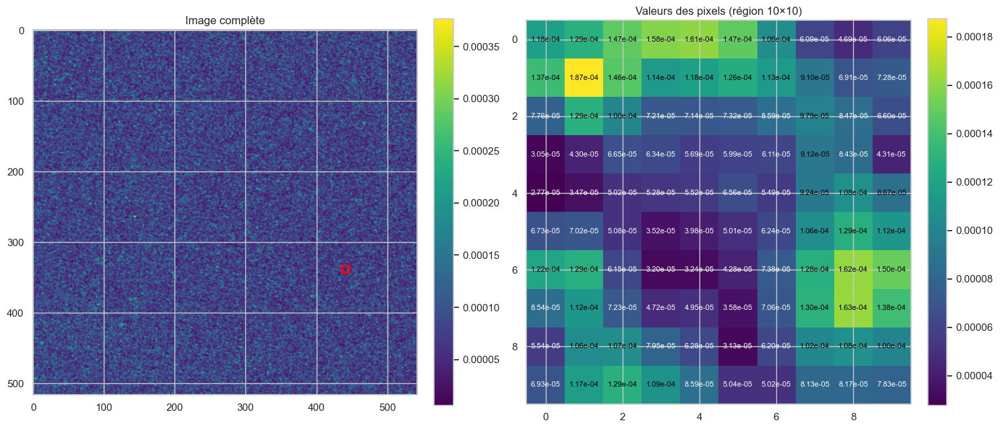

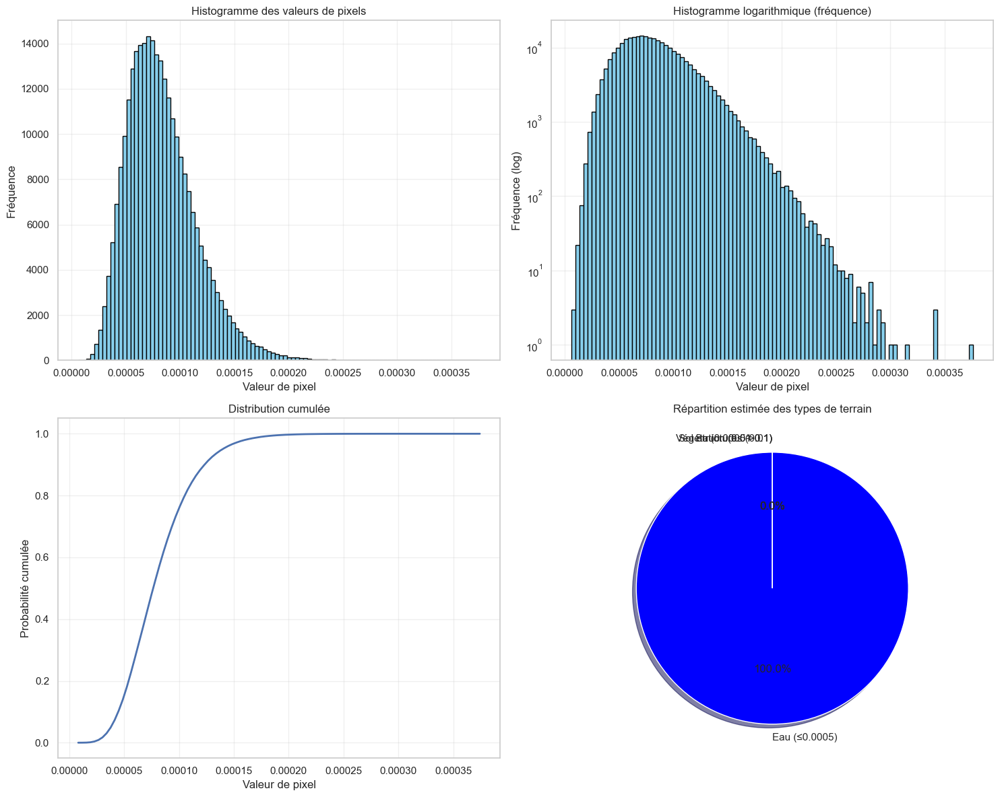


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00008280
  Écart-type: 0.00003171
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 516×543 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×543 pixels
Valeur minimale: 0.00001202
Valeur maximale: 0.00087114
Valeur moyenne: 0.00015491
Écart-type: 0.00007730


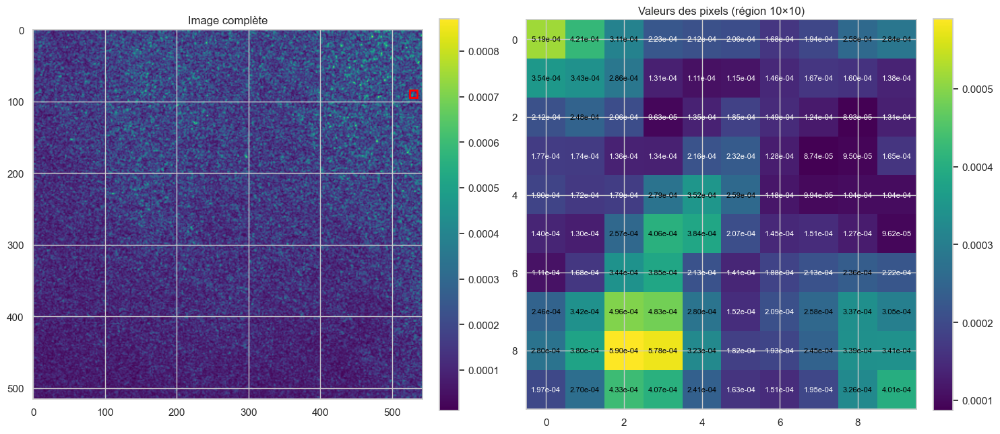

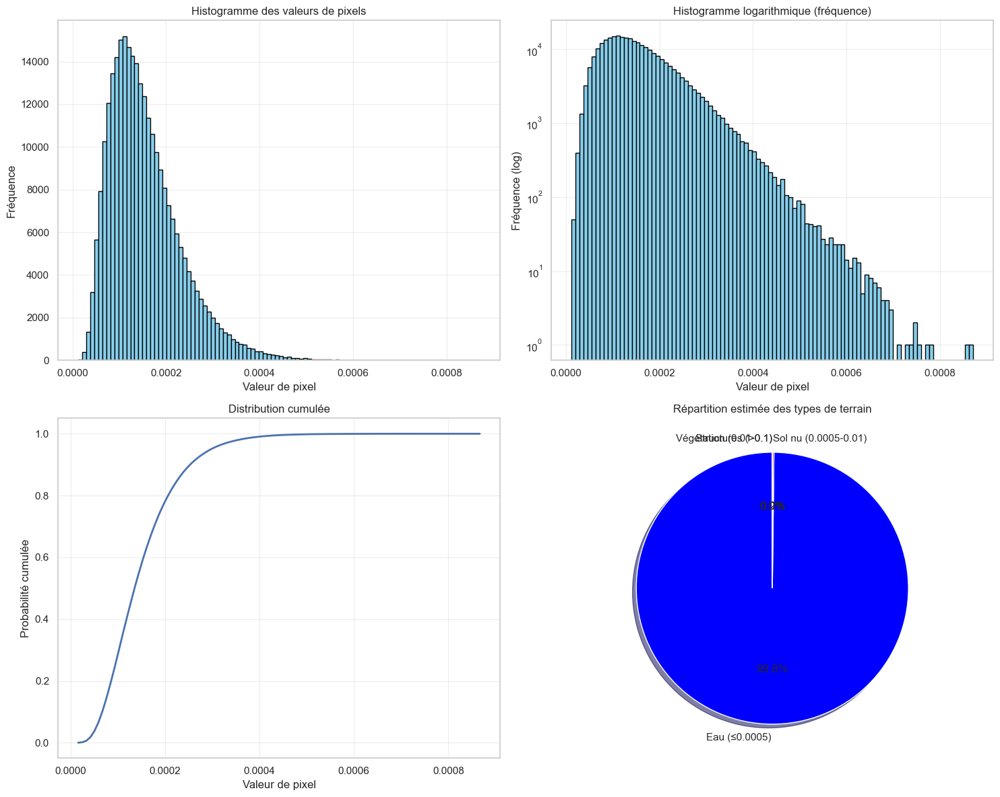


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 99.82% des pixels
  Moyenne: 0.00015416
  Écart-type: 0.00007533
Sol nu (0.0005-0.01): 0.18% des pixels
  Moyenne: 0.00056048
  Écart-type: 0.00005599
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0124\S1B_IW_GRDH_1SDV_20181231T031815_20181231T031840_014280_01A906_F242_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0124\S1B_IW_GRDH_1SDV_20181231T031815_20181231T031840_014280_01A906_F242_corrected_VV.tif
Taille originale VH: 518×572 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 518×572 pixels
Valeur minimale: 0.00001740
Valeur maximale: 0.16635965
Valeur moyenne: 0.00051920
Écart-type: 0.00088990


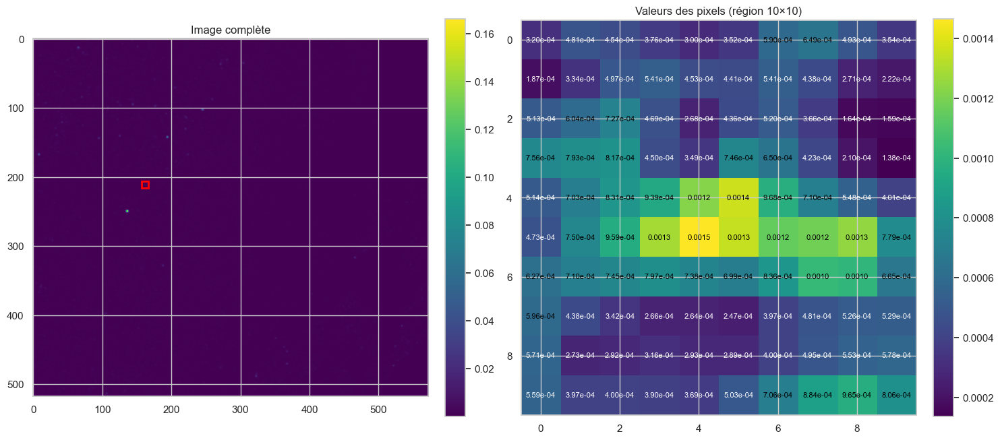

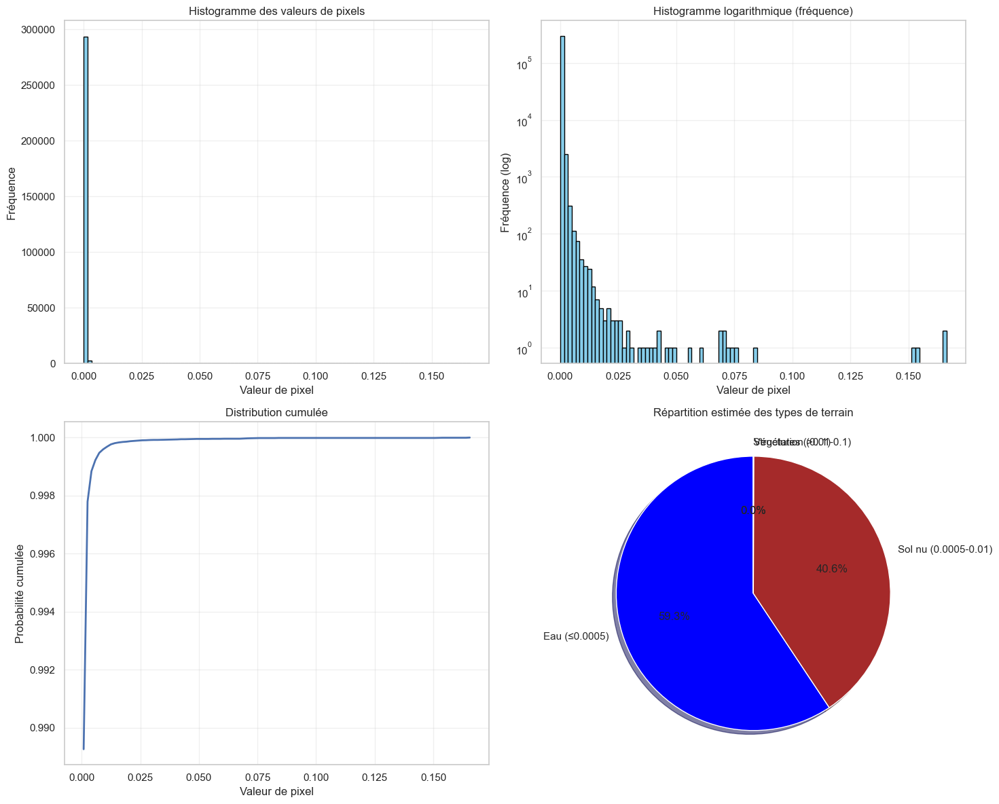


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 59.34% des pixels
  Moyenne: 0.00030463
  Écart-type: 0.00011421
Sol nu (0.0005-0.01): 40.62% des pixels
  Moyenne: 0.00080645
  Écart-type: 0.00043943
Végétation (0.01-0.1): 0.04% des pixels
  Moyenne: 0.02220244
  Écart-type: 0.01732144
Structures (>0.1): 0.00% des pixels
  Moyenne: 0.15987107
  Écart-type: 0.00642626
Taille originale VV: 518×572 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 518×572 pixels
Valeur minimale: 0.00003203
Valeur maximale: 1.62023747
Valeur moyenne: 0.00207804
Écart-type: 0.01032047


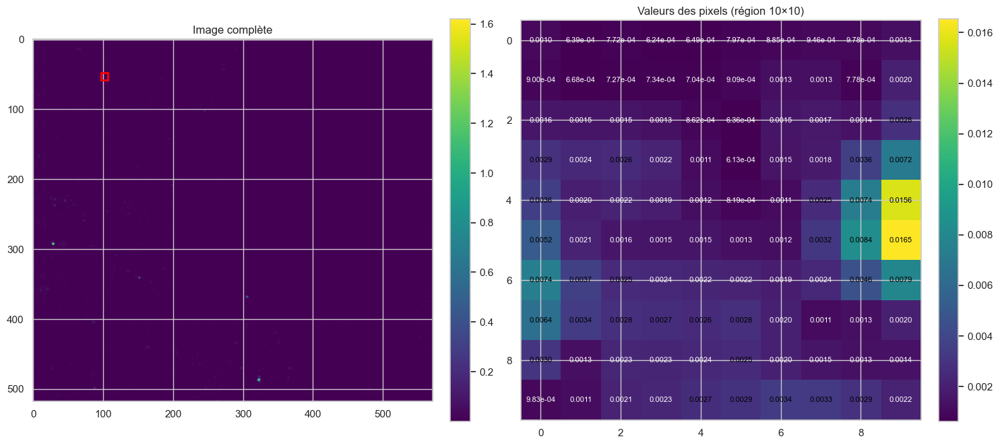

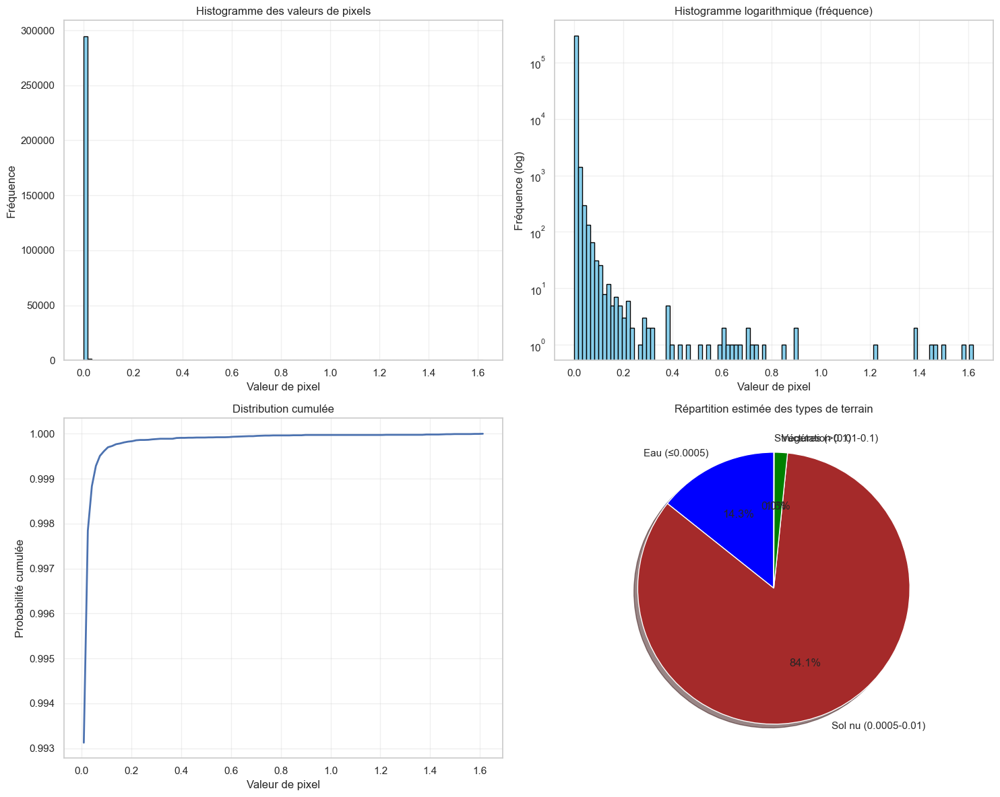


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 14.29% des pixels
  Moyenne: 0.00034605
  Écart-type: 0.00010169
Sol nu (0.0005-0.01): 84.09% des pixels
  Moyenne: 0.00188827
  Écart-type: 0.00148130
Végétation (0.01-0.1): 1.58% des pixels
  Moyenne: 0.01960788
  Écart-type: 0.01343107
Structures (>0.1): 0.04% des pixels
  Moyenne: 0.35667226
  Écart-type: 0.36959791
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\66\S1B_IW_GRDH_1SDV_20190315T024546_20190315T024609_015359_01CC22_8A5B_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\66\S1B_IW_GRDH_1SDV_20190315T024546_20190315T024609_015359_01CC22_8A5B_corrected_VV.tif
Taille originale VH: 526×614 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 526×614 pixels
Valeur minimale: 0.00000853
Valeur maximale: 0.01936690
Valeur moyenne: 0.00035415
Écart-type: 0.00027328


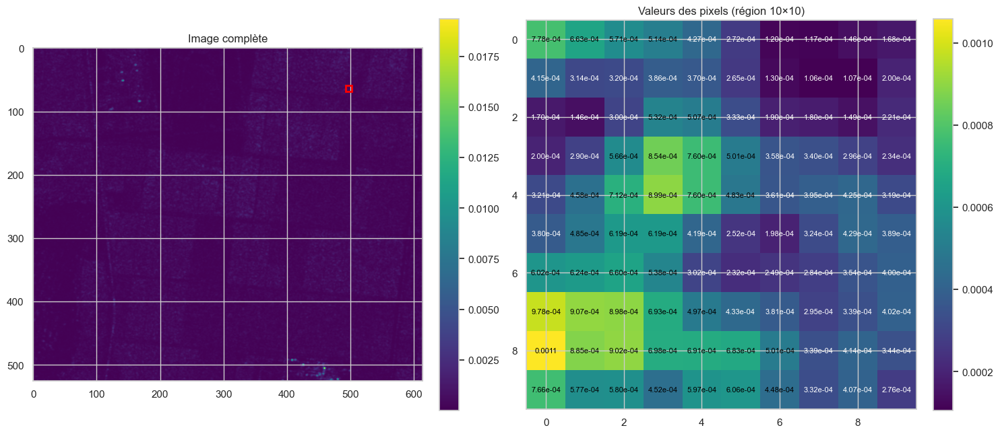

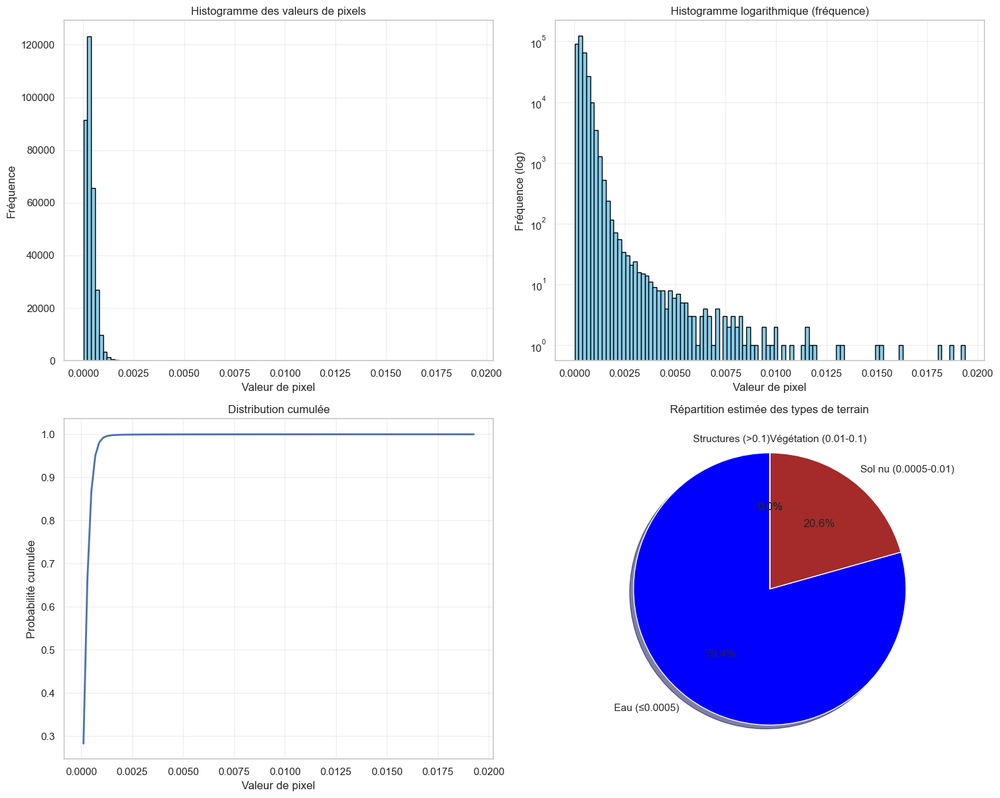


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 79.36% des pixels
  Moyenne: 0.00026008
  Écart-type: 0.00011915
Sol nu (0.0005-0.01): 20.63% des pixels
  Moyenne: 0.00071299
  Écart-type: 0.00031854
Végétation (0.01-0.1): 0.00% des pixels
  Moyenne: 0.01387693
  Écart-type: 0.00293826
Structures (>0.1): 0.00% des pixels
Taille originale VV: 526×614 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 526×614 pixels
Valeur minimale: 0.00005079
Valeur maximale: 1.35706484
Valeur moyenne: 0.00111754
Écart-type: 0.00628781


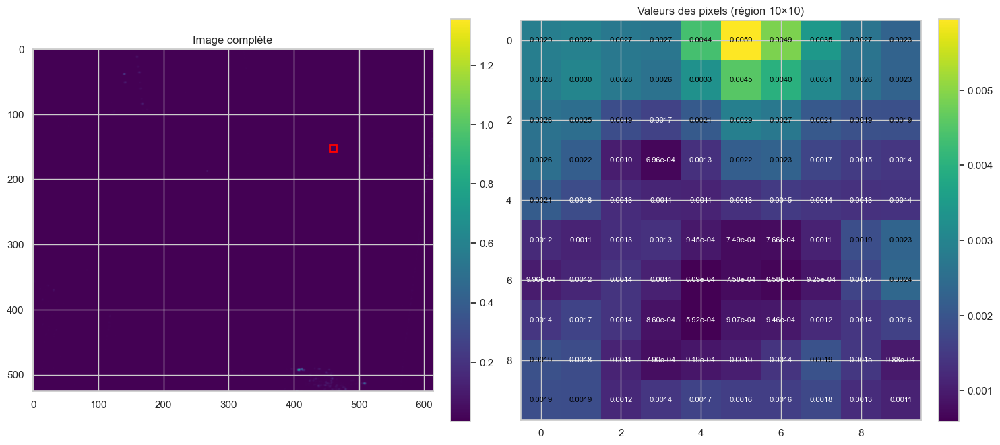

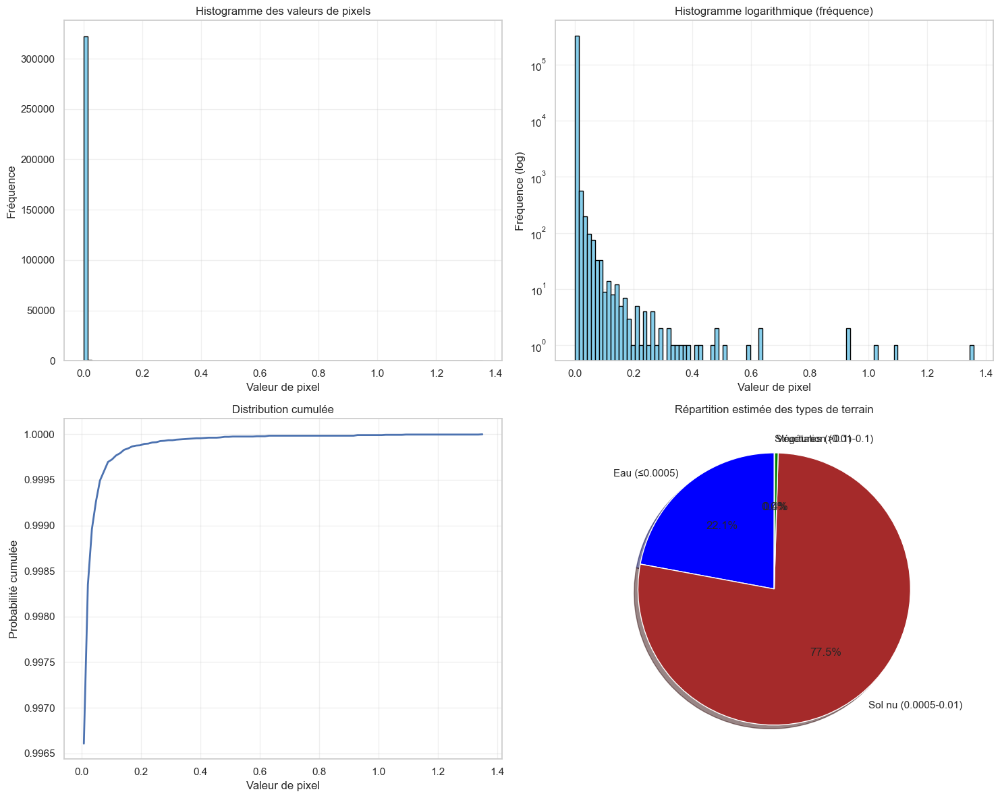


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 22.07% des pixels
  Moyenne: 0.00036642
  Écart-type: 0.00009346
Sol nu (0.0005-0.01): 77.47% des pixels
  Moyenne: 0.00109382
  Écart-type: 0.00073731
Végétation (0.01-0.1): 0.43% des pixels
  Moyenne: 0.02646004
  Écart-type: 0.01884529
Structures (>0.1): 0.03% des pixels
  Moyenne: 0.25969550
  Écart-type: 0.22883645
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0160\S1A_IW_GRDH_1SDV_20190218T030815_20190218T030840_025978_02E4EB_4380_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0160\S1A_IW_GRDH_1SDV_20190218T030815_20190218T030840_025978_02E4EB_4380_corrected_VV.tif
Taille originale VH: 526×549 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 526×549 pixels
Valeur minimale: 0.00003152
Valeur maximale: 0.00378148
Valeur moyenne: 0.00069822
Écart-type: 0.00032804


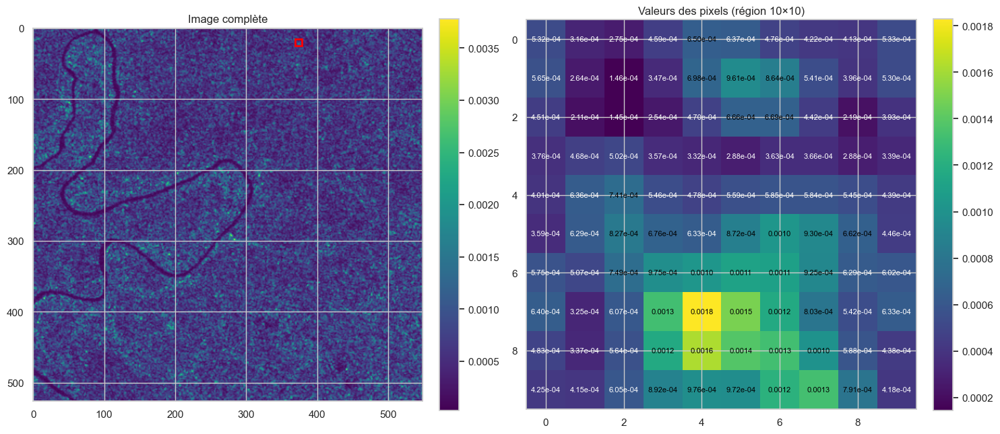

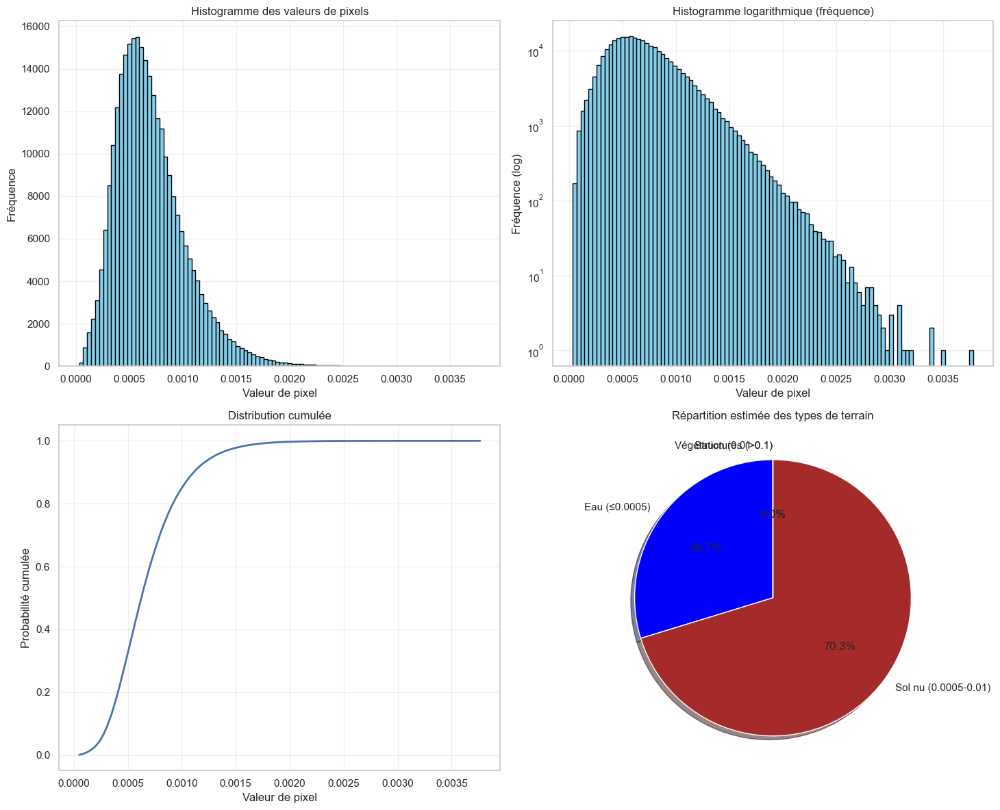


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 29.74% des pixels
  Moyenne: 0.00036662
  Écart-type: 0.00009744
Sol nu (0.0005-0.01): 70.26% des pixels
  Moyenne: 0.00083858
  Écart-type: 0.00028792
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 526×549 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 526×549 pixels
Valeur minimale: 0.00003417
Valeur maximale: 0.00756774
Valeur moyenne: 0.00086480
Écart-type: 0.00056993


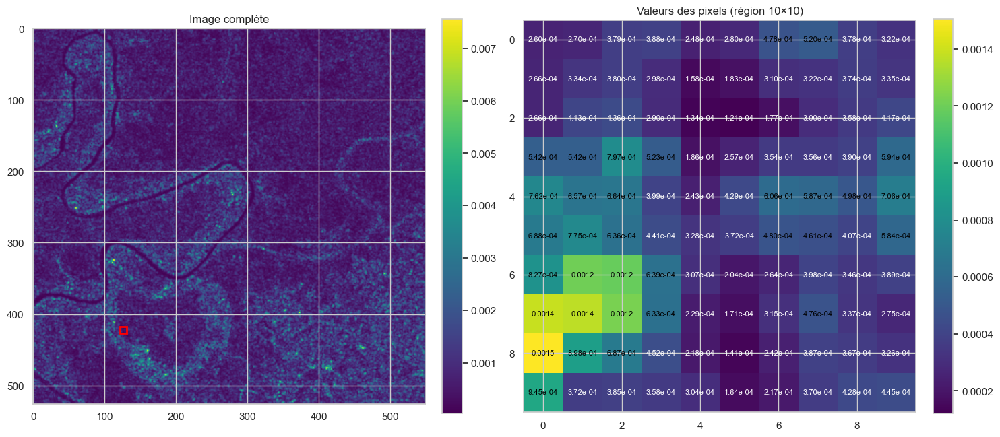

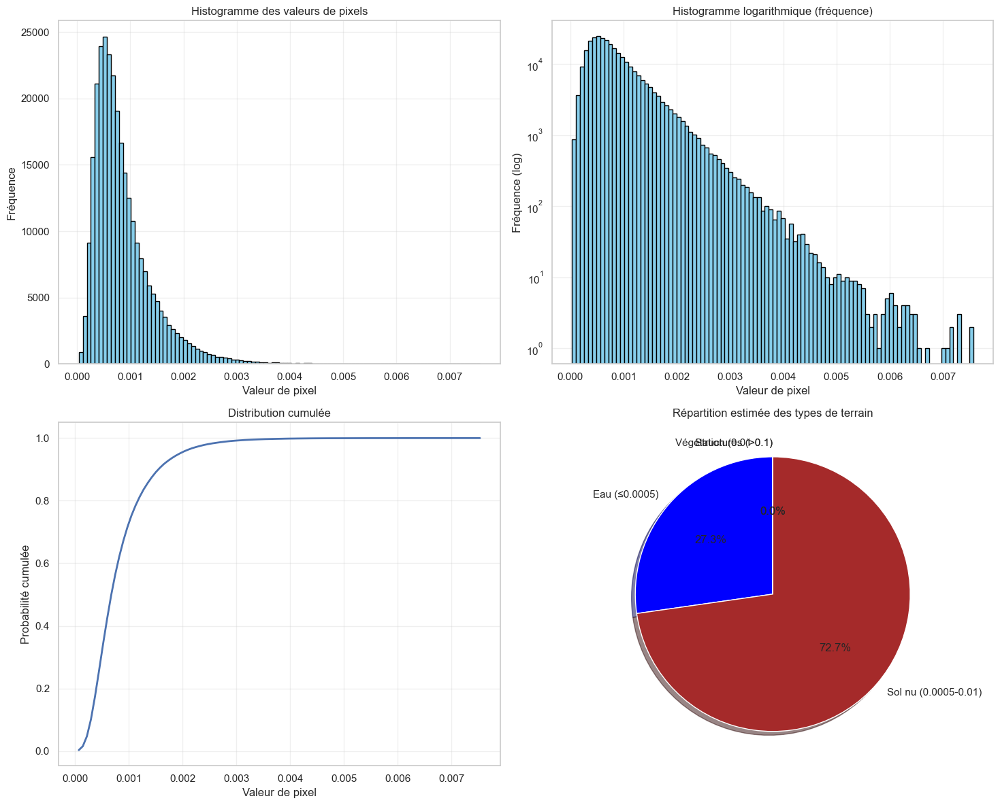


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 27.26% des pixels
  Moyenne: 0.00035874
  Écart-type: 0.00009717
Sol nu (0.0005-0.01): 72.74% des pixels
  Moyenne: 0.00105445
  Écart-type: 0.00055774
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0122\S1A_IW_GRDH_1SDV_20190117T162225_20190117T162250_025519_02D472_6DEF_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0122\S1A_IW_GRDH_1SDV_20190117T162225_20190117T162250_025519_02D472_6DEF_corrected_VV.tif
Taille originale VH: 516×571 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 516×571 pixels
Valeur minimale: 0.00002675
Valeur maximale: 0.09922004
Valeur moyenne: 0.00069774
Écart-type: 0.00136390


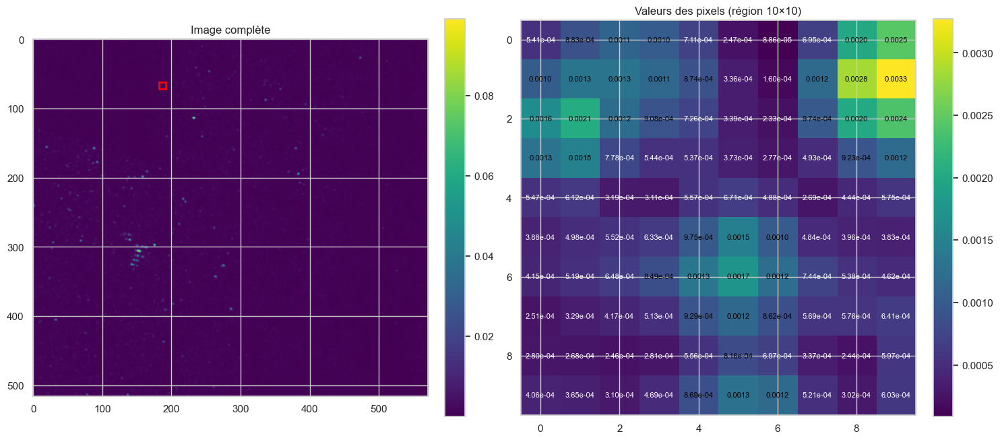

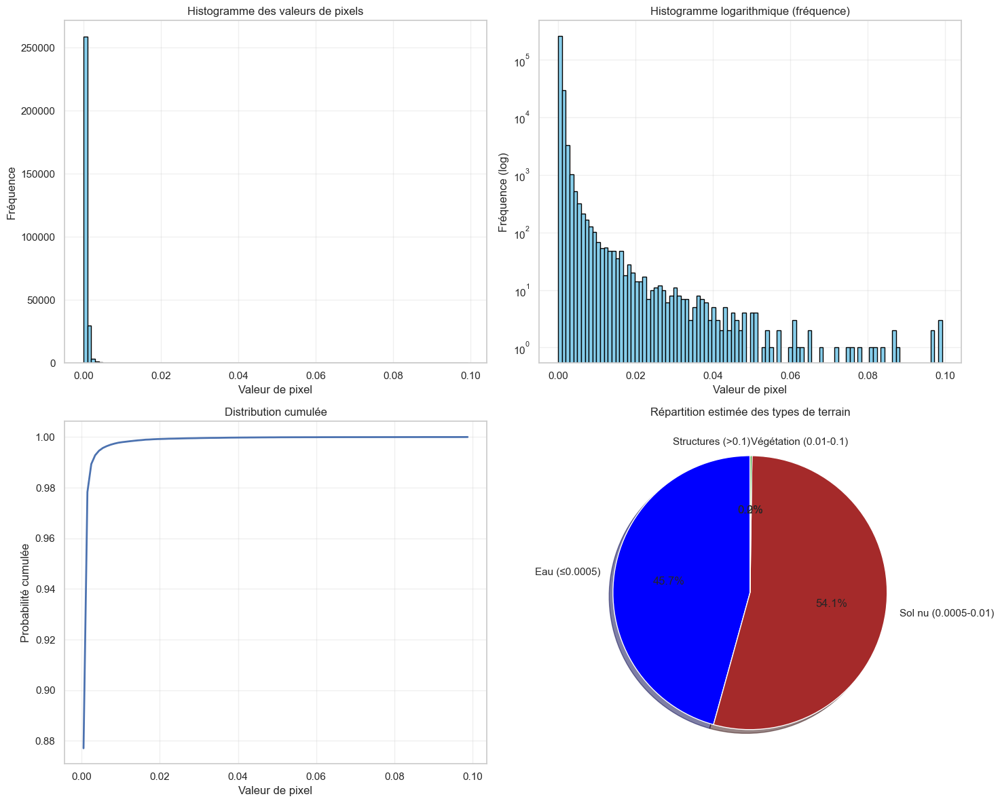


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 45.71% des pixels
  Moyenne: 0.00033911
  Écart-type: 0.00010210
Sol nu (0.0005-0.01): 54.07% des pixels
  Moyenne: 0.00091198
  Écart-type: 0.00066336
Végétation (0.01-0.1): 0.22% des pixels
  Moyenne: 0.02212436
  Écart-type: 0.01498773
Structures (>0.1): 0.00% des pixels
Taille originale VV: 516×571 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 516×571 pixels
Valeur minimale: 0.00003390
Valeur maximale: 0.24177767
Valeur moyenne: 0.00119759
Écart-type: 0.00255523


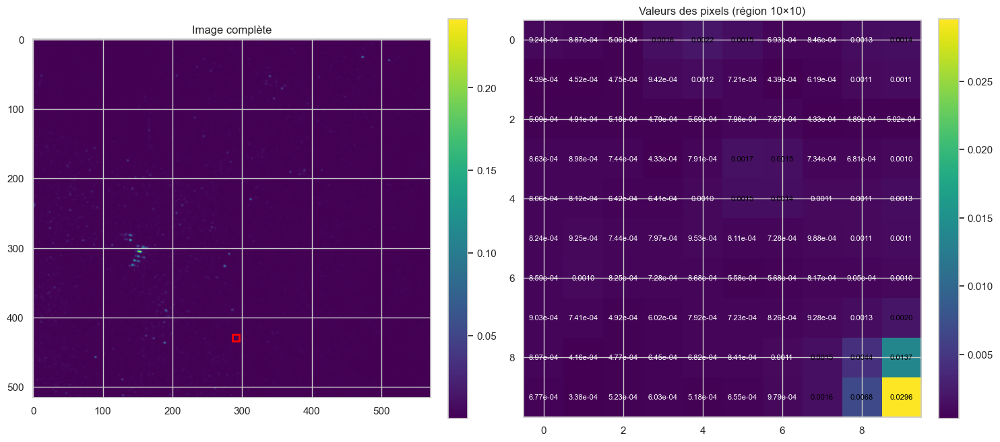

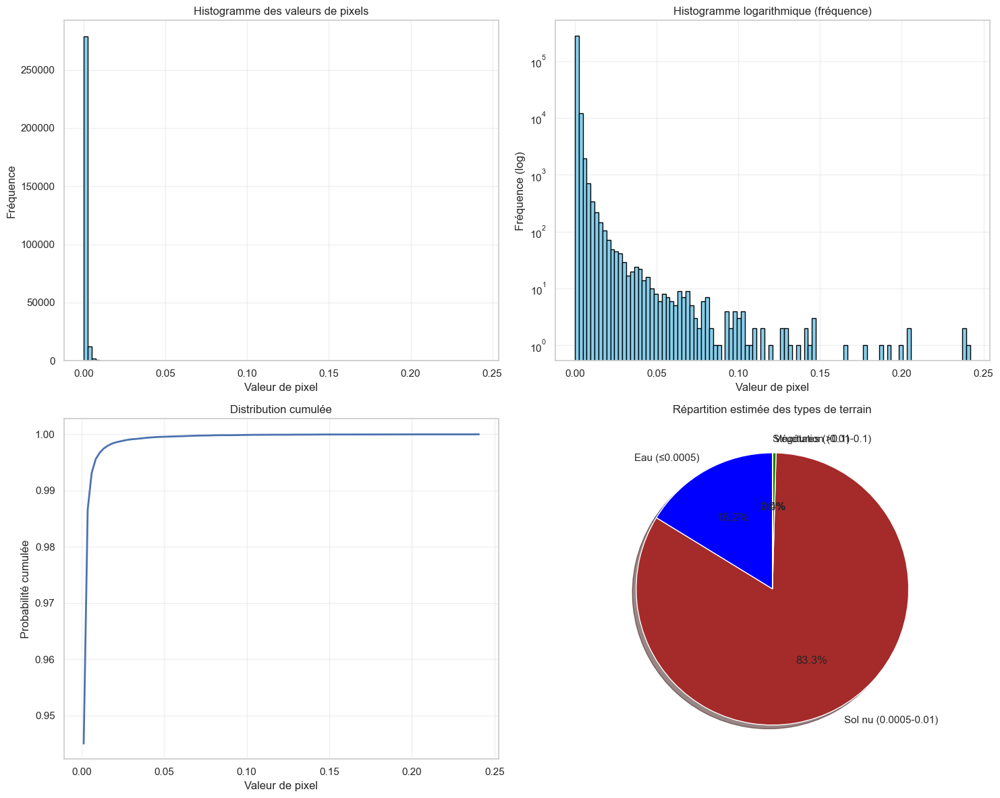


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 16.24% des pixels
  Moyenne: 0.00037022
  Écart-type: 0.00009383
Sol nu (0.0005-0.01): 83.34% des pixels
  Moyenne: 0.00123106
  Écart-type: 0.00087013
Végétation (0.01-0.1): 0.41% des pixels
  Moyenne: 0.02285299
  Écart-type: 0.01664413
Structures (>0.1): 0.01% des pixels
  Moyenne: 0.14422534
  Écart-type: 0.04234387
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\39\S1B_IW_GRDH_1SDV_20190203T032731_20190203T032756_014776_01B8F2_A952_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\39\S1B_IW_GRDH_1SDV_20190203T032731_20190203T032756_014776_01B8F2_A952_corrected_VV.tif
Taille originale VH: 517×513 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×513 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


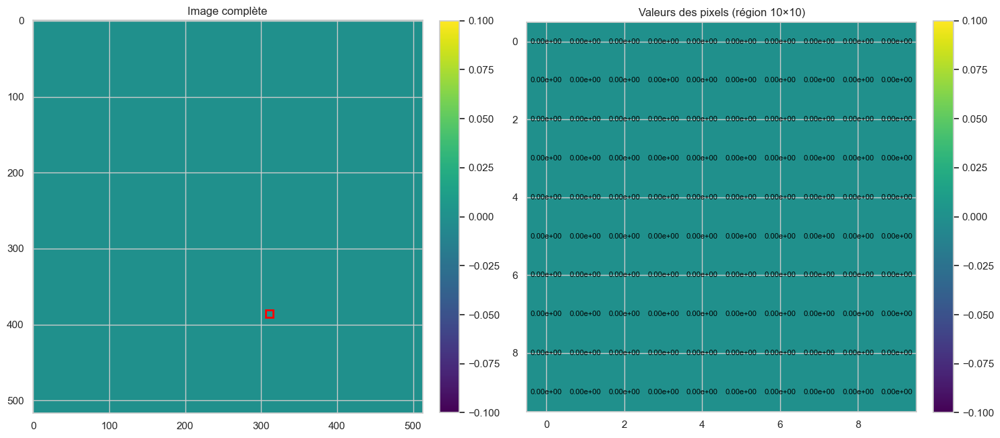

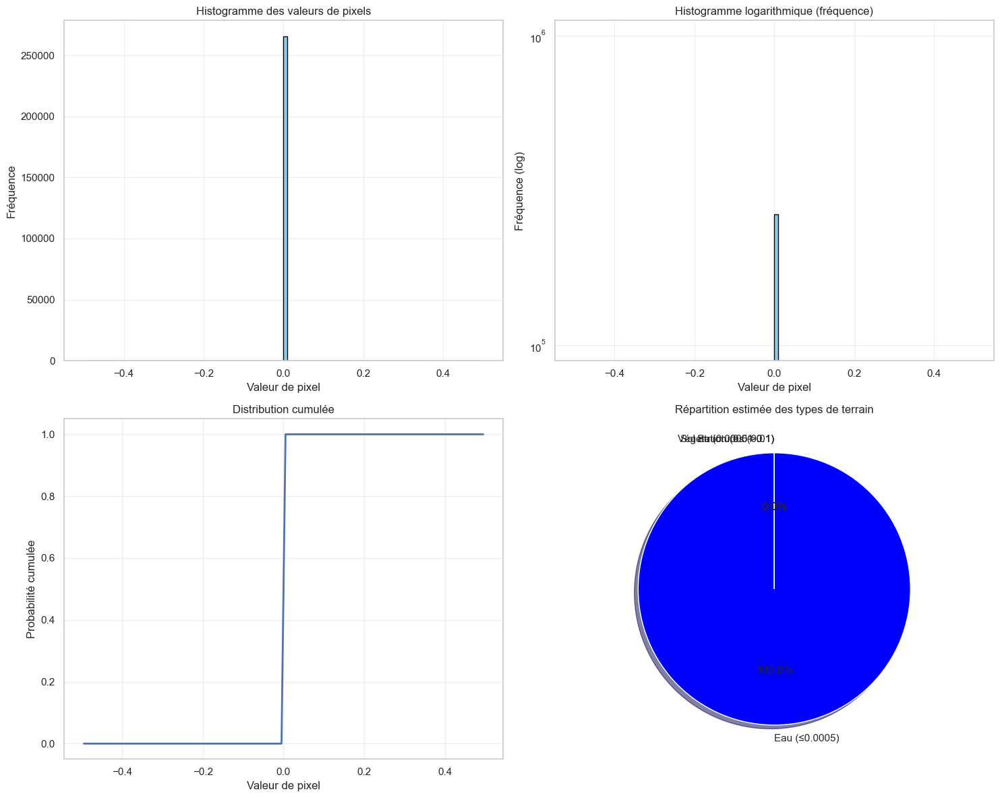


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00000000
  Écart-type: 0.00000000
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 517×513 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 517×513 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


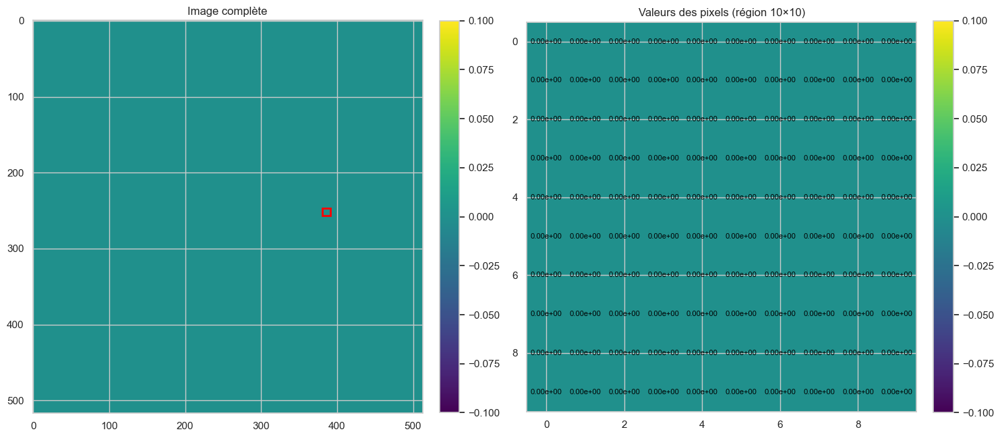

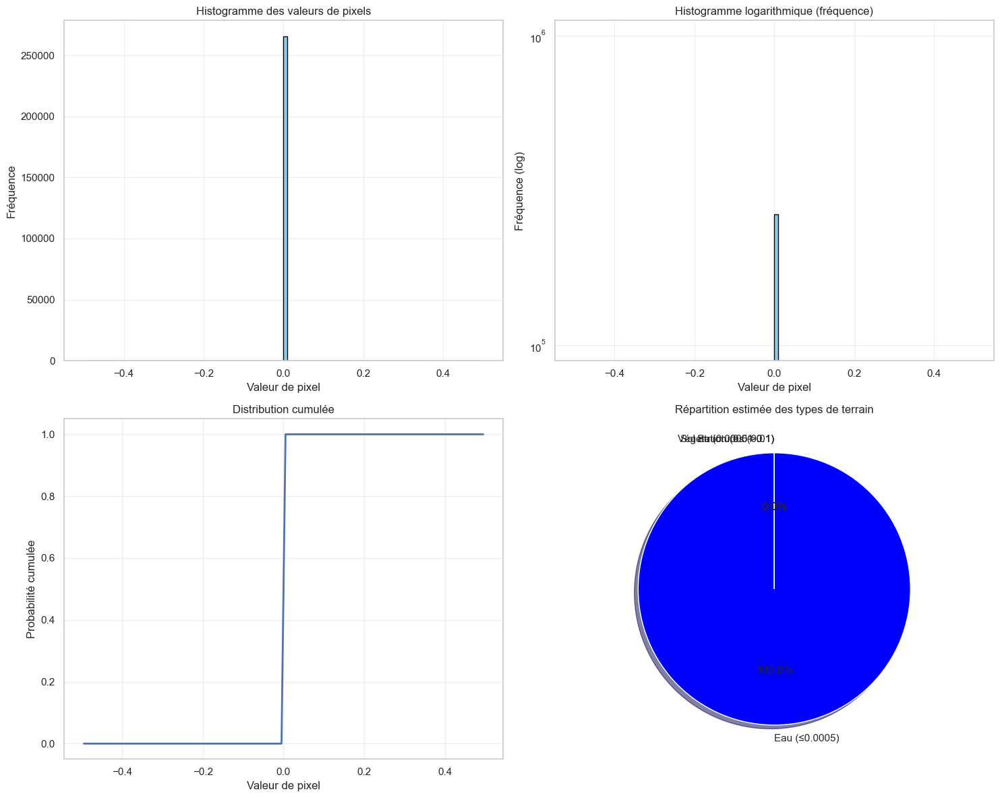


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 100.00% des pixels
  Moyenne: 0.00000000
  Écart-type: 0.00000000
Sol nu (0.0005-0.01): 0.00% des pixels
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\11\S1B_IW_GRDH_1SDV_20190401T030823_20190401T030856_015607_01D42A_6D09_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\11\S1B_IW_GRDH_1SDV_20190401T030823_20190401T030856_015607_01D42A_6D09_corrected_VV.tif
Taille originale VH: 522×550 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 522×550 pixels
Valeur minimale: 0.00003418
Valeur maximale: 0.00331723
Valeur moyenne: 0.00055328
Écart-type: 0.00028415


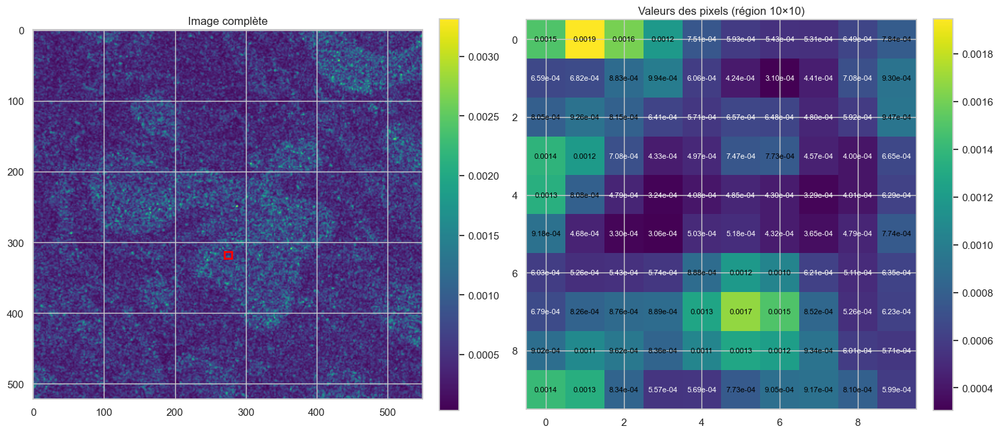

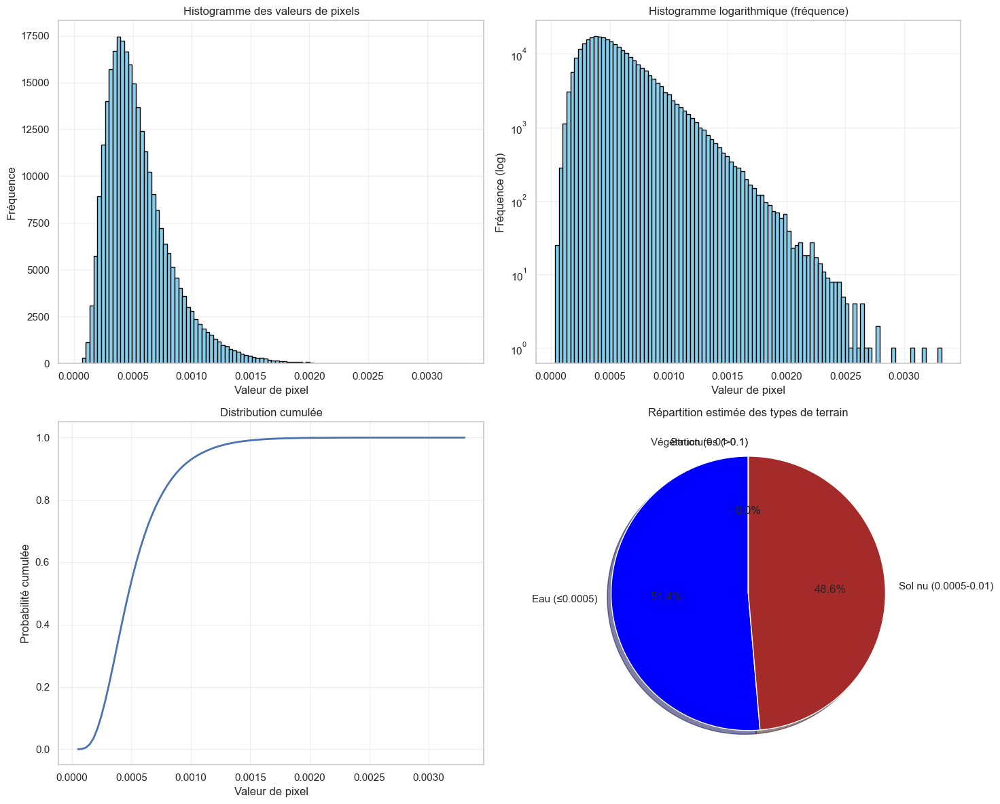


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 51.37% des pixels
  Moyenne: 0.00034799
  Écart-type: 0.00009376
Sol nu (0.0005-0.01): 48.63% des pixels
  Moyenne: 0.00077017
  Écart-type: 0.00025532
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
Taille originale VV: 522×550 pixels

Analyse des pixels de l'image VV:
Taille de l'image: 522×550 pixels
Valeur minimale: 0.00006930
Valeur maximale: 0.00586310
Valeur moyenne: 0.00094138
Écart-type: 0.00049275


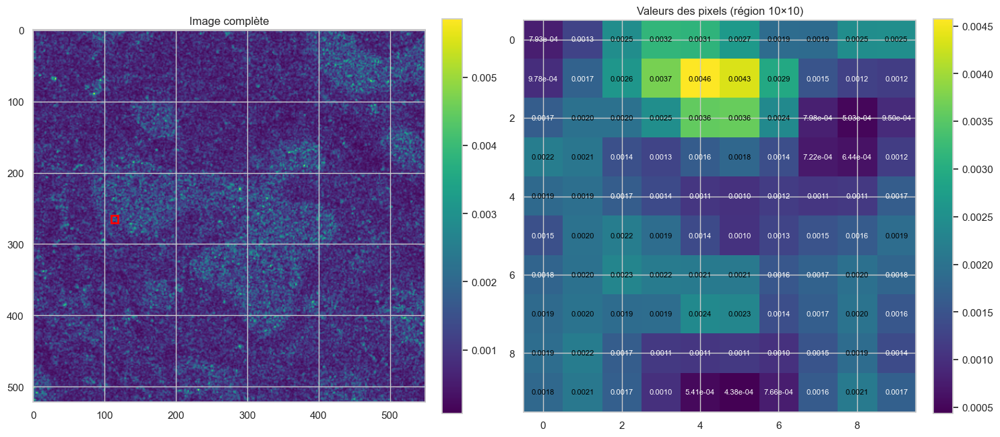

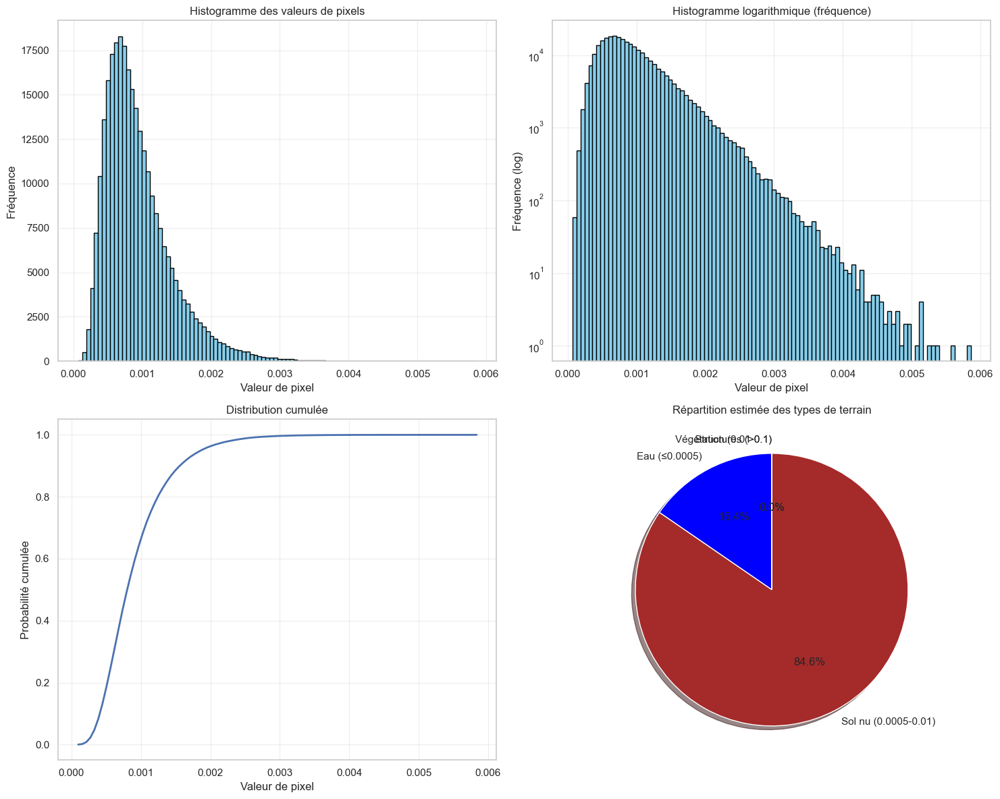


Statistiques par catégorie estimée de terrain:
Eau (≤0.0005): 15.41% des pixels
  Moyenne: 0.00039205
  Écart-type: 0.00007888
Sol nu (0.0005-0.01): 84.59% des pixels
  Moyenne: 0.00104146
  Écart-type: 0.00047001
Végétation (0.01-0.1): 0.00% des pixels
Structures (>0.1): 0.00% des pixels
VH path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0220\S1A_IW_GRDH_1SDV_20190313T161522_20190313T161557_026321_02F156_A8A9_corrected_VH.tif
VV path: C:/Users/mokht/Desktop/PDS/flood_dataset\sen12flood\0220\S1A_IW_GRDH_1SDV_20190313T161522_20190313T161557_026321_02F156_A8A9_corrected_VV.tif
Taille originale VH: 517×546 pixels

Analyse des pixels de l'image VH:
Taille de l'image: 517×546 pixels
Valeur minimale: 0.00000000
Valeur maximale: 0.00000000
Valeur moyenne: 0.00000000
Écart-type: 0.00000000


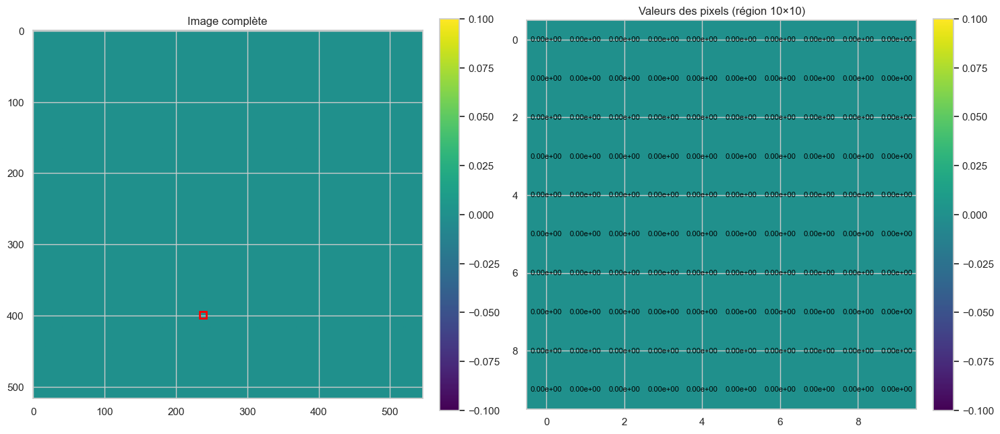

KeyboardInterrupt: 

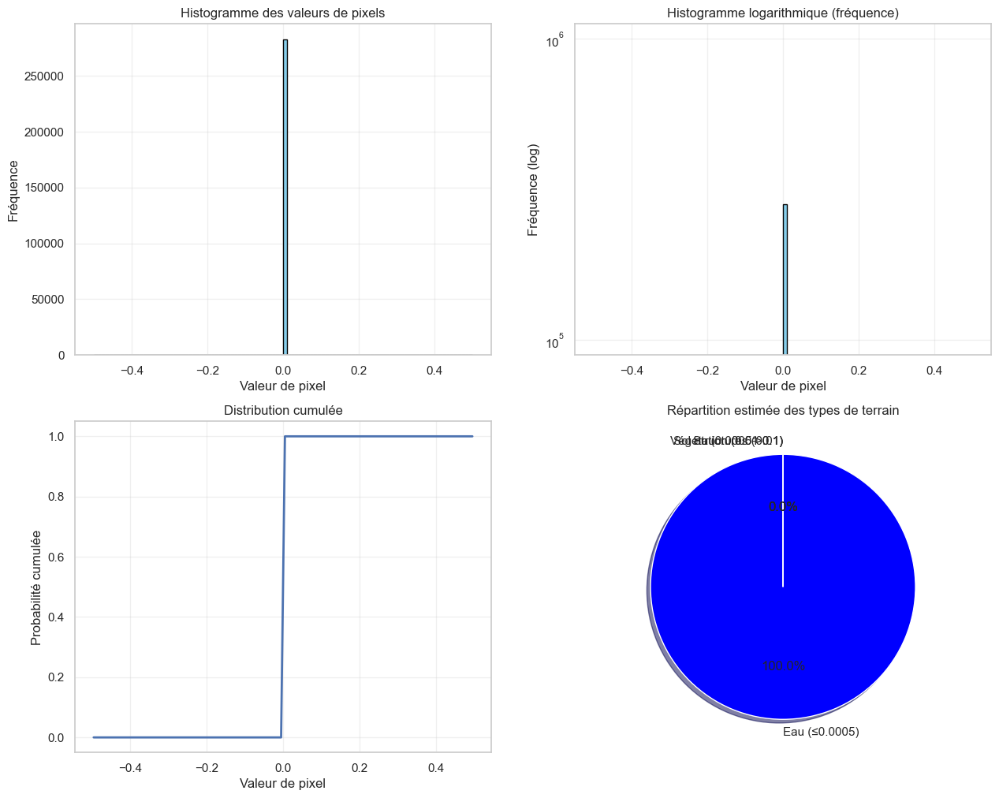

In [69]:
if len(dataset.image_paths) > 0:
    print(f"datasets images , {len(dataset.image_paths)}")
    for i in range(1000):
        vh_path, vv_path = dataset.image_paths[i]
        print("VH path:", vh_path)
        print("VV path:", vv_path)
        # Taille du canal VH
        height_vh, width_vh = obtenir_taille_originale(vh_path)
        print(f"Taille originale VH: {height_vh}×{width_vh} pixels")
        print("\nAnalyse des pixels de l'image VH:")
        analyser_pixels_sar(vh_path, scaling_value=50.0)

        # Comparer plusieurs méthodes de prétraitement avancées

        # Taille du canal VV
        height_vv, width_vv = obtenir_taille_originale(vv_path)
        print(f"Taille originale VV: {height_vv}×{width_vv} pixels")
        print("\nAnalyse des pixels de l'image VV:")
        analyser_pixels_sar(vv_path, scaling_value=100.0)


In [ ]:
def pixel_image(chemin_image):
    """
    Lit et retourne une image raster
    
    Remarque : 
    Eau: typiquement 0.0001 à 0.0005
    Sol nu: 0.001 à 0.01
    Végétation: 0.01 à 0.1
    Bâtiments/structures: >0.1
    """
    with rasterio.open(chemin_image) as src:
        # Lire la première bande (indice 1)
        image = src.read(1)
    return image 

# Obtenir les chemins des images VH et VV
print("dataset", len(dataset.image_paths))
vh_path, vv_path = dataset.image_paths[0]

# Lire l'image VH
image_vh = pixel_image(vh_path)
#afficher l'image VH
# plt.figure(figsize=(10, 8))
# plt.imshow(image_vh, cmap='viridis')
# plt.colorbar(label='Valeur de rétrodiffusion')
# plt.title('Image VH')
# plt.show()

# image_vv = pixel_image(vv_path)
# plt.figure(figsize=(10, 8))
# plt.imshow(image_vv, cmap='viridis')
# plt.colorbar(label='Valeur de rétrodiffusion')
# plt.title('Image VV')
# plt.show()

#plt.imshow viridis donne cet aspect bleuatre à l'image ... 
print("pixel", image_vh[100][2])

dataset 3331
pixel 0.019983334


In [ ]:
# Visualize some sample images from each class
def visualize_samples(df, num_samples=5):
    plt.figure(figsize=(15, 10))
    for i, label in enumerate(df['label'].unique()):
        sample_images = df[df['label'] == label].sample(num_samples)
        for j, row in sample_images.iterrows():
            img = plt.imread(row['image_path'])  # Assuming 'image_path' column contains the paths
            plt.subplot(len(df['label'].unique()), num_samples, i * num_samples + j + 1)
            plt.imshow(img)
            plt.title(f'Class: {label}')
            plt.axis('off')
    plt.tight_layout()
    plt.show()

# Call the function to visualize samples
visualize_samples(df, num_samples=3)

In [ ]:
# Analyze image dimensions
image_sizes = []
for img_path in df['image_path']:
    img = plt.imread(img_path)
    image_sizes.append(img.shape)

image_sizes = np.array(image_sizes)
height, width = image_sizes[:, 0], image_sizes[:, 1]

# Plot the distribution of image dimensions
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.histplot(height, bins=30, kde=True)
plt.title('Height Distribution')
plt.subplot(1, 2, 2)
sns.histplot(width, bins=30, kde=True)
plt.title('Width Distribution')
plt.show()

## Conclusion

Citer les étapes du prétraitement qui ont été concluantes et ce qu'il y a retenir sur le dataset ? 


Type de surface	Valeur en dB 	Valeur linéaire	Après scaling VH (÷50)	Après scaling VV (÷100)
Eau calme	-25 à -20 dB	0.003 à 0.01	0.00006 à 0.0002	0.00003 à 0.0001
Eau agitée	-20 à -15 dB	0.01 à 0.03	0.0002 à 0.0006	0.0001 à 0.0003
Sol nu humide	-15 à -10 dB	0.03 à 0.10	0.0006 à 0.002	0.0003 à 0.001²
Sol nu sec	-10 à -7 dB	0.10 à 0.20	0.002 à 0.004	0.001 à 0.002
Cultures basses	-15 à -8 dB	0.03 à 0.16	0.0006 à 0.0032	0.0003 à 0.0016
Prairies/Herbes	-10 à -5 dB	0.10 à 0.32	0.002 à 0.0064	0.001 à 0.0032
Forêts	-8 à 0 dB	0.16 à 1.00	0.0032 à 0.02	0.0016 à 0.01
Zones urbaines	-5 à +5 dB	0.32 à 3.16	0.0064 à 0.0632	0.0032 à 0.0316
Bâtiments (fort retour)	+5 à +15 dB	3.16 à 31.62	0.0632 à 0.6324	0.0316 à 0.3162
Réflecteurs métalliques	+10 à +25 dB	10.00 à 316.23	0.20 à 6.32	0.10 à 3.16